**NOTEBOOK FOR SPLITTING DATA OF ELECTRO L2, TRAINING AND TESTING SMP MANet MODEL ON ELECTRO L2 PATCHES**

In [59]:
import h5py
import pvlib
import math
import glob
import torch
import torch.nn.functional as F
import torchvision.transforms.functional as TF
import torchmetrics
from torch.optim.lr_scheduler import CosineAnnealingLR
from pathlib import Path
from torch.utils.data import Dataset, DataLoader, sampler
from torchvision import transforms
from skimage.color import rgb2hsv
from skimage import io
import pandas as pd
from tqdm import tqdm
from timeit import default_timer as timer 
from PIL import Image
import numpy as np
from patchify import patchify, unpatchify
import gc
import os
import warnings
import tifffile as tff
import matplotlib.pyplot as plt
from torch import nn
from IPython.display import clear_output
from sklearn.metrics import jaccard_score
from torcheval.metrics.functional import multiclass_f1_score
from copy import deepcopy
import albumentations as A
import random
from skimage.transform import resize as interp_resize
import segmentation_models_pytorch as smp
from segmentation_models_pytorch import utils
from segmentation_models_pytorch.encoders import get_preprocessing_fn
import torch.optim as optim
from itertools import chain
from time import sleep
import requests
%matplotlib inline
warnings.filterwarnings("ignore")
torch.version.cuda,np.version.version

('11.7', '1.23.5')

In [60]:
import kornia as K
from kornia.augmentation import (
    CenterCrop,
    RandomAffine,
    RandomCrop,
    RandomElasticTransform,
    RandomHorizontalFlip,
    RandomPerspective,
    RandomResizedCrop,
    RandomRotation,
    RandomThinPlateSpline,
    RandomVerticalFlip,
)

In [61]:
np.set_printoptions(threshold=1e7)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [62]:
import pyproj
from pyproj import Transformer
from rasterio.warp import reproject, transform_bounds
import rasterio
import netCDF4 as nc

In [63]:
def seed_everything(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
seed_everything(seed=42)

In [64]:
def batch_to_img(xb, idx=0):
    img = np.array(xb.squeeze(0))
    return np.array(img.transpose((1,2,0))*255)
def transpose_patch(patch):
    tr = np.array(patch).astype(np.uint8).transpose((2,0,1))
    return tr
def predb_to_mask(predb,idx=0):
    p = torch.functional.F.softmax(predb.squeeze(0), 0)
    return p.argmax(0).cpu()
def inverse_normalize(tensor,mean,std,num_shannels =5):
    tensor = tensor.detach().cpu().numpy()
    # unnormalize the RGB channels
    for i in range(num_shannels):
        tensor[i] = (tensor[i] * std[i]) + mean[i]
    # clip values to [0, 1] range
    tensor = np.clip(tensor, 0, 1)
    # convert back to uint8
    tensor = (tensor * 255).astype(np.uint8)
    return tensor
def open_sample_as_pil_no_norm(datacube):
    inversed_rgb = (datacube[0:3])
    rgb = np.dstack((inversed_rgb[2,:,:],inversed_rgb[1,:,:],inversed_rgb[0,:,:]))*255
    return rgb.astype('uint8')
def open_DEM(datacube):
    dem_arr = datacube[5]#*255
    return dem_arr.numpy()#.astype('uint8')
def open_mask_as_pil(seglabel):
    mask = (seglabel.numpy())
    return mask

**SPLITTING ELECTRO L2 STACK OF RGB and 6 BT CHANNELS TO PATCHES AND SAVE THEM FOR DATASET**

In [7]:
def split_LONLATDEM_stack_4km(stack, patch_size,dir_name):
    print('init stack shape =', stack.shape)
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    if stack.shape[0]%patch_size!=0:
        print('cut margins to split 224*224 patches')
        stack = stack[48:-48,48:-48,:]
        print('stack shape =', stack.shape)
    n_patches_h = stack.shape[0] // patch_size
    n_patches_w = stack.shape[1] // patch_size
    print('n_patches_h,n_patches_w',n_patches_h,n_patches_w)
    # Check if the image can be evenly divided into patches
    assert stack.shape[0] == n_patches_h * patch_size, f"Image height {stack.shape} is not divisible by patch height {patch_size}"
    assert stack.shape[1] == n_patches_w * patch_size, f"Image width {stack.shape} is not divisible by patch width {patch_size}"
    # Split the image into non-overlapping patches
    patches,nonempty_idxs = [],[]
    for i in tqdm(range(n_patches_h)):
        for j in range(n_patches_w):
            patch = stack[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size]
            patch_name= dir_name+'patch_'+str(n_patches_w*i+j)+'.tif'
            tff.imwrite(patch_name, patch)
    print('############## geoinfo in 4km res successfully splitted! ####################')
    
def split_rgb_L2(year, month, time, date, patch_size = 224):
    default_dir = r'H:/GOES_16_17_DATASET/src/ELECTRO_L2/'
    dir_name = r'H:\ELECTRO_DATASET\4_km_res\L2/'+'all_patch_folder_ZSA/patches_rgb_electro_l2_'+date+'_'+time+'/'
    nonempty_idxs_dir = r'H:\ELECTRO_DATASET\4_km_res\L2/'+'nonempty_idxs_folder/'
    Met10_dir = default_dir + 'masks_of_Met_10_and_GOES_16_for_L2.tif'
    rgb_dir = default_dir + year+'/'+month+'_15/ZSA/rgb_ZSA_'+time+'.tif'
    rgb_EL2 = tff.imread(rgb_dir)
    r,g,b = rgb_EL2[:,:,0],rgb_EL2[:,:,1],rgb_EL2[:,:,2]
    Met10_disk = tff.imread(Met10_dir)//255
    r = r*Met10_disk
    g = g*Met10_disk
    b = b*Met10_disk
    stack = np.dstack([r,g,b])#np.dstack([b,g,r])
    ########################
    print('init stack shape =', stack.shape)
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    if not os.path.exists(nonempty_idxs_dir):
        os.makedirs(nonempty_idxs_dir)
    if stack.shape[0]%patch_size!=0:
    # Calculate the number of patches in each dimension
        stack = stack[48:-48,48:-48,:]
    n_patches_h = stack.shape[0] // patch_size
    n_patches_w = stack.shape[1] // patch_size
    print('n_patches_h,n_patches_w',n_patches_h,n_patches_w)
    # Check if the image can be evenly divided into patches
    assert stack.shape[0] == n_patches_h * patch_size, f"Image height {stack.shape} is not divisible by patch height {patch_size}"
    assert stack.shape[1] == n_patches_w * patch_size, f"Image width {stack.shape} is not divisible by patch width {patch_size}"
    # Split the image into non-overlapping patches
    patches,nonempty_idxs = [],[]
    for i in (range(n_patches_h)):
        for j in range(n_patches_w):
            patch = stack[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size]
            b_patch = patch[:,:,0].flatten()
            empty_flag = np.sum(b_patch)
            if empty_flag>1000000:
                nonempty_idxs.append(n_patches_w*i+j)
            patch_name= dir_name+'patch_'+str(n_patches_w*i+j)+'.tif'
            tff.imwrite(patch_name, patch)
    nonempty_idxs_name = nonempty_idxs_dir+'nonempty_idxs_electro_l2_'+date+'_'+time+'.npy'
    np.save(nonempty_idxs_name,np.array(nonempty_idxs))
    print('num of no-empty patches', len(nonempty_idxs))
    print('############## rgb L2 successfully splitted! ####################')
    
def split_BT_stack_L2(year, month, time, date, patch_size = 224):
    default_dir = r'H:/GOES_16_17_DATASET/src/ELECTRO_L2/'
    dir_name = r'H:\ELECTRO_DATASET\4_km_res\L2/'+'all_patch_folder_BT/patches_BT_electro_l2_'+date+'_'+time+'/'
    Met10_dir = default_dir + 'masks_of_Met_10_and_GOES_16_for_L2.tif'
    BT_dir = default_dir + year+'/'+month+'_15/BT_normed_'+time+'.tif'
    BT_EL2 = tff.imread(BT_dir)
    BT4, BT5, BT6, BT7, BT8, BT9 = BT_EL2[:,:,0],BT_EL2[:,:,1],BT_EL2[:,:,2],BT_EL2[:,:,3],BT_EL2[:,:,4],BT_EL2[:,:,5]
    Met10_disk = tff.imread(Met10_dir)//255
    BT4 = BT4*Met10_disk
    BT5 = BT5*Met10_disk
    BT6 = BT6*Met10_disk
    BT7 = BT7*Met10_disk
    BT8 = BT8*Met10_disk
    BT9 = BT9*Met10_disk
    stack = np.dstack([BT4, BT5, BT6, BT7, BT8, BT9])
    print('init stack shape =', stack.shape)
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    if stack.shape[0]%patch_size!=0:
        #print('############full img processing!!!!!!!')
        stack = stack[48:-48,48:-48,:]
    # Calculate the number of patches in each dimension
    n_patches_h = stack.shape[0] // patch_size
    n_patches_w = stack.shape[1] // patch_size
    print('n_patches_h,n_patches_w',n_patches_h,n_patches_w)
    # Check if the image can be evenly divided into patches
    assert stack.shape[0] == n_patches_h * patch_size, f"Image height {stack.shape} is not divisible by patch height {patch_size}"
    assert stack.shape[1] == n_patches_w * patch_size, f"Image width {stack.shape} is not divisible by patch width {patch_size}"
    # Split the image into non-overlapping patches
    for i in (range(n_patches_h)):
        for j in range(n_patches_w):
            patch = stack[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size]
            patch_name= dir_name+'patch_'+str(n_patches_w*i+j)+'.tif'
            tff.imwrite(patch_name, patch)
    print('############## BT successfully splitted! ####################')
    
def split_masks_L2(year, month, time, date, patch_size = 224, plot = False):
    default_dir = r'H:/GOES_16_17_DATASET/src/ELECTRO_L2/'
    dir_name = r'H:\ELECTRO_DATASET\4_km_res\L2/'+'all_masks_folder/patches_masks_electro_l2_'+date+'_'+time+'/'
    snowy_idxs_dir = r'H:\ELECTRO_DATASET\4_km_res\L2/'+'snowy_idxs_folder/'
    Met10_dir = default_dir + 'masks_of_Met_10_and_GOES_16_for_L2.tif'
    Met10_disk = tff.imread(Met10_dir)//255
    Met10_cloud_mask_dir = default_dir+year+'/'+month+'_15/both_cloud_mask_'+time+'.tif'
    Met10_cloud_mask = tff.imread(Met10_cloud_mask_dir)
    snow_dir = default_dir + year+'/'+month+'_15/snow_map.jpg'
    #################
    snow_map = tff.imread(snow_dir)
    if snow_map.shape[0]!=2784:
        print('res = 2 km, resampling to 4 km res')
        snow_map = np.array(Image.fromarray(snow_map*255).resize((2712,2712),resample=Image.NEAREST))
        snow_map = np.pad(snow_map, (36,36))
        snow_map = (snow_map*255).astype(np.uint8)
    snow_map = snow_map*Met10_disk
    false_snow = (((snow_map/255)*(Met10_cloud_mask/255))*255).astype(np.uint8)
    snow_map_ = snow_map-false_snow
    snow_map_=snow_map_*Met10_disk
    bg = np.zeros((2784,2784)).astype(np.uint8)
    stack = np.dstack([Met10_cloud_mask,snow_map_,bg])
    if plot:
        plt.figure(figsize=(16,16))
        plt.imshow(stack)
        plt.show()
    ####################
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    if not os.path.exists(snowy_idxs_dir):
        os.makedirs(snowy_idxs_dir)
    if stack.shape[0]%patch_size!=0:
        stack = stack[48:-48,48:-48,:]
    n_patches_h = stack.shape[0] // patch_size
    n_patches_w = stack.shape[1] // patch_size
    print('n_patches_h,n_patches_w',n_patches_h,n_patches_w)
    # Check if the image can be evenly divided into patches
    assert stack.shape[0] == n_patches_h * patch_size, f"Image height {stack.shape} is not divisible by patch height {patch_size}"
    assert stack.shape[1] == n_patches_w * patch_size, f"Image width {stack.shape} is not divisible by patch width {patch_size}"
    # Split the image into non-overlapping patches
    snowy_idxs = (np.zeros(144)).astype(np.uint8)
    for i in (range(n_patches_h)):# h = 12
        for j in range(n_patches_w):# w = 12
            patch = stack[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size]
            snow_m = patch[:,:,1].copy()
            snow_m[snow_m!=255] = 0
            snow_m[snow_m==255] = 1
            snow_pix = np.sum(snow_m)
            if snow_pix>=400:
                snowy_idxs[n_patches_w*i+j] = 1
            patch_name= dir_name+'patch_'+str(n_patches_w*i+j)+'.jpg'
            tff.imwrite(patch_name,patch.astype(np.uint8))
    snowy_idxs_dirname = snowy_idxs_dir+'snowy_idxs_electro_l2_'+date+'_'+time+'.npy'
    np.save(snowy_idxs_dirname,np.array(snowy_idxs))
    print('num of snowy patches', np.sum(snowy_idxs))
    print('############## Masks successfully splitted! ####################')

In [54]:
year = '2023'
#months = ['october']
times = ['1200','1230','1300','1330','1400','1430','1500','1530','1600','1630','1700']
#dates = ['20211015']
months = ['january','february','march','april','may','june','july','august','september','october','november','december']
dates = ['0115','0215','0315','0415','0515','0615','0715','0815','0915','1015','1115','1215']
for j in tqdm(range(len(months))):
    for time in (times):
        month = months[j]
        date = year+dates[j]
        try:
            split_rgb_L2(year, month, time, date)
            split_BT_stack_L2(year, month, time, date)
            split_masks_L2(year, month, time, date)
        except:
            print('FILE/ timestamp DOES NOT EXIST!---> next')

  0%|          | 0/12 [00:00<?, ?it/s]

FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 114
############## rgb L2 successfully splitted! ####################
init stack shape = (2784, 2784, 6)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 6
############## Masks successfully splitted! ####################
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 113
############## rgb L2 successfully splitted! ####################
init stack shape = (2784, 2784, 6)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
##

  8%|▊         | 1/12 [01:28<16:10, 88.24s/it]

num of snowy patches 6
############## Masks successfully splitted! ####################
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 121
############## rgb L2 successfully splitted! ####################
init stack shape = (2784, 2784, 6)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 11
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 122
############## rgb L2 successfully splitted! ####################
init stack shape = (2784, 2784, 6)
############full img processing!!!!!!!

 17%|█▋        | 2/12 [01:56<08:46, 52.67s/it]

num of snowy patches 12
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 116
############## rgb L2 successfully splitted! ####################
init stack shape = (2784, 2784, 6)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 8
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 112
############## rgb L2 successfully splitted! ############

 25%|██▌       | 3/12 [02:25<06:17, 41.90s/it]

num of snowy patches 8
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 114
############## rgb L2 successfully splitted! ####################
init stack shape = (2784, 2784, 6)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 6
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 111
############## rgb L2 successfully splitted! #############

 33%|███▎      | 4/12 [02:51<04:46, 35.81s/it]

num of snowy patches 8
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 110
############## rgb L2 successfully splitted! ####################
init stack shape = (2784, 2784, 6)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 2
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
############full img processing!!!!!!!
n_patches_h,n_patches_w 12 12
num of no-empty patches 112
############## rgb L2 successfully splitted! #############

100%|██████████| 12/12 [03:19<00:00, 16.61s/it]

num of snowy patches 2
############## Masks successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ time

**CHECK & FIND LOST MASKS DATES & TIMESTAMPS**

In [58]:
pathes_dirs = glob.glob(r'H:\ELECTRO_DATASET\4_km_res\L2\all_patch_folder_ZSA/*')
masks_dirs = glob.glob(r'H:\ELECTRO_DATASET\4_km_res\L2\all_masks_folder/*')
patch_dates, masks_dates= [],[]
lost_dates = []
for patch_name in pathes_dirs:
    patch_dates.append(patch_name[-13:])
for mask_name in masks_dirs:
    masks_dates.append(mask_name[-13:])
for patch_date in patch_dates:
    if patch_date not in masks_dates:
        lost_dates.append(patch_date[-13:])
print('lost dates of masks:',lost_dates)

lost dates of masks: ['20220315_1300', '20220315_1400', '20220315_1500', '20220715_1300', '20220715_1400', '20220715_1500', '20221015_1200', '20221015_1300', '20221015_1400', '20221015_1500', '20230115_1300', '20230115_1400', '20230115_1500']


In [64]:
year = '2022'#10
#months = ['october']
times = ['1200','1300','1400','1500']
#dates = ['20211015']
months = ['october']#,'february','march','april','may','june','july','august','september','october','november','december']
dates = ['1015']#,'0215','0315','0415','0515','0615','0715','0815','0915','1015','1115','1215']
for j in tqdm(range(len(months))):
    for time in (times):
        month = months[j]
        date = year+dates[j]
        try:
            #split_rgb_L2(year, month, time, date)
            #split_BT_stack_L2(year, month, time, date)
            split_masks_L2(year, month, time, date)
        except:
            print('FILE/ timestamp DOES NOT EXIST!---> next')

  0%|          | 0/1 [00:00<?, ?it/s]

res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 4
############## Masks successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 4
############## Masks successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 5
############## Masks successfully splitted! ####################
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12


100%|██████████| 1/1 [00:05<00:00,  5.83s/it]

num of snowy patches 4
############## Masks successfully splitted! ####################


**REPEAT THE SAME PROCEDUE OF SPLITTING FOR ELECTRO L3**

In [71]:
def split_rgb_L3(year, month, time, date, patch_size = 224):
    default_dir = r'H:/GOES_16_17_DATASET/src/ELECTRO_L3/'
    dir_name = r'H:\ELECTRO_DATASET\4_km_res\L3/'+'all_patch_folder_ZSA/patches_rgb_electro_l3_'+date+'_'+time+'/'
    nonempty_idxs_dir = r'H:\ELECTRO_DATASET\4_km_res\L3/'+'nonempty_idxs_folder/'
    if year == '2021':
        Met9_dir = default_dir + 'Met_8_reproj.jpg'
    elif (year == '2022') and (month in ['january','february','march','april','may']):
        Met9_dir = default_dir + 'Met_8_reproj.jpg'
    else:
        Met9_dir = default_dir + 'Met_9_reproj.jpg'
    rgb_dir = default_dir + year+'/'+month+'_15/ZSA/rgb_ZSA_'+time+'.tif'
    rgb_EL3 = tff.imread(rgb_dir)
    r,g,b = rgb_EL3[:,:,0],rgb_EL3[:,:,1],rgb_EL3[:,:,2]
    Met9_disk = np.array(Image.open(Met9_dir)).mean(axis = 2).astype(int)
    Met9_disk[Met9_disk<255]=0
    Met9_disk=(Met9_disk//255).astype(np.uint8)
    r = r*Met9_disk
    g = g*Met9_disk
    b = b*Met9_disk
    stack = np.dstack([r,g,b])#np.dstack([b,g,r])
    ########################
    print('init stack shape =', stack.shape)
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    if not os.path.exists(nonempty_idxs_dir):
        os.makedirs(nonempty_idxs_dir)
    if stack.shape[0]%patch_size!=0:
    # Calculate the number of patches in each dimension
        #print('############full img processing!!!!!!!')
        stack = stack[48:-48,48:-48,:]
    n_patches_h = stack.shape[0] // patch_size
    n_patches_w = stack.shape[1] // patch_size
    print('n_patches_h,n_patches_w',n_patches_h,n_patches_w)
    # Check if the image can be evenly divided into patches
    assert stack.shape[0] == n_patches_h * patch_size, f"Image height {stack.shape} is not divisible by patch height {patch_size}"
    assert stack.shape[1] == n_patches_w * patch_size, f"Image width {stack.shape} is not divisible by patch width {patch_size}"
    # Split the image into non-overlapping patches
    patches,nonempty_idxs = [],[]
    for i in (range(n_patches_h)):
        for j in range(n_patches_w):
            patch = stack[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size]
            b_patch = patch[:,:,0].flatten()
            empty_flag = np.sum(b_patch)
            if empty_flag>1000000:
                nonempty_idxs.append(n_patches_w*i+j)
            patch_name= dir_name+'patch_'+str(n_patches_w*i+j)+'.tif'
            tff.imwrite(patch_name, patch)
    nonempty_idxs_name = nonempty_idxs_dir+'nonempty_idxs_electro_l3_'+date+'_'+time+'.npy'
    np.save(nonempty_idxs_name,np.array(nonempty_idxs))
    print('num of no-empty patches', len(nonempty_idxs))
    print('############## rgb L3 successfully splitted! ####################')
    
def split_BT_stack_L3(year, month, time, date, patch_size = 224):
    default_dir = r'H:/GOES_16_17_DATASET/src/ELECTRO_L3/'
    dir_name = r'H:\ELECTRO_DATASET\4_km_res\L3/'+'all_patch_folder_BT/patches_BT_electro_l3_'+date+'_'+time+'/'
    if year == '2021':
        Met9_dir = default_dir + 'Met_8_reproj.jpg'
    elif (year == '2022') and (month in ['january','february','march','april','may']):
        Met9_dir = default_dir + 'Met_8_reproj.jpg'
    else:
        Met9_dir = default_dir + 'Met_9_reproj.jpg'
    BT_dir = default_dir + year+'/'+month+'_15/BT_normed_'+time+'.tif'
    BT_EL3 = tff.imread(BT_dir)
    BT4, BT5, BT6, BT7, BT8, BT9, BT10 = BT_EL3[:,:,0],BT_EL3[:,:,1],BT_EL3[:,:,2],BT_EL3[:,:,3],BT_EL3[:,:,4],BT_EL3[:,:,5],BT_EL3[:,:,6]
    Met9_disk = np.array(Image.open(Met9_dir)).mean(axis = 2).astype(int)
    Met9_disk[Met9_disk<255]=0
    Met9_disk=(Met9_disk//255).astype(np.uint8)
    BT4 = BT4*Met9_disk
    BT5 = BT5*Met9_disk
    BT6 = BT6*Met9_disk
    BT7 = BT7*Met9_disk
    BT8 = BT8*Met9_disk
    BT9 = BT9*Met9_disk
    BT10 = BT10*Met9_disk
    stack = np.dstack([BT4, BT5, BT6, BT7, BT8, BT9, BT10])
    print('init stack shape =', stack.shape)
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    if stack.shape[0]%patch_size!=0:
        #print('############full img processing!!!!!!!')
        stack = stack[48:-48,48:-48,:]
    # Calculate the number of patches in each dimension
    n_patches_h = stack.shape[0] // patch_size
    n_patches_w = stack.shape[1] // patch_size
    print('n_patches_h,n_patches_w',n_patches_h,n_patches_w)
    # Check if the image can be evenly divided into patches
    assert stack.shape[0] == n_patches_h * patch_size, f"Image height {stack.shape} is not divisible by patch height {patch_size}"
    assert stack.shape[1] == n_patches_w * patch_size, f"Image width {stack.shape} is not divisible by patch width {patch_size}"
    # Split the image into non-overlapping patches
    for i in (range(n_patches_h)):
        for j in range(n_patches_w):
            patch = stack[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size]
            patch_name= dir_name+'patch_'+str(n_patches_w*i+j)+'.tif'
            tff.imwrite(patch_name, patch)
    print('############## BT successfully splitted! ####################')
    
def split_masks_L3(year, month, time, date, patch_size = 224, plot = False):
    default_dir = r'H:/GOES_16_17_DATASET/src/ELECTRO_L3/'
    dir_name = r'H:\ELECTRO_DATASET\4_km_res\L3/'+'all_masks_folder/patches_masks_electro_l3_'+date+'_'+time+'/'
    snowy_idxs_dir = r'H:\ELECTRO_DATASET\4_km_res\L3/'+'snowy_idxs_folder/'
    if year == '2021':
        Met9_dir = default_dir + 'Met_8_reproj.jpg'
    elif (year == '2022') and (month in ['january','february','march','april','may']):
        Met9_dir = default_dir + 'Met_8_reproj.jpg'
    else:
        Met9_dir = default_dir + 'Met_9_reproj.jpg'
    print('Met9_dir!!!!!!!!!! : ',Met9_dir)    
    Met9_disk = np.array(Image.open(Met9_dir)).mean(axis = 2).astype(int)
    Met9_disk[Met9_disk<255]=0
    Met9_disk=(Met9_disk//255).astype(np.uint8)
    Met9_cloud_mask_dir = default_dir+year+'/'+month+'_15/cloud_'+time+'_Met_9_reproj.jpg'
    Met9_cloud_mask = tff.imread(Met9_cloud_mask_dir)
    snow_dir = default_dir + year+'/'+month+'_15/snow_map.jpg'
    #################
    snow_map = tff.imread(snow_dir)
    if snow_map.shape[0]!=2784:
        print('res = 2 km, resampling to 4 km res')
        snow_map = np.array(Image.fromarray(snow_map*255).resize((2712,2712),resample=Image.NEAREST))
        snow_map = np.pad(snow_map, (36,36))
        snow_map = (snow_map*255).astype(np.uint8)
    snow_map = snow_map*Met9_disk
    false_snow = (((snow_map/255)*(Met9_cloud_mask/255))*255).astype(np.uint8)
    snow_map_ = snow_map-false_snow
    snow_map_=snow_map_*Met9_disk
    #print('unique true_snow_mask:', np.unique(snow_map_))
    bg = np.zeros((2784,2784)).astype(np.uint8)
    stack = np.dstack([Met9_cloud_mask,snow_map_,bg])
    if plot:
        plt.figure(figsize=(16,16))
        plt.imshow(stack)
        plt.show()
    ####################
    #print('init stack shape =', stack.shape)
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)
    if not os.path.exists(snowy_idxs_dir):
        os.makedirs(snowy_idxs_dir)
    if stack.shape[0]%patch_size!=0:
        stack = stack[48:-48,48:-48,:]
    n_patches_h = stack.shape[0] // patch_size
    n_patches_w = stack.shape[1] // patch_size
    print('n_patches_h,n_patches_w',n_patches_h,n_patches_w)
    # Check if the image can be evenly divided into patches
    assert stack.shape[0] == n_patches_h * patch_size, f"Image height {stack.shape} is not divisible by patch height {patch_size}"
    assert stack.shape[1] == n_patches_w * patch_size, f"Image width {stack.shape} is not divisible by patch width {patch_size}"
    # Split the image into non-overlapping patches
    snowy_idxs = (np.zeros(144)).astype(np.uint8)
    for i in (range(n_patches_h)):# h = 48
        #print('order of indexing now:',n_patches_w*i)
        for j in range(n_patches_w):# w = 24
            patch = stack[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size]
            snow_m = patch[:,:,1].copy()
            snow_m[snow_m!=255] = 0
            snow_m[snow_m==255] = 1
            snow_pix = np.sum(snow_m)
            if snow_pix>=400:
                snowy_idxs[n_patches_w*i+j] = 1
            patch_name= dir_name+'patch_'+str(n_patches_w*i+j)+'.jpg'
            tff.imwrite(patch_name,patch.astype(np.uint8))
    snowy_idxs_dirname = snowy_idxs_dir+'snowy_idxs_electro_l3_'+date+'_'+time+'.npy'
    np.save(snowy_idxs_dirname,np.array(snowy_idxs))
    print('num of snowy patches', np.sum(snowy_idxs))
    print('############## Masks for L3 successfully splitted! ####################')

In [70]:
year = '2021'
#months = ['october']
times = ['0530','0600','0630','0700','0730','0800','0830','0900','0930']
#dates = ['20211015']
months = ['january','february','march','april','may','june','july','august','september','october','november','december']
dates = ['0115','0215','0315','0415','0515','0615','0715','0815','0915','1015','1115','1215']
for j in tqdm(range(len(months))):
    for time in (times):
        month = months[j]
        date = year+dates[j]
        try:
            split_rgb_L3(year, month, time, date)
            split_BT_stack_L3(year, month, time, date)
        except:
            print('FILE/ timestamp DOES NOT EXIST!---> next')

  0%|          | 0/12 [00:00<?, ?it/s]

FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp 

 33%|███▎      | 4/12 [00:18<00:36,  4.52s/it]

############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 93
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 90
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 95
############## rgb L3 successf

 42%|████▏     | 5/12 [00:43<01:09,  9.96s/it]

############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 90
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 91
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 96
############## rgb L3 successf

 50%|█████     | 6/12 [01:10<01:27, 14.62s/it]

############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 95
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 97
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12


 58%|█████▊    | 7/12 [01:28<01:18, 15.73s/it]

############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 94
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 96
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12


 67%|██████▋   | 8/12 [01:47<01:06, 16.64s/it]

############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 84
############## rgb L3 successfully splitted! ####################
init stack shape = (2784, 2784, 7)
n_patches_h,n_patches_w 12 12
############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
init stack shape = (2784, 2784, 3)
n_patches_h,n_patches_w 12 12
num of no-empty patches 84
############## rgb L3 succes

100%|██████████| 12/12 [02:14<00:00, 11.22s/it]

############## BT successfully splitted! ####################
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next
FILE/ timestamp DOES NOT EXIST!---> next


In [77]:
year = '2023'
#months = ['october']
times = ['0530','0600','0630','0700','0730','0800','0830','0900','0930']
#dates = ['20211015']
months = ['january','february','march','april','may','june','july','august','september','october','november','december']
dates = ['0115','0215','0315','0415','0515','0615','0715','0815','0915','1015','1115','1215']
#dates = ['20211015']
months = ['january']
dates = ['0115']
for j in tqdm(range(len(months))):
    for time in (times):
        month = months[j]
        date = year+dates[j]
        try:
            split_masks_L3(year, month, time, date)
        except:
            print('FILE/ timestamp DOES NOT EXIST!---> next')

  0%|          | 0/1 [00:00<?, ?it/s]

Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Met_9_reproj.jpg
FILE/ timestamp DOES NOT EXIST!---> next
Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Met_9_reproj.jpg
FILE/ timestamp DOES NOT EXIST!---> next
Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Met_9_reproj.jpg
FILE/ timestamp DOES NOT EXIST!---> next
Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Met_9_reproj.jpg
res = 2 km, resampling to 4 km res
n_patches_h,n_patches_w 12 12
num of snowy patches 14
############## Masks for L3 successfully splitted! ####################
Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Met_9_reproj.jpg
FILE/ timestamp DOES NOT EXIST!---> next
Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Met_9_reproj.jpg
FILE/ timestamp DOES NOT EXIST!---> next
Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Met_9_reproj.jpg
FILE/ timestamp DOES NOT EXIST!---> next
Met9_dir!!!!!!!!!! :  H:/GOES_16_17_DATASET/src/ELECTRO_L3/Me

100%|██████████| 1/1 [00:03<00:00,  3.88s/it]

FILE/ timestamp DOES NOT EXIST!---> next


**ALSO CHECK LOSSY DATE OF RGB for L3 TO REMOVE EXTRA MASKS**

In [80]:
pathes_dirs = glob.glob(r'H:\ELECTRO_DATASET\4_km_res\L3\all_patch_folder_ZSA/*')
masks_dirs = glob.glob(r'H:\ELECTRO_DATASET\4_km_res\L3\all_masks_folder/*')
patch_dates, masks_dates= [],[]
lost_dates = []
for patch_name in pathes_dirs:
    patch_dates.append(patch_name[-13:])
for mask_name in masks_dirs:
    masks_dates.append(mask_name[-13:])
for patch_date in masks_dates:
    if patch_date not in patch_dates:
        lost_dates.append(patch_date[-13:])
print('lost dates of masks:',lost_dates)

lost dates of masks: []


**FUNC FOR SHIFTING IMAGE OF THE EARTH FOR SOME DATES/MONTHS OF ELECTRO L2: MARCH, JANUARY, etc**

In [10]:
def shift_image(X, dx, dy):
    X = np.roll(X, dy, axis=0)
    X = np.roll(X, dx, axis=1)
    if dy>0:
        X[:dy, :] = 0
    elif dy<0:
        X[dy:, :] = 0
    if dx>0:
        X[:, :dx] = 0
    elif dx<0:
        X[:, dx:] = 0
    return X

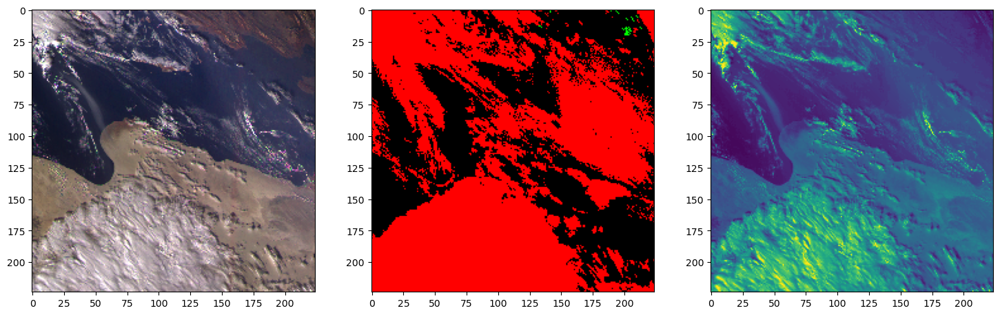

In [88]:
patch_ = tff.imread(r'H:\ELECTRO_DATASET\4_km_res\L2\all_patch_folder_ZSA\patches_rgb_electro_l2_20211115_1400/patch_33.tif')
mask_ = tff.imread(r'H:\ELECTRO_DATASET\4_km_res/L2/all_masks_folder/patches_masks_electro_l2_20211115_1400/patch_33.jpg')
bgr_ = patch_[:,:,:3].astype(np.uint8)
dem_ = patch_[:,:,-1]
fig, ax = plt.subplots(1,3, figsize=(18,6))
ax[0].imshow(bgr_)
ax[1].imshow(mask_)
ax[2].imshow(dem_)
plt.show()

**MODEL INITIALIZATION**

In [65]:
# lets initialize  architecture of segmentation FOR ALL 12 channels
model = smp.MAnet(
    encoder_name='efficientnet-b0', 
    in_channels=12,
    classes=3,)

**ELECTRO L2 PATCHES DATASET CLASS for inference**

In [100]:
class Electro_L2_Dataset(Dataset):
    def __init__(self, stack_dir_list, aux_dir, pytorch=True, include_BT = True):
        super().__init__()
        self.pytorch = pytorch   
        self.include_BT = include_BT
        self.stack_dir_list = stack_dir_list
        self.aux_dir = aux_dir
        self.stack_dirs = []
        self.stack_dirs_BT = []
        total_len = 0
        for i in range(len(self.stack_dir_list)): # iterate over number of pictures in dataset
            stack_dir = self.stack_dir_list[i]
            stack_dir_BT = self.stack_dir_list[i].replace('rgb', 'BT').replace('folder_ZSA','folder_BT')
            patch_files = glob.glob(stack_dir+'/*')
            patch_files_BT = glob.glob(stack_dir_BT+'/*')
            for j in range(len(patch_files)):
                patch_file = stack_dir+'/patch_'+str(j)+'.tif'
                self.stack_dirs.append(patch_file)
                patch_file_BT = patch_file.replace('rgb', 'BT').replace('folder_ZSA','folder_BT')
                self.stack_dirs_BT.append(patch_file_BT)        
    def __len__(self):
        num_patches = int((len(self.stack_dirs))) 
        return num_patches
    
    def open_rgb_normed(self, idx, invert=False):
        patch_file = self.stack_dirs[idx]
        patch = tff.imread(patch_file)
        r,g,b = patch[:,:,0]/255, patch[:,:,1]/255, patch[:,:,2]/255
        patch_normed  = np.dstack([b, g ,r])
        return patch_normed 
    
    def open_BT_normed(self, idx, invert=False):
        patch_file_BT = self.stack_dirs_BT[idx]
        patch_BT = tff.imread(patch_file_BT)
        return patch_BT 
    
    def open_aux(self, idx, invert=False):
        patch_file = self.aux_dir+'/patch_'+str(idx)+'.tif'
        patch = tff.imread(patch_file)
        lon,lat,dem = patch[:,:,0],patch[:,:,1],patch[:,:,2]
        lon,lat = (lon+180.0)/360.0,(lat+90.0)/180.0
        dem = dem/10000
        lonlatdem_normed = np.dstack([lon,lat,dem])
        return lonlatdem_normed
    
    def open_as_pil(self, idx):
        patch_file = self.stack_dirs[idx]
        patch_image = tff.imread(patch_file)
        return patch_image 
    
    def open_mask(self, idx):
        patch_file = self.stack_dirs[idx]
        mask_file = patch_file.replace('rgb','masks').replace('tif','jpg').replace('all_patch_folder_ZSA','all_masks_folder')
        mask = tff.imread(mask_file)
        snow_mask = mask[:,:,1]//255 #  1 - snow class
        cloud_mask = mask[:,:,0] # 2 - cloud class
        cloud_mask[cloud_mask!=0] = 255
        bg = mask[:,:,2]
        bin_mask = snow_mask + cloud_mask
        return mask#bin_mask
    
    def __getitem__(self, idx):
        patch_file = self.stack_dirs[idx]
        patch = tff.imread(patch_file)
        mask_file = patch_file.replace('rgb','masks').replace('tif','jpg').replace('all_patch_folder_ZSA','all_masks_folder')
        mask = tff.imread(mask_file)
        snow_mask = mask[:,:,1]//255 #  1 - snow class
        cloud_mask = mask[:,:,0] # 2 - cloud class
        cloud_mask[cloud_mask!=0]=2
        bin_mask = snow_mask+cloud_mask
        r,g,b = patch[:,:,0]/255, patch[:,:,1]/255, patch[:,:,2]/255
        aux_file = self.aux_dir+'/patch_'+str(idx)+'.tif'
        aux = tff.imread(aux_file)
        lon,lat,dem = aux[:,:,0],aux[:,:,1],aux[:,:,2]
        lon,lat = (lon+180.0)/360.0,(lat+90.0)/180.0
        dem = dem/10000
        aux_normed = np.stack([lon, lat, dem])
        patch_normed  = np.stack([b, g ,r])
        if self.include_BT:
            patch_file_BT = self.stack_dirs_BT[idx] 
            BT_normed = tff.imread(patch_file_BT).transpose(2,0,1)
            full_stack = np.concatenate((patch_normed, BT_normed, aux_normed), axis=0)
            # order of channels: b, g, r, BT4, BT5, BT6, BT7, BT8, BT9, lon, lat, dem
            full_stack = torch.tensor(full_stack, dtype=torch.float32)
        else:
            full_stack = np.concatenate((patch_normed, aux_normed), axis=0)
            full_stack = torch.tensor(full_stack, dtype=torch.float32)
        return full_stack,bin_mask

### SET FONT FOR ALL PICS

In [343]:
font = {'family' : 'monospace',
        'weight' : 'bold',
        'size'   : 10}
plt.rc('font', **font)

input channels ranges:
tensor(0.1255) tensor(0.9294)
tensor(0.0588) tensor(1.)
tensor(0.0392) tensor(1.)
tensor(0.6280) tensor(0.8640)
tensor(0.4040) tensor(0.6782)
tensor(0.6924) tensor(0.8748)
tensor(0.7036) tensor(0.8894)
tensor(0.7027) tensor(0.8933)
tensor(0.8042) tensor(0.9405)
tensor(0.5126) tensor(0.5555)
tensor(0.6439) tensor(0.7055)
tensor(0.) tensor(0.1988)


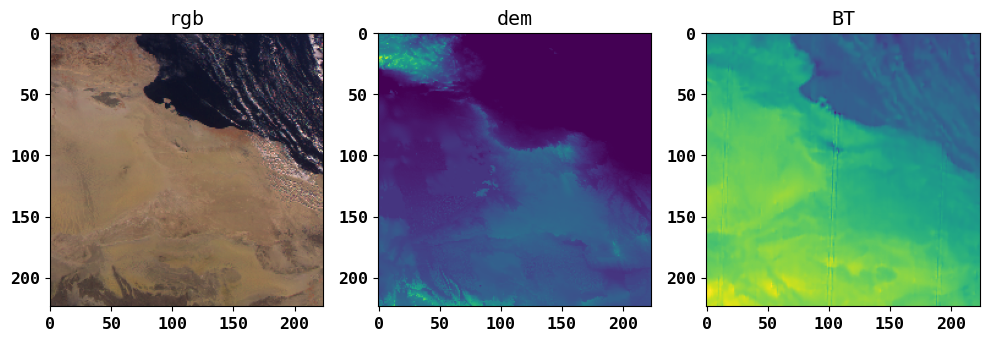

(torch.Size([12, 224, 224]), 144)

In [344]:
year = '2023'
time = '1400'
months = ['january','february','march','april','may']
dates = ['20230115','20230215','20230315','20230415','20230515']
k = 0#-1
month = months[k]
date = dates[k]
stack_dir = [r'H:\ELECTRO_DATASET\4_km_res\L2\all_patch_folder_ZSA/patches_rgb_electro_l2_'+date+'_'+time]
aux_dir_l2 = r'H:\ELECTRO_DATASET\4_km_res\L2/lon_lat_dem'
Electro_L2_ds = Electro_L2_Dataset(stack_dir_list=stack_dir, aux_dir = aux_dir_l2, include_BT = True)
SAMPLE_INDX =32
x_rgb_lonlat, y = Electro_L2_ds[SAMPLE_INDX]
print('input channels ranges:')
for i in range(len(x_rgb_lonlat)):
    print(torch.min(x_rgb_lonlat[i]),torch.max(x_rgb_lonlat[i]))
fig, ax = plt.subplots(1,3, figsize=(12,4))
ax[0].imshow(Electro_L2_ds.open_as_pil(SAMPLE_INDX))
ax[1].imshow(Electro_L2_ds.open_aux(SAMPLE_INDX)[:,:,-1])
ax[2].imshow(Electro_L2_ds.open_BT_normed(SAMPLE_INDX)[:,:,0])
ax[0].set_title('rgb')
ax[1].set_title('dem')
ax[2].set_title('BT')
plt.show()
x_rgb_lonlat.shape ,len(Electro_L2_ds)

### JUST VISUALIZATION

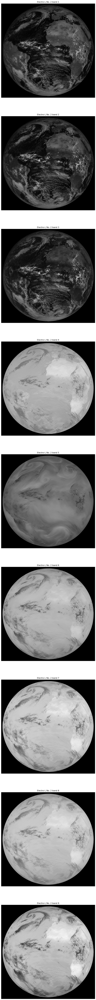

In [261]:
path = r'H:\GOES_16_17_DATASET\src\ELECTRO_L2\2021\october_15/'
BT_path = path+'BT_normed_1200.tif'
rgb_path = path+'rgb_raw_1200.tif'
rgb = tff.imread(rgb_path)
BT = tff.imread(BT_path)
stack = np.concatenate((rgb,BT), axis = -1)
fig, ax = plt.subplots(9,1, figsize=(12,12*9))
for i in range(9):
    ax[i].imshow(stack[:,:,i], cmap='gray')
    ax[i].set_title('Electro-L No. 2 band '+str(i+1))
    ax[i].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
plt.show()

### CUSTOM IoU METRIC WITH IGNORE EMPTY CLASS from ARTEM : DOES nOT WORk So FAR(

In [251]:
from typing import List, Optional, Union

from torchmetrics import Metric

import torch


class IoU(Metric):
    """IoU score"""

    is_differentiable: bool = False
    higher_is_better: bool = True

    def __init__(
        self,
        thresholds: Union[float, List[float]] = 0.5,
        thresholds_step: Optional[Union[int, List[int]]] = None,
        average: str = "mean",
        ignore_empty: bool = True,
        zero_division: float = 1e-8,
    ):
        """
        Args:
            thresholds (Union[float, List[float]], optional): classification threshold binary or multi-binary.\
            Defaults to 0.5.
            thresholds_step (Union[int, List[int]], optional): classification threshold
            step binary or multi-binary, used when not None.\
            Defaults to None.
            average (str): average strategy, avalible modes ["mean", "none"]. Defaults to "mean".
            ignore_empty (bool): whether to ignore empty target masks [True, False]. Defaults to False.
            zero_division (float): use value when intersetion andd union are equal to zero. Defaults to 0.
        """
        super().__init__()

        self.thresholds = thresholds
        if thresholds_step is not None:
            self.thresholds_step = torch.linspace(0, 1.0, thresholds_step + 2)[1:-1]
            self.thresholds_step = torch.nn.Parameter(self.thresholds_step)
            self.num_steps = thresholds_step
        else:
            self.thresholds_step = thresholds_step
        self.average = average
        self.ignore_empty = ignore_empty
        self.zero_division = zero_division

        self.add_state("sample_iou", default=[], dist_reduce_fx="cat")
        self.add_state("negative", default=[], dist_reduce_fx="cat")

    def update(self, preds: torch.Tensor, target: torch.Tensor):
        """Function collects per sample iou and bool value is sample negative or not"""

        B, C = preds.shape[:2]
        preds = preds.view(B, C, -1)
        target = target.view(B, C, -1)
        negative = torch.clip(target.view(B, -1).sum(axis=-1), 0, 1).type(torch.bool)

        if self.thresholds_step is None:
            preds = preds.transpose(1, 2) > self.thresholds
            preds = preds.transpose(1, 2)
        else:
            preds = preds.transpose(1, 2).unsqueeze(-1).expand(-1, -1, -1, self.num_steps)
            preds = preds > self.thresholds_step.unsqueeze(-1).expand(-1, C).T
            preds = preds.permute(0, 3, 2, 1)
            target = target.unsqueeze(1).expand(-1, self.num_steps, -1, -1)

        intersection = (preds * target).sum(dim=-1)
        cardinality = (preds + target).sum(dim=-1)
        union = cardinality

        scores = intersection / (union + 1e-6)
        scores[union.sum(dim=-1) == 0] = self.zero_division

        self.sample_iou.append(scores)
        self.negative.append(negative)

    def compute(self):
        """Computing IoU with respect to initiialization parameters"""

        negatives = self.negative
        sample_iou = (self.sample_iou)#[0]
        print(sample_iou)
        if self.average == "none":
            return sample_iou

        if self.thresholds_step is None:
            if self.ignore_empty:
                return sample_iou[negatives].mean()
            else:
                return sample_iou.mean()

        if self.ignore_empty:
            sample_iou = sample_iou[negatives].transpose(0, 2).mean(dim=-1)
            best_thds = sample_iou.argmax(dim=-1)
            sample_iou = torch.as_tensor([sample_iou[i, thd] for i, thd in enumerate(best_thds)]).mean()
            return sample_iou
        else:
            sample_iou = sample_iou.transpose(0, 2).mean(dim=-1)
            best_thds = sample_iou.argmax(dim=-1)
            sample_iou = torch.as_tensor([sample_iou[i, thd] for i, thd in enumerate(best_thds)]).mean()
            return sample_iou
IoU_cust = IoU()
output = torch.rand((1,3,224,224))
output = torch.functional.F.softmax(output, 1)
predictions = output.argmax(dim=1)
y = torch.ones((1,1,224,224)).long()
IoU_cust.update(predictions, y)
iou = IoU_cust.compute()
iou

[tensor([[0.4058, 0.3978, 0.3946, 0.3978, 0.3962, 0.3930, 0.3978, 0.3913, 0.4074,
         0.3978, 0.4074, 0.4043, 0.4136, 0.4043, 0.3863, 0.4074, 0.4027, 0.4011,
         0.3995, 0.4182, 0.3962, 0.4027, 0.3946, 0.4105, 0.4136, 0.3978, 0.4058,
         0.4386, 0.4027, 0.3995, 0.3930, 0.3962, 0.4197, 0.3913, 0.3812, 0.4074,
         0.3863, 0.3690, 0.3962, 0.4167, 0.3913, 0.3896, 0.3946, 0.4027, 0.4105,
         0.3863, 0.3725, 0.4043, 0.3829, 0.4182, 0.4074, 0.3896, 0.4027, 0.3995,
         0.4121, 0.3863, 0.3896, 0.3896, 0.4058, 0.4090, 0.3946, 0.3708, 0.3880,
         0.4058, 0.3930, 0.3946, 0.4011, 0.3995, 0.4105, 0.3995, 0.3880, 0.4058,
         0.4074, 0.4121, 0.3930, 0.4151, 0.3978, 0.3978, 0.4136, 0.3995, 0.4090,
         0.4027, 0.4136, 0.4011, 0.4043, 0.4151, 0.3962, 0.4011, 0.4121, 0.3978,
         0.4167, 0.4074, 0.4011, 0.4136, 0.3896, 0.4105, 0.4058, 0.4011, 0.4011,
         0.3896, 0.3896, 0.3978, 0.4011, 0.3863, 0.4074, 0.3946, 0.4121, 0.3930,
         0.4074, 0.3962, 0.

TypeError: list indices must be integers or slices, not list

iou for bg, snow, cloud tensor([0.6246, 0.9152, 0.8978])
f1 for bg, snow, cloud  tensor([0.7198, 0.9152, 0.9446])


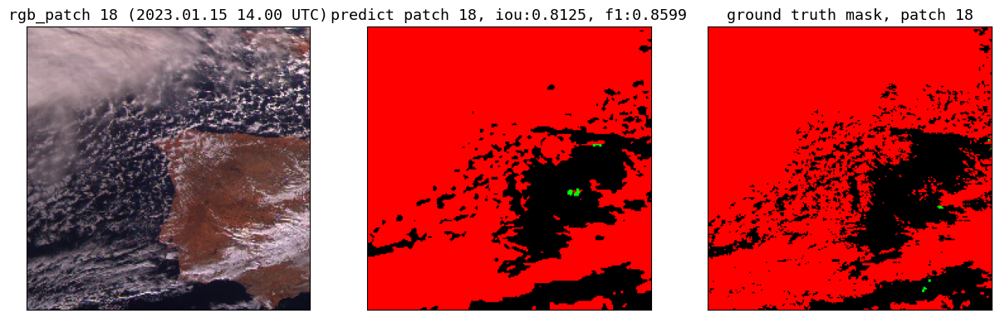

iou for bg, snow, cloud tensor([0.5926, 0.8705, 0.8266])
f1 for bg, snow, cloud  tensor([0.7226, 0.8705, 0.8953])


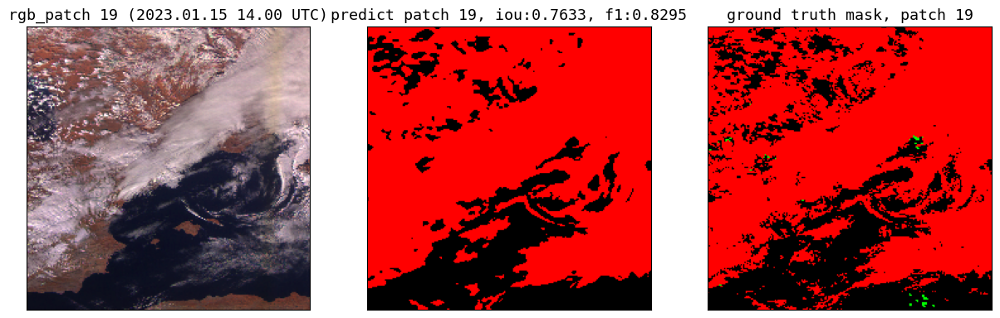

iou for bg, snow, cloud tensor([0.6703, 0.8750, 0.8984])
f1 for bg, snow, cloud  tensor([0.7472, 0.8750, 0.9451])


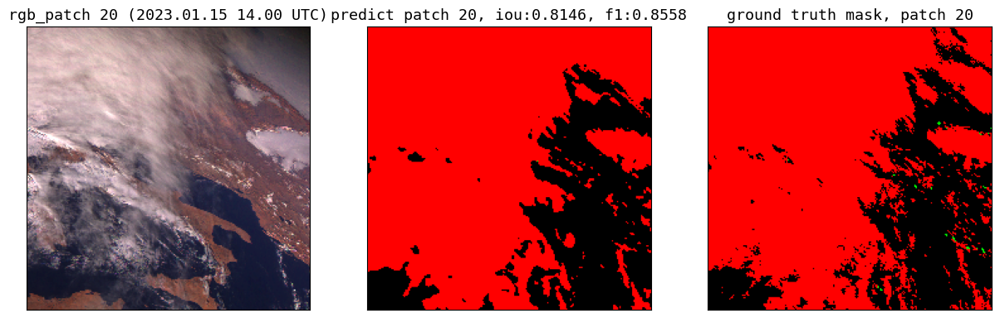

iou for bg, snow, cloud tensor([0.6353, 0.1518, 0.7882])
f1 for bg, snow, cloud  tensor([0.7559, 0.1518, 0.8802])


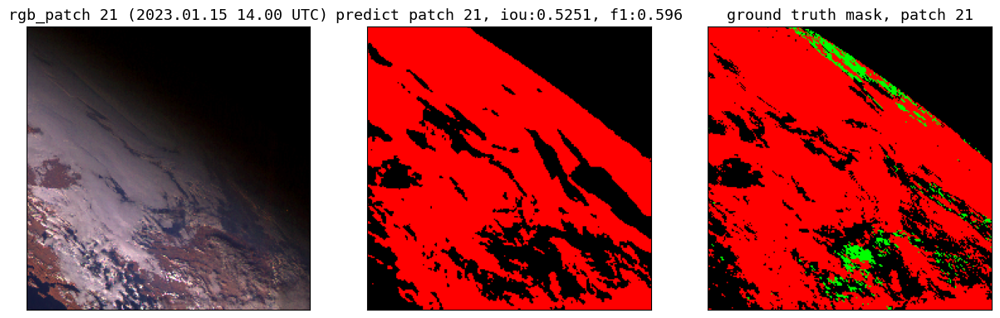

iou for bg, snow, cloud tensor([0.7683, 1.0000, 0.7854])
f1 for bg, snow, cloud  tensor([0.8670, 1.0000, 0.8775])


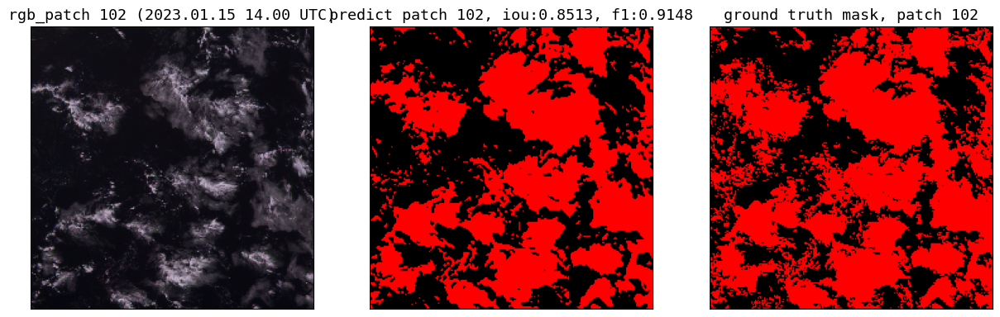

iou for bg, snow, cloud tensor([0.6886, 1.0000, 0.8792])
f1 for bg, snow, cloud  tensor([0.8115, 1.0000, 0.9351])


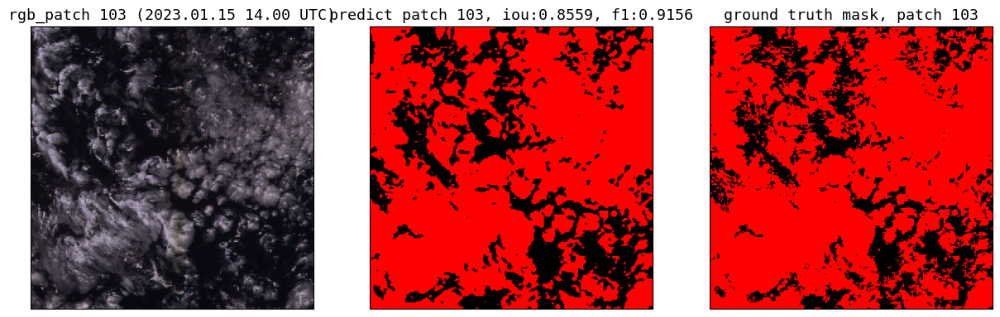

iou for bg, snow, cloud tensor([0.6482, 1.0000, 0.8507])
f1 for bg, snow, cloud  tensor([0.7780, 1.0000, 0.9175])


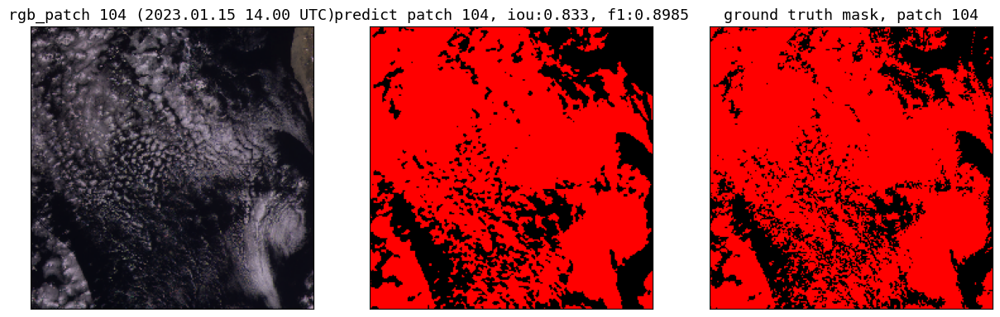

iou for bg, snow, cloud tensor([0.6788, 0.9598, 0.8036])
f1 for bg, snow, cloud  tensor([0.8045, 0.9598, 0.8877])


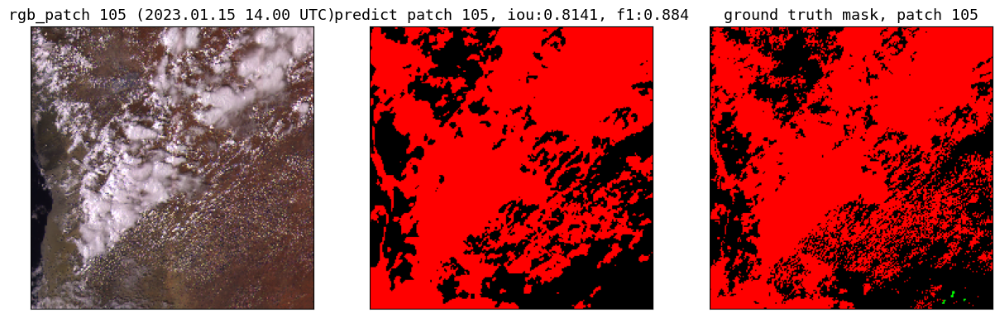

iou for bg, snow, cloud tensor([0.7092, 0.8750, 0.7187])
f1 for bg, snow, cloud  tensor([0.8245, 0.8750, 0.8263])


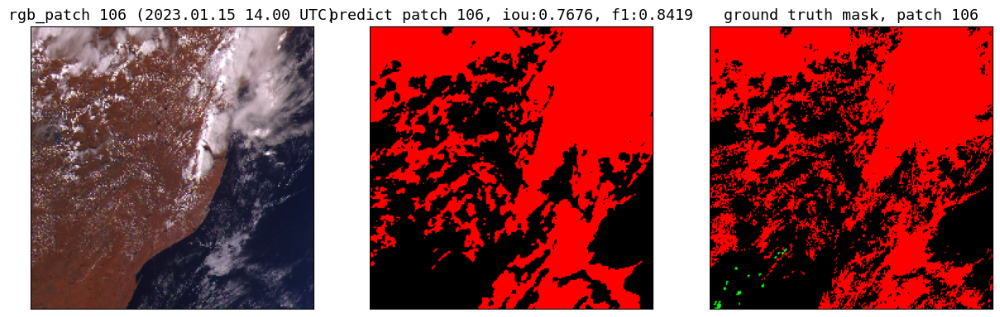

iou for bg, snow, cloud tensor([0.8463, 0.2753, 0.7594])
f1 for bg, snow, cloud  tensor([0.9149, 0.2768, 0.8612])


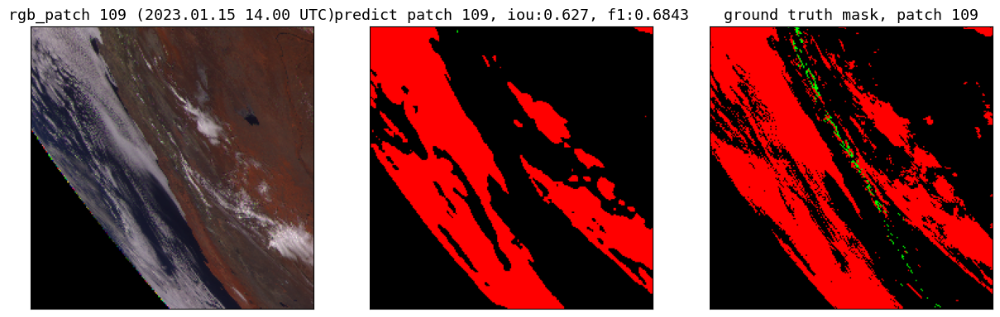

iou for bg, snow, cloud tensor([0.8697, 1.0000, 0.9076])
f1 for bg, snow, cloud  tensor([0.9229, 1.0000, 0.9490])


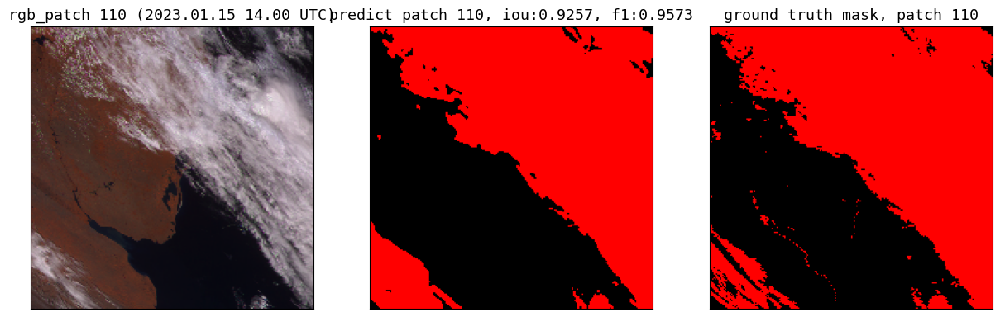

In [351]:
# INITIALIZE DATASET
font = {'family' : 'monospace',
        'weight' : 'bold',
        'size'   : 11}
plt.rc('font', **font)
###########################################
year = '2023'
time = '1400'
months = ['january','february','march','april','may']
dates = ['20230115','20230215','20230315','20230415','20230515']
# year = '2021'
# months = ['october','november','december']
# dates = ['20211015','20211115','20211215']
k = 0
#-1
month = months[k]
date = dates[k]
stack_dir = [r'H:\ELECTRO_DATASET\4_km_res\L2\all_patch_folder_ZSA/patches_rgb_electro_l2_'+date+'_'+time]
aux_dir_l2 = r'H:\ELECTRO_DATASET\4_km_res\L2/lon_lat_dem'
Electro_L2_ds = Electro_L2_Dataset(stack_dir_list=stack_dir, aux_dir = aux_dir_l2, include_BT = True)
#TESTING DATASET
date_lab = date[:4]+'.'+date[4:-2]+'.'+date[-2:]
time_lab = time[:2]+'.'+time[-2:]
time_label = ' ('+date_lab+' '+time_lab+ ' UTC)'
def visualize_MANet_pred(idx, model, dataset):
    x_rgb_lonlat, y = dataset[idx]
    y = torch.tensor(y).long().cuda()
    model.to(device)
    x_rgb_lonlat = x_rgb_lonlat.to(device)
    fig, ax = plt.subplots(1,3, figsize=(15,5))
    pred = model(x_rgb_lonlat.unsqueeze(0))#
    pred=predb_to_mask(pred).cuda()#.numpy()
    predictions = pred.cpu().numpy()#.argmax(dim=1).cpu().numpy()
    cloud_mask,snow_mask = predictions.copy(),predictions.copy()
    cloud_mask[cloud_mask!=2] = 0 
    cloud_mask[cloud_mask==2] = 255
    snow_mask[snow_mask!=1] = 0 
    snow_mask[snow_mask==1] = 255
    composed_mask = np.dstack([cloud_mask,snow_mask, np.zeros((224,224)).astype('uint8')])
    ax[0].imshow(open_sample_as_pil_no_norm(x_rgb_lonlat.cpu()))
    ax[1].imshow(composed_mask)
    ax[0].set_title('rgb_patch '+str(idx)+time_label)
    # COMPUTE STATS FOR PATCH
    #average = 'micro-imagewise' doesnot work WHY?
#     my_IoU = IoU_cust(pred, y)
#     print('my_IoU',my_IoU)
    tp, fp, fn, tn = smp.metrics.get_stats(pred, y, num_classes =3, mode='multiclass')
#     iou_score = smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro-imagewise").numpy()
#     f1_score = smp.metrics.f1_score(tp, fp, fn, tn, reduction="macro-imagewise").numpy()
    
    iou_score_sep = smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    f1_score_sep = smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    iou_score_sep = torch.sum(iou_score_sep, dim=0)/224
    f1_score_sep = torch.sum(f1_score_sep, dim=0)/224
    iou_score = torch.mean(iou_score_sep).numpy()
    f1_score = torch.mean(f1_score_sep).numpy()
    iou_score = np.round(iou_score,4)
    f1_score = np.round(f1_score,4)
    print('iou for bg, snow, cloud', iou_score_sep)
    print('f1 for bg, snow, cloud ', f1_score_sep)
    pred_title = 'predict patch '+str(idx)+ ', iou:'+ str(iou_score)+ ', f1:'+ str(f1_score)
    ax[1].set_title(pred_title)
    ax[2].imshow(dataset.open_mask(idx))
    ax[2].set_title('ground truth mask, patch '+str(idx))
    ax[0].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
    ax[1].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
    ax[2].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
    plt.show()
model_path = r'H:\ELECTRO_DATASET\4_km_res\L2\models/MAnet_Efficient_b0_12_inputs_4km_res_ep_216'#r'H:/LEVIR_CS/models/U-Net_segformer_7_inputs_ep_47'
model.load_state_dict(torch.load(model_path))
model.eval()
for idx in range(18,22):
    visualize_MANet_pred(idx, model, dataset = Electro_L2_ds)
for idx in range(102,107):
    visualize_MANet_pred(idx, model, dataset = Electro_L2_ds)
for idx in range(109,111):
    visualize_MANet_pred(idx, model, dataset = Electro_L2_ds)
# for idx in range(122,131):
#     visualize_MANet_pred(idx, model, dataset = Electro_L2_ds)

In [316]:
device = 'cuda'
def pred_and_save_masks(idx, model,dataset,pred_dir_cloud):
    try:x_rgb_lonlat, y = dataset[idx]
    except:print('cant open sample number:',idx)
    x_rgb_lonlat = x_rgb_lonlat.to(device)
    cloud_mask = model(x_rgb_lonlat.unsqueeze(0))
    pred=predb_to_mask(cloud_mask).numpy()
    cloud_mask,snow_mask = pred.copy(),pred.copy()
    cloud_mask[cloud_mask!=2] = 0 
    cloud_mask[cloud_mask==2] = 255
    snow_mask[snow_mask!=1] = 0 
    snow_mask[snow_mask==1] = 255
    pred_dir_snow = pred_dir_cloud.replace('cloud', 'snow')
    pred_name_cloud = pred_dir_cloud + 'patch_'+str(idx)+'.jpg'
    pred_name_snow = pred_dir_snow + 'patch_'+str(idx)+'.jpg'
    if not os.path.exists(pred_dir_cloud):
        os.makedirs(pred_dir_cloud)
    if not os.path.exists(pred_dir_snow):
        os.makedirs(pred_dir_snow)
    tff.imsave(pred_name_cloud,cloud_mask.astype(np.uint8))
    tff.imsave(pred_name_snow,snow_mask.astype(np.uint8))
pred_dir_cloud = r'H:\ELECTRO_DATASET\4_km_res\L2\predicts/'+date+'_'+time+'/predict_cloud_MAnet/'
for idx in tqdm(range(len(Electro_L2_ds))):
    pred_and_save_masks(idx=idx, model = model, dataset = Electro_L2_ds,pred_dir_cloud = pred_dir_cloud)

100%|████████████████████████████████████████████████████████████████████████████████| 144/144 [00:12<00:00, 11.19it/s]


100%|██████████████████████████████████████████████████████████████████████████████| 144/144 [00:00<00:00, 1703.04it/s]


(2784, 2784)


100%|██████████████████████████████████████████████████████████████████████████████| 144/144 [00:00<00:00, 1552.52it/s]


(2784, 2784)


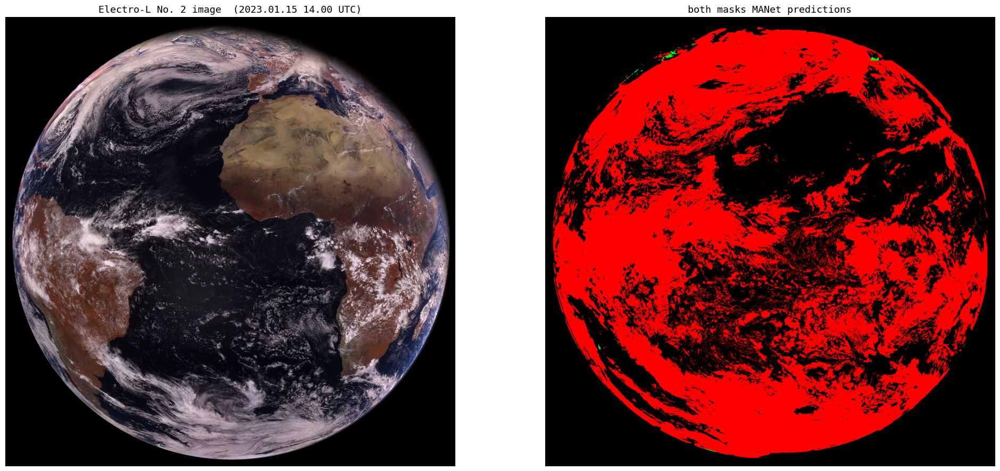

In [348]:
def merge_masks_cloud(pred_dir, time, date,output_shape = (2688, 2688)):
    mask_folder_cloud = pred_dir+date+'_'+time+'/predict_cloud_MAnet'
    merged_mask_file_name_cloud = mask_folder_cloud + '.jpg'
    output_matrix = np.zeros(output_shape, dtype=np.uint8)
    # Loop through each patch and insert it into the output matrix
    for i in tqdm(range(144)):
        patch_file = f"{mask_folder_cloud}/patch_{i}.jpg"
        patch_image = tff.imread(patch_file)
        row = (i // 12) * 224
        col = (i % 12) * 224
        output_matrix[row:row+224, col:col+224] = patch_image
    output_matrix = np.pad(output_matrix,((48,48),(48,48)))
    print(output_matrix.shape)
    # Save the output matrix to the specified file
    tff.imsave(merged_mask_file_name_cloud, output_matrix)
    return output_matrix
def merge_masks_snow(pred_dir, time, date,output_shape = (2688, 2688)):
    mask_folder_snow = pred_dir+date+'_'+time+'/predict_snow_MAnet'
    merged_mask_file_name_snow = mask_folder_snow + '.jpg'
    output_matrix = np.zeros(output_shape, dtype=np.uint8)
    # Loop through each patch and insert it into the output matrix
    for i in tqdm(range(144)):
        patch_file = f"{mask_folder_snow}/patch_{i}.jpg"
        patch_image = tff.imread(patch_file)
        row = (i // 12) * 224
        col = (i % 12) * 224
        output_matrix[row:row+224, col:col+224] = patch_image
    output_matrix = np.pad(output_matrix,((48,48),(48,48)))
    print(output_matrix.shape)
    # Save the output matrix to the specified file
    tff.imsave(merged_mask_file_name_snow, output_matrix)
    return output_matrix
def make_composed_masks(merged_mask_cloud,merged_mask_snow,default_dir,pred_dir,year, month, time, date, plot = True):
    rgb_nir = tff.imread(default_dir+year+'/'+month+'_15\ZSA/rgb_ZSA_'+time+'.tif')
#     merged_mask_cloud = merge_masks(mask_folder_cloud,output_file = merged_mask_file_name_cloud,output_shape = merged_shape)
#     merged_mask_snow = merge_masks(mask_folder_snow,output_file = merged_mask_file_name_snow,output_shape = merged_shape)
    composed_cloud = np.dstack((rgb_nir[:,:,0],rgb_nir[:,:,1],merged_mask_cloud))
    composed_snow = np.dstack((rgb_nir[:,:,0],rgb_nir[:,:,1],merged_mask_snow))
    composed_both_masks = np.dstack((merged_mask_snow,rgb_nir[:,:,0],merged_mask_cloud))
    composed_masks_dir = pred_dir+date+'_'+time+'/composed_masks_MAnet.jpg'
    composed_snow_dir = pred_dir+date+'_'+time+'/composed_with_snow_MAnet.jpg'
    composed_cloud_dir = pred_dir+date+'_'+time+'/composed_with_cloud_MAnet.jpg'
    Image.fromarray(composed_snow.astype(np.uint8)).save(composed_snow_dir)
    Image.fromarray(composed_cloud.astype(np.uint8)).save(composed_cloud_dir)
    Image.fromarray(composed_both_masks.astype(np.uint8)).save(composed_masks_dir)
    if plot:
        fig, ax = plt.subplots(1,2, figsize=(24,12))
        ax[0].imshow(rgb_nir)
        bg = np.zeros((2784, 2784), dtype=np.uint8)
        ax[1].imshow(np.dstack((merged_mask_cloud,merged_mask_snow,bg)))
        ax[1].set_title('both masks MANet predictions')
        date_lab = date[:4]+'.'+date[4:-2]+'.'+date[-2:]
        time_lab = time[:2]+'.'+time[-2:]
        time_label = ' ('+date_lab+' '+time_lab+ ' UTC)'
        label = 'Electro-L No. 2 image '+time_label
        ax[0].set_title(label)
        ax[0].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
        ax[1].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
        plt.show()
    #return merged_mask_cloud, merged_mask_snow
default_dir = r'H:\GOES_16_17_DATASET\src\ELECTRO_L2/'
pred_dir = r'H:\ELECTRO_DATASET\4_km_res\L2\predicts/'
merged_mask_cloud = merge_masks_cloud(pred_dir, time, date)
merged_mask_snow = merge_masks_snow(pred_dir, time, date)
make_composed_masks(merged_mask_cloud,merged_mask_snow,default_dir,pred_dir,year, month, time, date)

**COMPUTE METRICS FOR THE FULL IMG PREDICT**

F1 and IoU results of Electro-L No. 2 MAnet tested on Met-10 masks
Test F1 score: 0.8147, Test IoU: 0.7655
Test FAR: 0.0826
Test F1 score for each class (bg, cloud, snow): tensor([0.9193, 0.8869, 0.6379]), 
Test IoU for each class (bg, cloud, snow): tensor([0.8543, 0.8107, 0.6315])


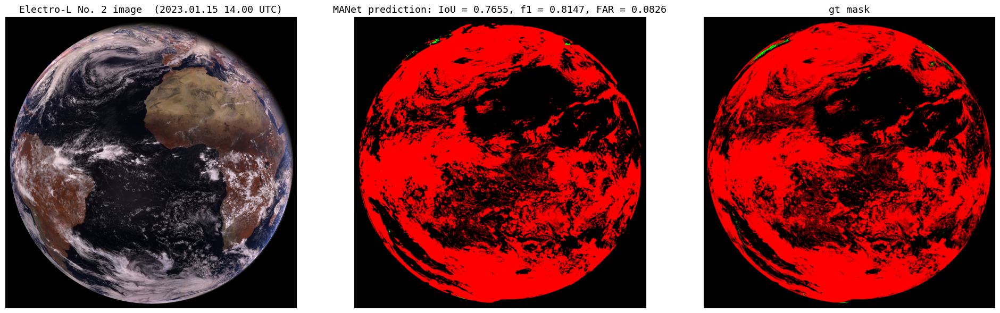

In [349]:
def compute_metrics_full_img_L2(merged_mask_snow,merged_mask_cloud, default_dir,pred_dir,year, month, time, date, plot = True):
    merged_pred_snow = merged_mask_snow.copy()
    merged_pred_cloud = merged_mask_cloud.copy()
    merged_pred_snow[merged_pred_snow!=0] = 255
    merged_pred_cloud[merged_pred_cloud!=0] = 255
#     print(np.unique(merged_pred_snow))
    merged_mask_snow[merged_mask_snow!=0] = 2
    merged_mask_cloud[merged_mask_cloud!=0] = 1
    try:
        cloud_mask = tff.imread(default_dir+year+'/'+month+'_15/both_cloud_mask_'+time+'.tif')
        Met10_dir = default_dir + 'masks_of_Met_10_and_GOES_16_for_L2.tif'
        Met10_disk = tff.imread(Met10_dir)//255
    except:
        cloud_mask = tff.imread(default_dir+year+'/'+month+'_15/cloud_'+time+'_Met_10_reproj.jpg')
        Met10_dir = default_dir + 'Met_10_reproj.jpg'
        Met10_disk = np.array(Image.open(Met10_dir)).mean(axis = 2).astype(int)
        Met10_disk[Met10_disk<255]=0
        Met10_disk=(Met10_disk//255).astype(np.uint8)
    snow_map = tff.imread(default_dir+year+'/'+month+'_15/snow_map.jpg')
    if snow_map.shape[0]!=2784:
            snow_map = np.array(Image.fromarray(snow_map*255).resize((2712,2712),resample=Image.NEAREST))
            snow_map = np.pad(snow_map, (36,36))
            snow_map = (snow_map*255).astype(np.uint8)
    false_snow = ((snow_map/255)*(cloud_mask/255)*255).astype(np.uint8)
    true_snow_mask = snow_map-false_snow
    true_snow_mask[true_snow_mask!=0] = 2
    cloud_mask[cloud_mask!=0] = 1
    gt_mask = cloud_mask+true_snow_mask
    gt_mask = Met10_disk*gt_mask
#     test_f1_score = torchmetrics.F1Score(num_classes=3, task = 'multiclass', average = 'macro')
#     test_iou_score = torchmetrics.JaccardIndex(num_classes=3, task = 'multiclass')
#     test_f1_score_sep = torchmetrics.F1Score(num_classes=3, task = 'multiclass', average = None)
#     test_iou_score_sep = torchmetrics.JaccardIndex(num_classes=3, task = 'multiclass', average = None)
    test_acc = torchmetrics.Accuracy(num_classes=3, task = 'multiclass')
    #######################################
    pred_stack_ = merged_mask_snow + merged_mask_cloud
#     print(np.unique(pred_stack_))
    predictions = torch.tensor(pred_stack_)
    y = torch.tensor(gt_mask)
    tp, fp, fn, tn = smp.metrics.get_stats(predictions, y, num_classes =3, mode='multiclass')
#     iou_score = smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro-imagewise").numpy()
#     f1_score = smp.metrics.f1_score(tp, fp, fn, tn, reduction="macro-imagewise").numpy()
    
    iou_score_sep = smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    f1_score_sep = smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
#     print(f1_score_sep.shape)
    iou_score_sep = torch.sum(iou_score_sep, dim=0)/2784
    f1_score_sep = torch.sum(f1_score_sep, dim=0)/2784
#     print(f1_score_sep)
    iou_score = torch.mean(iou_score_sep).numpy()
    f1_score = torch.mean(f1_score_sep).numpy()
    iou_score = np.round(iou_score,4)
    f1_score = np.round(f1_score,4)
#     test_f1_score.update(predictions, y)
#     test_iou_score.update(predictions, y)
#     test_f1_score_sep.update(predictions, y)
#     test_iou_score_sep.update(predictions, y)
    test_acc.update(predictions, y)
    ############################
#     test_f1 = test_f1_score.compute()
#     test_iou = test_iou_score.compute()
    test_acc = test_acc.compute()
    #calculate the same metrics seperately for each class
#     test_f1_sep = test_f1_score_sep.compute()
#     test_iou_sep = test_iou_score_sep.compute()
    FAR = np.round((1 - test_acc).numpy(),4)
    # printing the results
    print('F1 and IoU results of Electro-L No. 2 MAnet tested on Met-10 masks')
    print(f"Test F1 score: {f1_score:.4f}, Test IoU: {iou_score:.4f}")
    print(f"Test FAR: {FAR:.4f}")
    print(f"Test F1 score for each class (bg, cloud, snow): {f1_score_sep}, \nTest IoU for each class (bg, cloud, snow): {iou_score_sep}")
    if plot:
        gt_snow, gt_cloud, gt_bg = (true_snow_mask/2*255).astype(np.uint8),(cloud_mask*255).astype(np.uint8), np.zeros((2784,2784)).astype(np.uint8)
        gt_snow = gt_snow*Met10_disk
        gt_cloud = gt_cloud*Met10_disk
        gt_stack = np.dstack([gt_cloud, gt_snow,gt_bg])
        pred_stack = np.dstack([merged_pred_cloud,merged_pred_snow,gt_bg])
        rgb_nir = tff.imread(default_dir+year+'/'+month+'_15\ZSA/rgb_ZSA_'+time+'.tif')
        fig, ax = plt.subplots(1,3, figsize=(24,12))
        ax[-1].imshow(gt_stack)
        plt.tick_params(left = False, right = False , labelleft = False ,
                        labelbottom = False, bottom = False)
        ax[-1].set_title('gt mask')
        ax[1].imshow(pred_stack)
        ax[1].set_title('MANet prediction: IoU = '+str(iou_score)+', f1 = '+str(f1_score)+', FAR = '+str(FAR))
        ax[0].imshow(rgb_nir)
        date_lab = date[:4]+'.'+date[4:-2]+'.'+date[-2:]
        time_lab = time[:2]+'.'+time[-2:]
        time_label = ' ('+date_lab+' '+time_lab+ ' UTC)'
        label = 'Electro-L No. 2 image '+time_label
        ax[0].set_title(label)
        # hide ticks on plots
        ax[0].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
        ax[1].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
        ax[2].tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
        plt.show()
compute_metrics_full_img_L2(merged_mask_snow, merged_mask_cloud, default_dir, pred_dir, year, month, time, date)

### EXPLAINABILITY REMAKE

In [595]:
problem_patches_idxs = [18,19,20,21,102,103,104,105,106,107,109,110]
year = '2023'
time = '1400'
months = ['january','february','march','april','may']
dates = ['20230115','20230215','20230315','20230415','20230515']
# year = '2021'
# months = ['october','november','december']
# dates = ['20211015','20211115','20211215']
k = 1
month = months[k]
date = dates[k]
stack_dir = [r'H:\ELECTRO_DATASET\4_km_res\L2\all_patch_folder_ZSA/patches_rgb_electro_l2_'+date+'_'+time]
aux_dir_l2 = r'H:\ELECTRO_DATASET\4_km_res\L2/lon_lat_dem'
Electro_L2_ds = Electro_L2_Dataset(stack_dir_list=stack_dir, aux_dir = aux_dir_l2, include_BT = True)
########################################
# OPEN  all these samples
patch_path = r'H:/GOES_16_17_DATASET/finetunning_electro/all_patch_folder_ZSA/patches_rgb_aux_electro_l2_'+date+'_'+time
samples,masks = torch.zeros((len(problem_patches_idxs),12,224,224)),torch.zeros((len(problem_patches_idxs),224,224))#[],[]
def open_patch(Electro_L2_ds, idx):
        full_stack, y  = Electro_L2_ds[idx]
        return full_stack, torch.tensor(y).long()
for i in range(len(problem_patches_idxs)):
    idx = problem_patches_idxs[i]
    sample, mask = open_patch(Electro_L2_ds, idx)
#     print(sample[-1].shape)
    print(torch.max(sample[-1]), torch.min(sample[-1]))
    samples[i] = sample
    masks[i] = mask
print(samples.shape,masks.shape, type(masks[0]))

tensor(0.2374) tensor(5.3711e-06)
tensor(0.4022) tensor(5.3711e-06)
tensor(0.3237) tensor(5.3711e-06)
tensor(0.4272) tensor(0.)
tensor(5.3711e-06) tensor(5.3711e-06)
tensor(5.3711e-06) tensor(5.3711e-06)
tensor(0.1222) tensor(5.3711e-06)
tensor(0.2430) tensor(5.3711e-06)
tensor(0.2489) tensor(5.3711e-06)
tensor(0.2485) tensor(0.)
tensor(0.6160) tensor(0.)
tensor(0.1634) tensor(0.)
torch.Size([12, 12, 224, 224]) torch.Size([12, 224, 224]) <class 'torch.Tensor'>


#### COMPUTE INITIAL STATS FOR THESE SAMPLES

In [596]:
font = {'family' : 'monospace',
        'weight' : 'bold',
        'size'   : 10.5}
plt.rc('font', **font)
##############################
model.eval()
output = model(samples.cuda())
output = torch.functional.F.softmax(output, 1)
# Assuming output has shape (batch_size, num_classes, height, width)
# Convert the output to predictions by taking the argmax along the channel dimension
predictions = output.argmax(dim=1).cuda()
masks = masks.type(torch.LongTensor).cuda()
tp, fp, fn, tn = smp.metrics.get_stats(predictions, masks, num_classes =3, mode='multiclass')
iou_score_sep = smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
f1_score_sep = smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
init_iou_score_sep = torch.sum(iou_score_sep, dim=0)/len(samples)
init_f1_score_sep = torch.sum(f1_score_sep, dim=0)/len(samples)
#     print(f1_score_sep)
iou_score = torch.mean(init_iou_score_sep).numpy()
f1_score = torch.mean(init_f1_score_sep).numpy()
init_iou_score = np.round(iou_score,4)
init_f1_score = np.round(f1_score,4)
print('F1 and IoU results of Electro-L No. 2 MAnet tested on Met-10 masks')
print(f"Test F1 score: {init_f1_score:.4f}, Test IoU: {init_iou_score:.4f}")
print(f"Test F1 score for each class (bg, snow, cloud): {init_f1_score_sep}, \nTest IoU for each class (bg, snow, cloud): {init_iou_score_sep}")

F1 and IoU results of Electro-L No. 2 MAnet tested on Met-10 masks
Test F1 score: 0.7905, Test IoU: 0.7239
Test F1 score for each class (bg, snow, cloud): tensor([0.8964, 0.5858, 0.8893]), 
Test IoU for each class (bg, snow, cloud): tensor([0.8134, 0.5552, 0.8030])


iou for bg, snow, cloud tensor([0.7289, 0.8571, 0.8191])
f1 for bg, snow, cloud  tensor([0.8160, 0.8571, 0.8977])


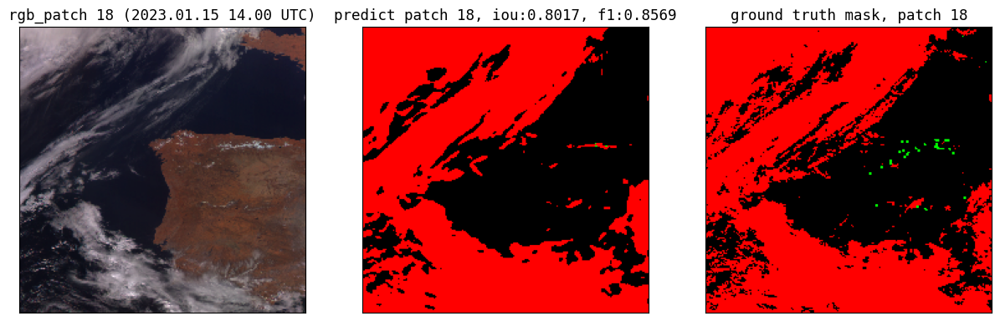

iou for bg, snow, cloud tensor([0.7298, 0.6108, 0.8076])
f1 for bg, snow, cloud  tensor([0.8366, 0.6468, 0.8887])


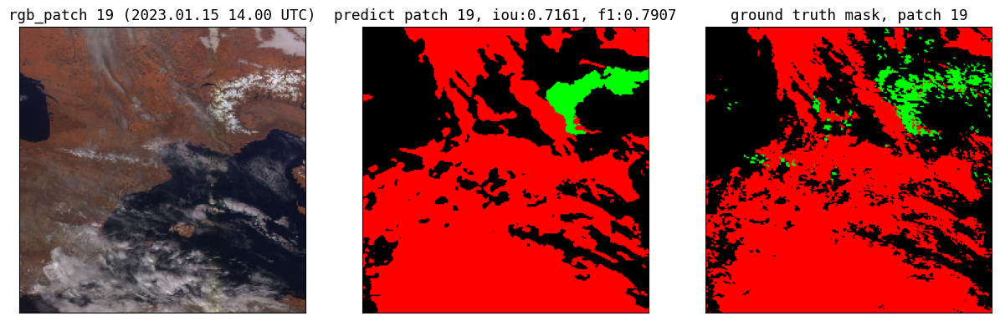

iou for bg, snow, cloud tensor([0.8843, 0.2844, 0.5724])
f1 for bg, snow, cloud  tensor([0.9374, 0.3251, 0.6767])


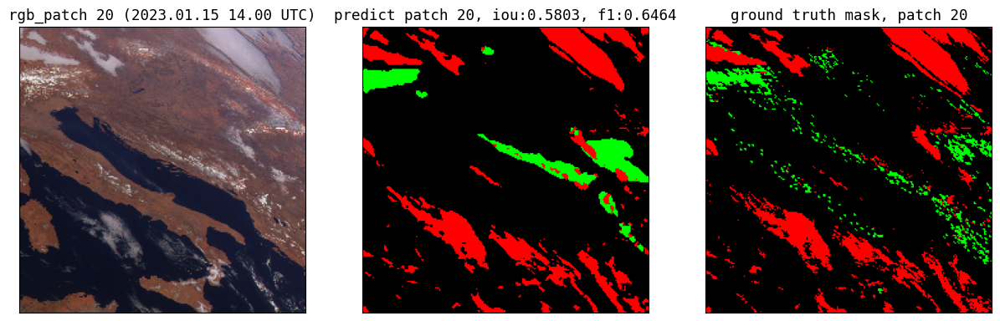

iou for bg, snow, cloud tensor([0.7585, 0.4141, 0.8805])
f1 for bg, snow, cloud  tensor([0.8553, 0.4317, 0.9350])


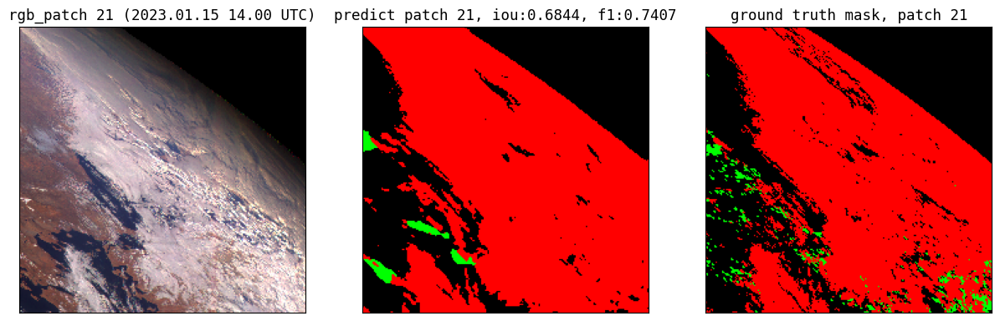

iou for bg, snow, cloud tensor([0.7466, 1.0000, 0.6713])
f1 for bg, snow, cloud  tensor([0.8524, 1.0000, 0.7968])


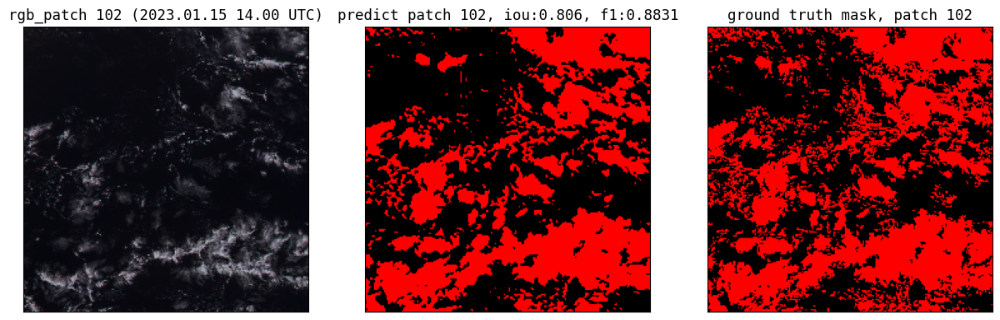

iou for bg, snow, cloud tensor([0.7604, 1.0000, 0.7109])
f1 for bg, snow, cloud  tensor([0.8599, 1.0000, 0.8214])


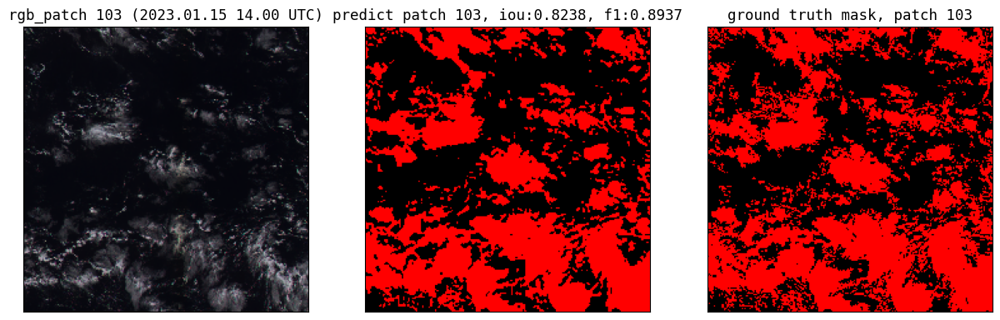

iou for bg, snow, cloud tensor([0.7741, 1.0000, 0.7889])
f1 for bg, snow, cloud  tensor([0.8705, 1.0000, 0.8780])


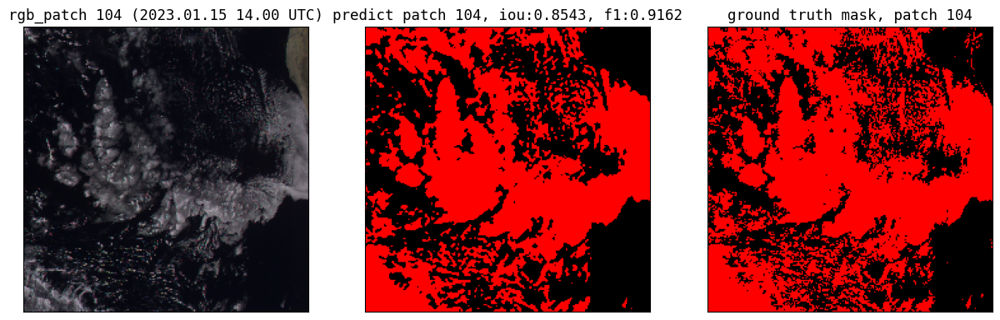

iou for bg, snow, cloud tensor([0.8386, 1.0000, 0.8813])
f1 for bg, snow, cloud  tensor([0.9104, 1.0000, 0.9355])


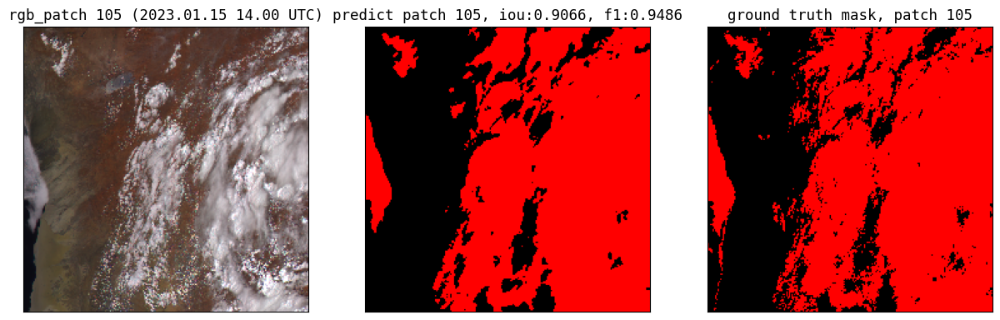

iou for bg, snow, cloud tensor([0.7644, 0.9375, 0.7895])
f1 for bg, snow, cloud  tensor([0.8638, 0.9375, 0.8797])


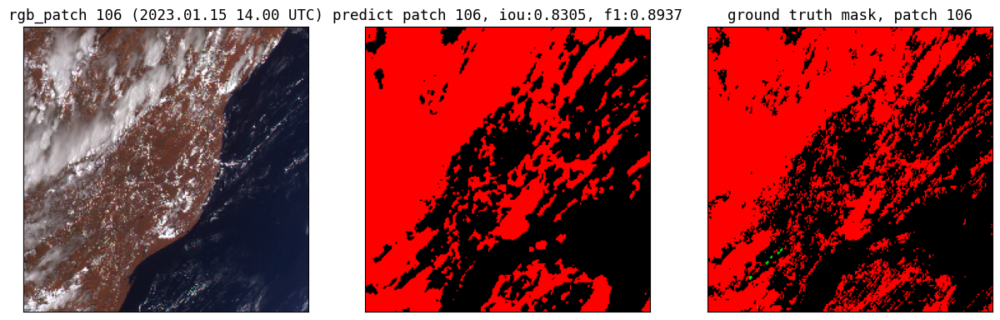

iou for bg, snow, cloud tensor([0.8681, 1.0000, 0.6905])
f1 for bg, snow, cloud  tensor([0.9288, 1.0000, 0.8100])


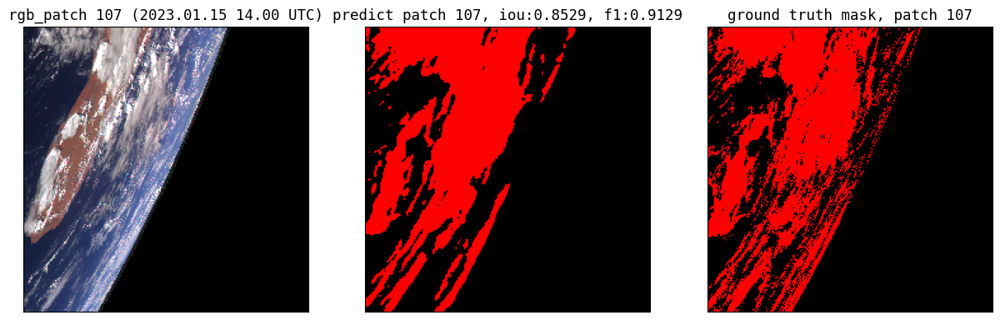

iou for bg, snow, cloud tensor([0.8812, 0.4509, 0.8205])
f1 for bg, snow, cloud  tensor([0.9349, 0.4509, 0.8980])


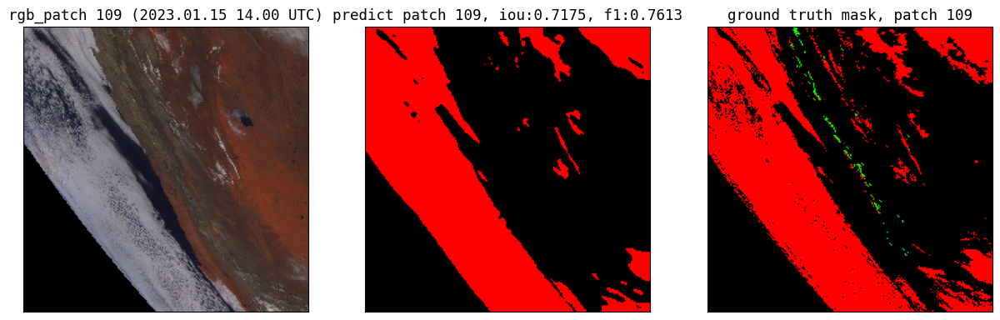

iou for bg, snow, cloud tensor([0.7751, 1.0000, 0.8306])
f1 for bg, snow, cloud  tensor([0.8556, 1.0000, 0.8990])


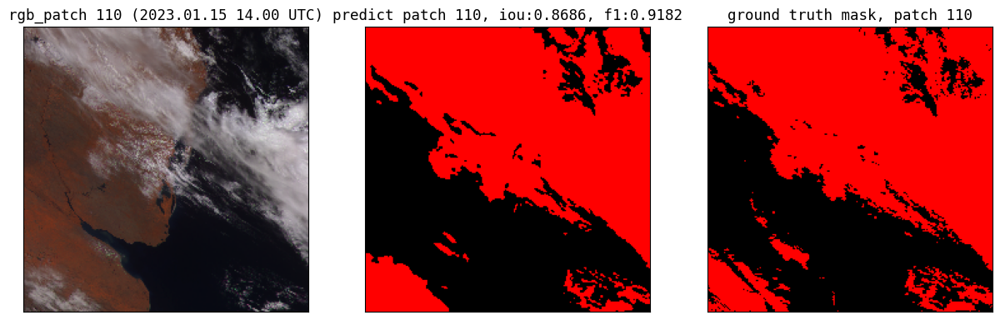

In [369]:
for idx in problem_patches_idxs:
    visualize_MANet_pred(idx, model, dataset = Electro_L2_ds)

#### CALTULATE MEAN & STD FOR FURTHER SHUFFLING

In [597]:
# LONLAT
mean_lon, mean_lat, mean_dem = [],[],[]
for sample in tqdm(samples):
    mean_lon.append(torch.mean(sample[-3])), mean_lat.append(torch.mean(sample[-2])), mean_dem.append(torch.mean(sample[-1]))
# BT
mean_BT4, mean_BT5,mean_BT6,mean_BT7,mean_BT8,mean_BT9 = [],[],[],[],[],[]
for sample in tqdm(samples):
    mean_BT4.append(torch.mean(sample[3])), mean_BT5.append(torch.mean(sample[4]))
    mean_BT6.append(torch.mean(sample[5])), mean_BT7.append(torch.mean(sample[6]))
    mean_BT8.append(torch.mean(sample[7])), mean_BT9.append(torch.mean(sample[8]))
# RGB
mean_ch1, mean_ch2,mean_ch3 = [],[],[]
for sample in tqdm(samples):
    mean_ch1.append(torch.mean(sample[0])), mean_ch2.append(torch.mean(sample[1])), mean_ch3.append(torch.mean(sample[2]))
#AUX
std_lon = np.std(np.array(mean_lon))
std_lat = np.std(np.array(mean_lat))
std_dem  = np.std(np.array(mean_dem))
mean_lon = np.mean(np.array(mean_lon))
mean_lat = np.mean(np.array(mean_lat))
mean_dem = np.mean(np.array(mean_dem))

print('mean lon in samples =',(mean_lon))
print('mean lat in samples =',(mean_lat))
print('mean dem in samples =',(mean_dem))
print('std lon in samples =',(std_lon))
print('std lat in samples =',(std_lat))
print('std dem in samples =',(std_dem))
#BT
std_BT4=np.std(np.array(mean_BT4))
std_BT5=np.std(np.array(mean_BT5))
std_BT6=np.std(np.array(mean_BT6))
std_BT7=np.std(np.array(mean_BT7))
std_BT8=np.std(np.array(mean_BT8))
std_BT9=np.std(np.array(mean_BT9))
mean_BT4=np.mean(np.array(mean_BT4))
mean_BT5=np.mean(np.array(mean_BT5))
mean_BT6=np.mean(np.array(mean_BT6))
mean_BT7=np.mean(np.array(mean_BT7))
mean_BT8=np.mean(np.array(mean_BT8))
mean_BT9=np.mean(np.array(mean_BT9))

print('mean BT4 in samples =',(mean_BT4))
print('mean BT5 in samples =',(mean_BT5))
print('mean BT6 in samples =',(mean_BT6))
print('mean BT7 in samples =',(mean_BT7))
print('mean BT8 in samples =',(mean_BT8))
print('mean BT9 in samples =',(mean_BT9))
print('std BT4 in samples =',(std_BT4))
print('std BT5 in samples =',(std_BT5))
print('std BT6 in samples =',(std_BT6))
print('std BT7 in samples =',(std_BT7))
print('std BT8 in samples =',(std_BT8))
print('std BT9 in samples =',(std_BT9))
#RGB
std_ch1=np.std(np.array(mean_ch1))
std_ch2=np.std(np.array(mean_ch2))
std_ch3=np.std(np.array(mean_ch3))
mean_ch1=np.mean(np.array(mean_ch1))
mean_ch2=np.mean(np.array(mean_ch2))
mean_ch3=np.mean(np.array(mean_ch3))

print('mean_ch1 in samples =',(mean_ch1))
print('mean_ch2 in samples =',(mean_ch2))
print('mean_ch3 in samples =',(mean_ch3))
print('std_ch1 in samples =',(std_ch1))
print('std_ch2 in samples =',(std_ch2))
print('std_ch3 in samples =',(std_ch3))
means = [mean_ch1, mean_ch2,mean_ch3,mean_BT4, mean_BT5,mean_BT6,mean_BT7,mean_BT8,mean_BT9,mean_lon, mean_lat, mean_dem]
stds = [std_ch1, std_ch2,std_ch3,std_BT4, std_BT5,std_BT6,std_BT7,std_BT8,std_BT9,std_lon, std_lat, std_dem]
print('means:',means)
print('stds:',stds)

100%|████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 4010.81it/s]

mean lon in samples = 0.50128156
mean lat in samples = 0.4939997
mean dem in samples = 0.027026737
std lon in samples = 0.08065071
std lat in samples = 0.16910881
std dem in samples = 0.029357353
mean BT4 in samples = 0.6552229
mean BT5 in samples = 0.4209393
mean BT6 in samples = 0.612738
mean BT7 in samples = 0.71289986
mean BT8 in samples = 0.716706
mean BT9 in samples = 0.6992614
std BT4 in samples = 0.11564589
std BT5 in samples = 0.10138355
std BT6 in samples = 0.11702526
std BT7 in samples = 0.12579139
std BT8 in samples = 0.12814493
std BT9 in samples = 0.12343269
mean_ch1 in samples = 0.25687113
mean_ch2 in samples = 0.24039161
mean_ch3 in samples = 0.28092307
std_ch1 in samples = 0.09302708
std_ch2 in samples = 0.09998561
std_ch3 in samples = 0.12422874
means: [0.25687113, 0.24039161, 0.28092307, 0.6552229, 0.4209393, 0.612738, 0.71289986, 0.716706, 0.6992614, 0.50128156, 0.4939997, 0.027026737]
stds: [0.09302708, 0.09998561, 0.12422874, 0.11564589, 0.10138355, 0.11702526, 0.

#### SHUFFLE VISIBLE CHANNELS AND SEE ITS IMPORTANCES

In [598]:
def shuffled_channel_samples(samples,shuffle_channel_idxs,model,means = means, stds = stds, N=N):
    model.to(device)
    for shuffle_channel_idx in shuffle_channel_idxs:   
        randn_ch = np.random.randn(len(samples),224,224)
        std_ch, mean_ch = stds[shuffle_channel_idx], means[shuffle_channel_idx]
        shuffled = (randn_ch)*(std_ch**2) + mean_ch
        shuffled_samples = samples.clone()
        shuffled_samples[:,shuffle_channel_idx,:,:] = torch.tensor(shuffled)
        output = model(shuffled_samples.to(device))
    output = torch.functional.F.softmax(output, 1)
    # Assuming output has shape (batch_size, num_classes, height, width)
    # Convert the output to predictions by taking the argmax along the channel dimension
    predictions = output.argmax(dim=1).cuda()
    return predictions

In [591]:
N = 15
pred_N_chs = torch.zeros((13, N,len(samples),224,224))
shuffle_channel_idx = np.arange(12)
for idx in tqdm(shuffle_channel_idx):
    pred_N_ch_i = torch.zeros(( N,len(samples),224,224))
    for j in (range(N)):
        pred_N_ch_i[j] =(shuffled_channel_samples(samples,[idx],model))
    pred_N_chs[idx] = pred_N_ch_i
pred_N_ch =(shuffled_channel_samples(samples,[9,10,11],model))
pred_N_chs[-1] = pred_N_ch
pred_N_chs.shape

100%|██████████████████████████████████████████████████████████████████████████████████| 12/12 [02:28<00:00, 12.38s/it]


torch.Size([13, 15, 12, 224, 224])

In [599]:
# deltas cor all channels shuffled via loop
d_IoUs_N_chs, d_F1s_N_chs = torch.zeros((13,N,3)),torch.zeros((13,N,3))
for ch in range(len(pred_N_chs)):
    ##################################FOR one CH SHUFFLED #########################################################
    d_IoU_sep_N_ch1, d_F1_sep_N_ch1 = torch.zeros((N,3)),torch.zeros((N,3))
#     f1_score1,iou_score1,iou_score_sep1,f1_score_sep1 = 0,0,torch.zeros((1,3)),torch.zeros((1,3))
    pred_N_ch1 = pred_N_chs[ch]
    for j in tqdm(range(N)):  
        pred = torch.tensor(pred_N_ch1[j]).type(torch.LongTensor).cuda()
        #######################################
        tp, fp, fn, tn = smp.metrics.get_stats(pred, masks, num_classes =3, mode='multiclass')
        iou = torch.mean(smp.metrics.iou_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
        f1  = torch.mean(smp.metrics.f1_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
        iou_score_sep1 = torch.cat([iou_score_sep1,iou], dim =0)#iou_score_sep+smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
        f1_score_sep1 = torch.cat([f1_score_sep1,f1], dim =0)#f1_score_sep+smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
        d_IoU_sep_N_ch1[j]=(np.abs(iou - init_iou_score_sep))
        d_F1_sep_N_ch1[j]=(np.abs(f1 - init_f1_score_sep))
    d_IoUs_N_chs[ch] = d_IoU_sep_N_ch1
    d_F1s_N_chs[ch] = d_F1_sep_N_ch1
#     iou_score_sep1 = iou_score_sep1[1:,:]# get rid of first false zero element
#     f1_score_sep1 = f1_score_sep1[1:,:]# get rid of first false zero element
#     print(iou_score_sep1.shape)
#     iou_score1 = torch.mean(iou_score_sep1, dim=1)#/len(test_dataload)#.numpy()
#     f1_score1 = torch.mean(f1_score_sep1, dim=1)#/len(test_dataload)#.numpy()
# print(iou_score1, iou_score_sep1)
print(d_IoUs_N_chs.shape)
np.save('d_IoUs_N_chs.npy',d_IoUs_N_chs)
np.save('d_F1s_N_chs.npy',d_F1s_N_chs)

100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 26.56it/s]

torch.Size([13, 15, 3])


In [481]:
##################################FOR CH1 SHUFFLED #########################################################
d_FARs_N_ch1, d_IoUs_N_ch1, d_F1s_N_ch1 = torch.zeros(N),torch.zeros(N),torch.zeros(N)
d_IoU_sep_N_ch1, d_F1_sep_N_ch1 = torch.zeros((N,3)),torch.zeros((N,3))
f1_score1,iou_score1,iou_score_sep1,f1_score_sep1 = 0,0,torch.zeros((1,3)),torch.zeros((1,3))
for j in tqdm(range(N)):  
    pred = torch.tensor(pred_N_ch1[j]).type(torch.LongTensor).cuda()
    #######################################
    tp, fp, fn, tn = smp.metrics.get_stats(pred, masks, num_classes =3, mode='multiclass')
    iou = torch.mean(smp.metrics.iou_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
    f1  = torch.mean(smp.metrics.f1_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
    iou_score_sep1 = torch.cat([iou_score_sep1,iou], dim =0)#iou_score_sep+smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    f1_score_sep1 = torch.cat([f1_score_sep1,f1], dim =0)#f1_score_sep+smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
#     d_IoUs_N_ch1[j]=(np.abs(iou - init_iou_score))
#     d_F1s_N_ch1[j]=(np.abs(f1 - init_f1_score))
    d_IoU_sep_N_ch1[j]=(np.abs(iou - init_iou_score_sep))
    d_F1_sep_N_ch1[j]=(np.abs(f1 - init_f1_score_sep))
iou_score_sep1 = iou_score_sep1[1:,:]# get rid of first false zero element
f1_score_sep1 = f1_score_sep1[1:,:]# get rid of first false zero element
print(iou_score_sep1.shape)
iou_score1 = torch.mean(iou_score_sep1, dim=1)#/len(test_dataload)#.numpy()
f1_score1 = torch.mean(f1_score_sep1, dim=1)#/len(test_dataload)#.numpy()
print(iou_score1, iou_score_sep1)

##################################FOR CH2 SHUFFLED #########################################################h1
d_FARs_N_ch2, d_IoUs_N_ch2, d_F1s_N_ch2 = torch.zeros(N),torch.zeros(N),torch.zeros(N)
d_IoU_sep_N_ch2, d_F1_sep_N_ch2 = torch.zeros((N,3)),torch.zeros((N,3))
f1_score2,iou_score2,iou_score_sep2,f1_score_sep2 = 0,0,torch.zeros((1,3)),torch.zeros((1,3))
for j in tqdm(range(N)):  
    pred = torch.tensor(pred_N_ch2[j]).type(torch.LongTensor).cuda()
    #######################################
    tp, fp, fn, tn = smp.metrics.get_stats(pred, masks, num_classes =3, mode='multiclass')
    iou = torch.mean(smp.metrics.iou_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
    f1  = torch.mean(smp.metrics.f1_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
    iou_score_sep2 = torch.cat([iou_score_sep2,iou], dim =0)#iou_score_sep+smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    f1_score_sep2 = torch.cat([f1_score_sep2,f1], dim =0)#f1_score_sep+smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    d_IoU_sep_N_ch2[j]=(np.abs(iou - init_iou_score_sep))
    d_F1_sep_N_ch2[j]=(np.abs(f1 - init_f1_score_sep))
iou_score_sep2 = iou_score_sep2[1:,:]# get rid of first false zero element
f1_score_sep2 = f1_score_sep2[1:,:]# get rid of first false zero element
# print(iou_score_sep1.shape)
iou_score2 = torch.mean(iou_score_sep2, dim=1)#/len(test_dataload)#.numpy()
f1_score2 = torch.mean(f1_score_sep2, dim=1)#/len(test_dataload)#.numpy()
# print(iou_score2, iou_score_sep2)

##################################FOR CH3 SHUFFLED #########################################################h1
d_FARs_N_ch3, d_IoUs_N_ch3, d_F1s_N_ch3 = torch.zeros(N),torch.zeros(N),torch.zeros(N)
d_IoU_sep_N_ch3, d_F1_sep_N_ch3 = torch.zeros((N,3)),torch.zeros((N,3))
f1_score3,iou_score3,iou_score_sep3,f1_score_sep3 = 0,0,torch.zeros((1,3)),torch.zeros((1,3))
for j in tqdm(range(N)):  
    pred = torch.tensor(pred_N_ch3[j]).type(torch.LongTensor).cuda()
    #######################################
    tp, fp, fn, tn = smp.metrics.get_stats(pred, masks, num_classes =3, mode='multiclass')
    iou = torch.mean(smp.metrics.iou_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
    f1  = torch.mean(smp.metrics.f1_score(tp, fp, fn, tn, reduction=None),dim = 0).unsqueeze(0)
    iou_score_sep3 = torch.cat([iou_score_sep3,iou], dim =0)#iou_score_sep+smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    f1_score_sep3 = torch.cat([f1_score_sep3,f1], dim =0)#f1_score_sep+smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
    d_IoU_sep_N_ch3[j]=(np.abs(iou - init_iou_score_sep))
    d_F1_sep_N_ch3[j]=(np.abs(f1 - init_f1_score_sep))
iou_score_sep3 = iou_score_sep3[1:,:]# get rid of first false zero element
f1_score_sep3 = f1_score_sep3[1:,:]# get rid of first false zero element
# print(iou_score_sep3.shape)
iou_score3 = torch.mean(iou_score_sep3, dim=1)#/len(test_dataload)#.numpy()
f1_score3 = torch.mean(f1_score_sep3, dim=1)#/len(test_dataload)#.numpy()
# print(iou_score3, iou_score_sep3)

100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 21.21it/s]


torch.Size([15, 3])
tensor([0.5738, 0.5747, 0.5742, 0.5745, 0.5737, 0.5738, 0.5742, 0.5742, 0.5743,
        0.5749, 0.5742, 0.5742, 0.5741, 0.5743, 0.5749]) tensor([[0.6769, 0.5252, 0.5193],
        [0.6775, 0.5257, 0.5210],
        [0.6773, 0.5251, 0.5203],
        [0.6774, 0.5250, 0.5213],
        [0.6768, 0.5249, 0.5192],
        [0.6769, 0.5251, 0.5194],
        [0.6772, 0.5252, 0.5201],
        [0.6775, 0.5251, 0.5199],
        [0.6773, 0.5249, 0.5206],
        [0.6774, 0.5261, 0.5212],
        [0.6772, 0.5252, 0.5201],
        [0.6772, 0.5252, 0.5200],
        [0.6770, 0.5251, 0.5201],
        [0.6773, 0.5253, 0.5202],
        [0.6775, 0.5260, 0.5212]])


100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 26.48it/s]


In [515]:
dict_deltas_ch1 = {
                      '$\Delta $ IoU_bg':d_IoU_sep_N_ch1.T[0], 
                      '$\Delta $ IoU_snow':d_IoU_sep_N_ch1.T[1],
                      '$\Delta $ IoU_cloud':d_IoU_sep_N_ch1.T[2],
                      '$\Delta $ F1_bg':d_F1_sep_N_ch1.T[0], 
                      '$\Delta $ F1_snow':d_F1_sep_N_ch1.T[1],
                      '$\Delta $ F1_cloud':d_F1_sep_N_ch1.T[2]}
dict_deltas_ch2 = {
                      '$\Delta $ IoU_bg':d_IoU_sep_N_ch2.T[0], 
                      '$\Delta $ IoU_snow':d_IoU_sep_N_ch2.T[1],
                      '$\Delta $ IoU_cloud':d_IoU_sep_N_ch2.T[2],
                      '$\Delta $ F1_bg':d_F1_sep_N_ch2.T[0], 
                      '$\Delta $ F1_snow':d_F1_sep_N_ch2.T[1],
                      '$\Delta $ F1_cloud':d_F1_sep_N_ch2.T[2]}
dict_deltas_ch3 = {
                      '$\Delta $ IoU_bg':d_IoU_sep_N_ch3.T[0], 
                      '$\Delta $ IoU_snow':d_IoU_sep_N_ch3.T[1],
                      '$\Delta $ IoU_cloud':d_IoU_sep_N_ch3.T[2],
                      '$\Delta $ F1_bg':d_F1_sep_N_ch3.T[0], 
                      '$\Delta $ F1_snow':d_F1_sep_N_ch3.T[1],
                      '$\Delta $ F1_cloud':d_F1_sep_N_ch3.T[2]}
df_deltas_ch1 = pd.DataFrame(dict_deltas_ch1)
df_deltas_ch2 = pd.DataFrame(dict_deltas_ch2)
df_deltas_ch3 = pd.DataFrame(dict_deltas_ch3)
df_deltas_ch2

,$\Delta $ IoU_bg,$\Delta $ IoU_snow,$\Delta $ IoU_cloud,$\Delta $ F1_bg,$\Delta $ F1_snow,$\Delta $ F1_cloud
0,0.030369,0.016098,0.051459,0.019052,0.023447,0.034202
1,0.029246,0.016231,0.050525,0.018346,0.023894,0.033601
2,0.028991,0.015560,0.050740,0.018174,0.022796,0.033758
3,0.027893,0.015359,0.050008,0.017444,0.022477,0.033332
4,0.029477,0.015685,0.051328,0.018471,0.023013,0.034156
5,0.028610,0.015652,0.050562,0.017913,0.022909,0.033678
6,0.029055,0.015514,0.050550,0.018192,0.022813,0.033668
7,0.028940,0.015942,0.051650,0.018093,0.023500,0.034428
8,0.028637,0.015642,0.050163,0.017936,0.022912,0.033405
9,0.029083,0.015895,0.049743,0.018286,0.023522,0.033102


In [541]:
df_dict_iou = {
    'Metric': ['$\Delta $ IoU_bg', 
              '$\Delta $ IoU_snow',
              '$\Delta $ IoU_cloud']*3,
    'Channel shuffled': ['ch1', 'ch2', 'ch3']*3,
    '$\Delta $ value':[torch.mean(d_IoU_sep_N_ch1, dim = 0)[0].numpy(),
                       torch.mean(d_IoU_sep_N_ch1, dim=0)[1].numpy(),
                       torch.mean(d_IoU_sep_N_ch1, dim=0)[2].numpy(),
                       torch.mean(d_IoU_sep_N_ch2, dim = 0)[0].numpy(),
                       torch.mean(d_IoU_sep_N_ch2, dim=0)[1].numpy(),
                       torch.mean(d_IoU_sep_N_ch2, dim=0)[2].numpy(),
                       torch.mean(d_IoU_sep_N_ch3, dim = 0)[0].numpy(),
                       torch.mean(d_IoU_sep_N_ch3, dim=0)[1].numpy(),
                       torch.mean(d_IoU_sep_N_ch3, dim=0)[2].numpy()]
}
df_dict_iou_ = pd.DataFrame(df_dict_iou)
df_dict_iou_

,Metric,Channel shuffled,$\Delta $ value
0,$\Delta $ IoU_bg,ch1,0.13617055
1,$\Delta $ IoU_snow,ch2,0.029892044
2,$\Delta $ IoU_cloud,ch3,0.28277853
3,$\Delta $ IoU_bg,ch1,0.02902755
4,$\Delta $ IoU_snow,ch2,0.015786003
5,$\Delta $ IoU_cloud,ch3,0.05074714
6,$\Delta $ IoU_bg,ch1,0.04322115
7,$\Delta $ IoU_snow,ch2,0.032342263
8,$\Delta $ IoU_cloud,ch3,0.06991978


In [542]:
df_dict_f1 = { 'Metric': ['$\Delta $ F1_bg', 
              '$\Delta $ F1_snow',
              '$\Delta $ F1_cloud']*3,
              'enc_metric':[0,1,2]*3,
             'Channel shuffled': ['ch1', 'ch2', 'ch3']*3,
                '$\Delta $ value':[torch.mean(d_F1_sep_N_ch1, dim = 0)[0].numpy(),
                       torch.mean(d_F1_sep_N_ch1, dim=0)[1].numpy(),
                       torch.mean(d_F1_sep_N_ch1, dim=0)[2].numpy(),
                       torch.mean(d_F1_sep_N_ch2, dim = 0)[0].numpy(),
                       torch.mean(d_F1_sep_N_ch2, dim=0)[1].numpy(),
                       torch.mean(d_F1_sep_N_ch2, dim=0)[2].numpy(),
                       torch.mean(d_F1_sep_N_ch3, dim = 0)[0].numpy(),
                       torch.mean(d_F1_sep_N_ch3, dim=0)[1].numpy(),
                       torch.mean(d_F1_sep_N_ch3, dim=0)[2].numpy()]
             }
df_dict_f1_ = pd.DataFrame(df_dict_f1)
df_dict_f1_

,Metric,enc_metric,Channel shuffled,$\Delta $ value
0,$\Delta $ F1_bg,0,ch1,0.09257545
1,$\Delta $ F1_snow,1,ch2,0.04243293
2,$\Delta $ F1_cloud,2,ch3,0.22937988
3,$\Delta $ F1_bg,0,ch1,0.018186895
4,$\Delta $ F1_snow,1,ch2,0.023185631
5,$\Delta $ F1_cloud,2,ch3,0.033787005
6,$\Delta $ F1_bg,0,ch1,0.028419515
7,$\Delta $ F1_snow,1,ch2,0.045747466
8,$\Delta $ F1_cloud,2,ch3,0.047949456


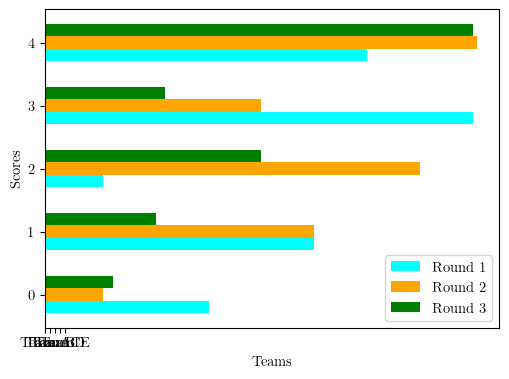

In [569]:
# create data 
x = np.arange(len(channels))  # the label locations
width = 0.25  # the width of the bars
x = np.arange(5) 
y1 = [34, 56, 12, 89, 67] 
y2 = [12, 56, 78, 45, 90] 
y3 = [14, 23, 45, 25, 89] 
width = 0.2
  
# plot data in grouped manner of bar type 
plt.barh(x-0.2, y1, width, color='cyan') 
plt.barh(x, y2, width, color='orange') 
plt.barh(x+0.2, y3, width, color='green') 
plt.xticks(x, ['Team A', 'Team B', 'Team C', 'Team D', 'Team E']) 
plt.xlabel("Teams") 
plt.ylabel("Scores") 
plt.legend(["Round 1", "Round 2", "Round 3"]) 
plt.show() 

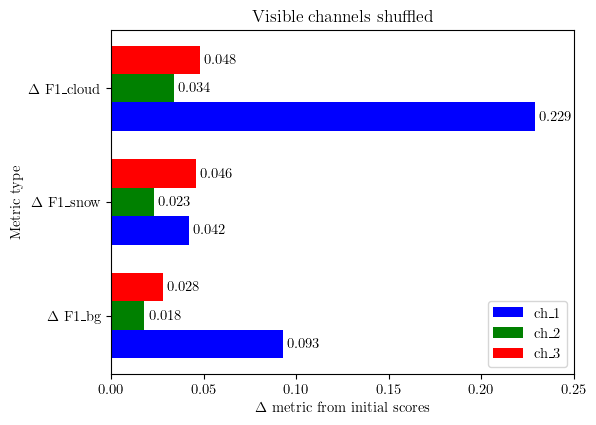

{'ch_1': (0.093, 0.042, 0.229),
 'ch_2': (0.018, 0.023, 0.034),
 'ch_3': (0.028, 0.046, 0.048)}

In [573]:
channels = ('$\Delta $ F1_bg', '$\Delta $ F1_snow', '$\Delta $ F1_cloud')
colors = ['blue', 'green', 'red']
ch_means = {
    'ch_1': (
            np.round(torch.mean(d_F1_sep_N_ch1, dim = 0)[0].numpy(),3),
            np.round(torch.mean(d_F1_sep_N_ch1, dim=0)[1].numpy(),3),
            np.round( torch.mean(d_F1_sep_N_ch1, dim=0)[2].numpy(),3)),
    'ch_2': (
            np.round(torch.mean(d_F1_sep_N_ch2, dim = 0)[0].numpy(),3),
            np.round(torch.mean(d_F1_sep_N_ch2, dim=0)[1].numpy(),3),
            np.round( torch.mean(d_F1_sep_N_ch2, dim=0)[2].numpy(),3)),
    'ch_3': (
            np.round(torch.mean(d_F1_sep_N_ch3, dim = 0)[0].numpy(),3),
            np.round(torch.mean(d_F1_sep_N_ch3, dim=0)[1].numpy(),3),
            np.round( torch.mean(d_F1_sep_N_ch3, dim=0)[2].numpy(),3))
}

x = np.arange(len(channels))  # the label locations
width = 0.25  # the width of the bars
multiplier = -1
color_i=0
fig, ax = plt.subplots(layout='constrained')

for attribute, measurement in ch_means.items():
    offset = width * multiplier
    rects = ax.barh(x + offset, measurement, width, label=attribute, color=colors[color_i])
#     dummy_bar = ax.barh(" ", 0, color='none')
    ax.bar_label(rects, padding=3)
    multiplier += 1
    color_i+=1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_yticks(np.arange(3),labels = ['$\Delta $ F1_bg', '$\Delta $ F1_snow', '$\Delta $ F1_cloud'])
# ax.set_xticks(x + width, species)
ax.legend(loc='upper left', ncols=3)
ax.set_xlim(0, 0.25)
ax.set_title('Visible channels shuffled')
ax.set_ylabel('Metric type')
ax.set_xlabel('$\Delta $ metric from initial scores')
plt.legend()
plt.show()
ch_means

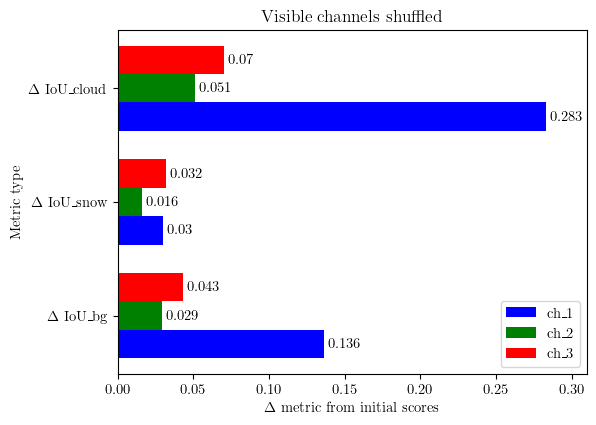

{'ch_1': (0.136, 0.03, 0.283),
 'ch_2': (0.029, 0.016, 0.051),
 'ch_3': (0.043, 0.032, 0.07)}

In [577]:
channels = ('$\Delta $ IoU_bg', '$\Delta $ IoU_snow', '$\Delta $ IoU_cloud')
colors = ['blue', 'green', 'red']
ch_means = {
    'ch_1': (
            np.round(torch.mean(d_IoU_sep_N_ch1, dim = 0)[0].numpy(),3),
            np.round(torch.mean(d_IoU_sep_N_ch1, dim=0)[1].numpy(),3),
            np.round( torch.mean(d_IoU_sep_N_ch1, dim=0)[2].numpy(),3)),
    'ch_2': (
            np.round(torch.mean(d_IoU_sep_N_ch2, dim = 0)[0].numpy(),3),
            np.round(torch.mean(d_IoU_sep_N_ch2, dim=0)[1].numpy(),3),
            np.round( torch.mean(d_IoU_sep_N_ch2, dim=0)[2].numpy(),3)),
    'ch_3': (
            np.round(torch.mean(d_IoU_sep_N_ch3, dim = 0)[0].numpy(),3),
            np.round(torch.mean(d_IoU_sep_N_ch3, dim=0)[1].numpy(),3),
            np.round( torch.mean(d_IoU_sep_N_ch3, dim=0)[2].numpy(),3))
}

x = np.arange(len(channels))  # the label locations
width = 0.25  # the width of the bars
multiplier = -1
color_i=0
fig, ax = plt.subplots(layout='constrained')

for attribute, measurement in ch_means.items():
    offset = width * multiplier
    rects = ax.barh(x + offset, measurement, width, label=attribute, color=colors[color_i])
#     dummy_bar = ax.barh(" ", 0, color='none')
    ax.bar_label(rects, padding=3)
    multiplier += 1
    color_i+=1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_yticks(np.arange(3),labels = ['$\Delta $ IoU_bg', '$\Delta $ IoU_snow', '$\Delta $ IoU_cloud'])
# ax.set_xticks(x + width, species)
ax.legend(loc='upper left', ncols=3)
ax.set_xlim(0, 0.31)
ax.set_title('Visible channels shuffled')
ax.set_ylabel('Metric type')
ax.set_xlabel('$\Delta $ metric from initial scores')
plt.legend()
plt.show()
ch_means

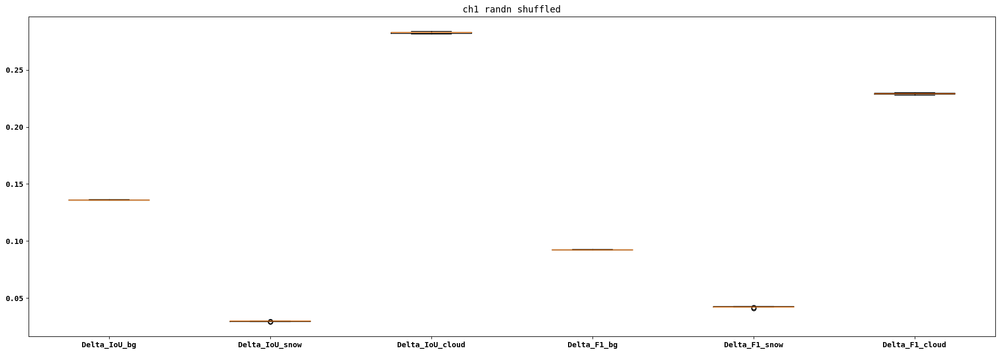

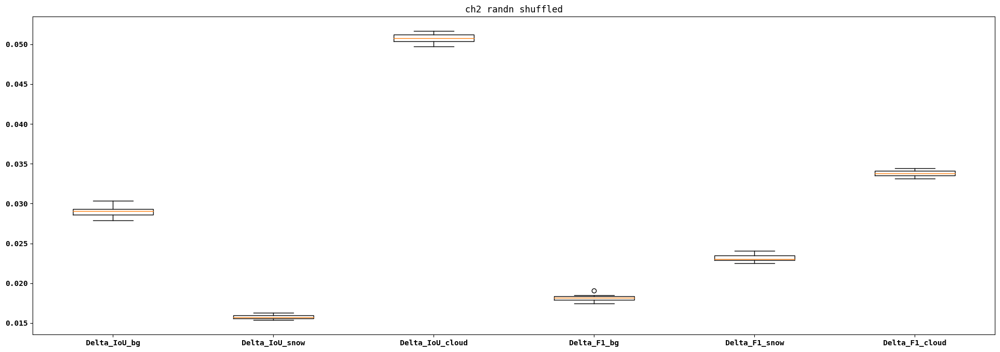

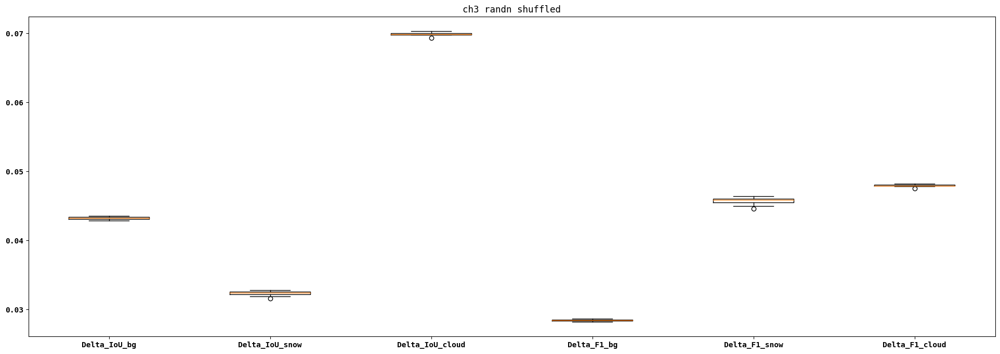

In [483]:
dicts_stack = [dict_deltas_ch1,dict_deltas_ch2,dict_deltas_ch3]
titles=["ch1 randn shuffled","ch2 randn shuffled","ch3 randn shuffled"]
for i in range(len(dicts_stack)):
    fig, ax = plt.subplots(1,1, figsize=(24,8))
    ax.boxplot(pd.DataFrame(dicts_stack[i]))
    ax.set_xticklabels(['Delta_IoU_bg', 'Delta_IoU_snow','Delta_IoU_cloud','Delta_F1_bg', 'Delta_F1_snow','Delta_F1_cloud'])
    ax.set_title(titles[i])
plt.show()

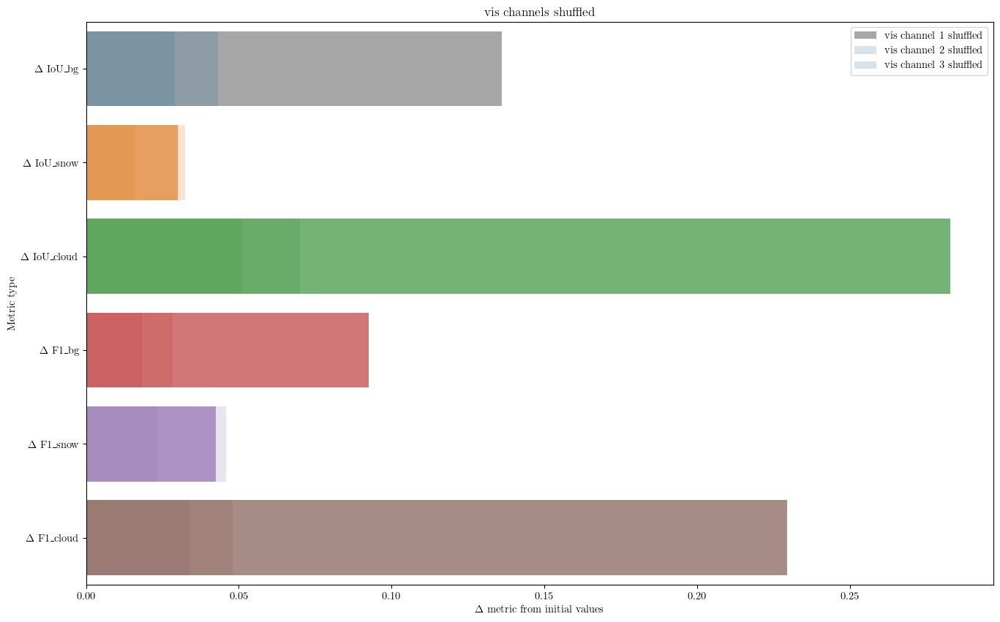

In [526]:
# Use a Different Error Bar Calculation
import seaborn as sns
plt.figure(figsize = (16,10))
ax = sns.barplot(data=df_deltas_ch1, alpha = 0.7, ci=None, label = 'vis channel 1 shuffled',orient ='h')
ax.patches[0].set_facecolor('green')
ax = sns.barplot(data=df_deltas_ch2, alpha = 0.2, ci=None, label = 'vis channel 2 shuffled',orient ='h')
ax.patches[0].set_facecolor('red')
ax = sns.barplot(data=df_deltas_ch3, alpha = 0.2, ci=None, label = 'vis channel 3 shuffled',orient ='h')
ax.patches[0].set_facecolor('grey')
ax.set_title('vis channels shuffled')
ax.set_ylabel('Metric type')
ax.set_xlabel('$\Delta $ metric from initial values')
plt.legend()
plt.show()

In [525]:
from matplotlib.patches import Patch
import matplotlib.ticker as ticker
datasets = [pd.DataFrame(dict_deltas_ch1),pd.DataFrame(dict_deltas_ch2),pd.DataFrame(dict_deltas_ch3)]
# Make figures A6 in size
plt.figure(figsize=(24,20))
A = 6
plt.rc('figure', figsize=[46.82 * .5**(.5 * A), 33.11 * .5**(.5 * A)])
# Use Latex
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Define which colours you want to use
colours = ['blue', 'red','green']

# Set x-positions for boxes
x_pos_range = np.arange(len(datasets)) / (len(datasets) - 1)
x_pos = (x_pos_range * 0.5) + 0.75
# Plot
for i, data in enumerate(datasets):
    positions = [x_pos[i] + j * 1 for j in range(len(data.T))]
    bp = plt.bar(
        np.array(data), sym='', whis=[0, 100], widths=0.6 / len(datasets),
        labels=list(datasets[0]), patch_artist=True,
        positions=positions
    )
    # Fill the boxes with colours (requires patch_artist=True)
    k = i % len(colours)
    for box in bp['boxes']:
        box.set(facecolor=colours[k])
    # Make the median lines more visible
    plt.setp(bp['medians'], color='black')
# Titles
plt.title('Metric')
plt.ylabel('$\Delta $ metric value')
# Axis ticks and labels
plt.xticks(np.arange(len(list(datasets[0]))) + 1)
plt.gca().xaxis.set_minor_locator(ticker.FixedLocator(
    np.array(range(len(list(datasets[0])) + 1)) + 0.5)
)
plt.gca().tick_params(axis='x', which='minor', length=4)
plt.gca().tick_params(axis='x', which='major', length=0)
# Change the limits of the x-axis
plt.xlim([0.5, len(list(datasets[0])) + 0.5])
# Define the groups
groups = ['ch1 shuffled', 'ch2 shuffled', 'ch3 shuffled']
legend_elements = []
for i in range(len(datasets)):
    j = i % len(groups)
    k = i % len(colours)
    legend_elements.append(Patch(facecolor=colours[k], label=groups[j]))

plt.axvline(1.5, color='black', alpha=0.4)
plt.axvline(2.5, color='black', alpha=0.4)
plt.axvline(3.5, color='black', alpha=0.4)
plt.axvline(4.5, color='black', alpha=0.4)
plt.axvline(5.5, color='black', alpha=0.4)
plt.axvline(6.5, color='black', alpha=0.4)
plt.axvline(7.5, color='black', alpha=0.4)
plt.axvline(8.5, color='black', alpha=0.4)
g1 = plt.gca().scatter(0, 0.56, color='b')
g2 = plt.gca().scatter(0, 0.56, color='r')
g3 = plt.gca().scatter(0, 0.56, color='g')
plt.gca().legend([g1, g2, g3], groups, loc = 'upper left')
plt.legend(handles=legend_elements, fontsize=16, loc = 'upper left')
plt.show()

TypeError: bar() missing 1 required positional argument: 'height'

<Figure size 2400x2000 with 0 Axes>

## HUGE TRAINING PIPELINE

**CREATE A DATASET WITH ELECTRO L2 with masks from GOES & METEOSAT for training**

In [169]:
class ELECTRO_L2_Dataset_finetunning(Dataset):
    def __init__(self, stack_dir_list,aux_dir, pytorch=True, include_BT = True,nonempty_mode = True):
        super().__init__()
        self.pytorch = pytorch   
        self.nonempty_mode = nonempty_mode
        self.include_BT = include_BT
        self.stack_dir_list = stack_dir_list
        self.non_empty_list = []
        self.snowy_list = []
        self.stack_dirs = []
        self.stack_dirs_BT = []
        self.all_snow_flags = []
        self.non_empty_snow_idxs = []
        self.non_empty_aux = []
        self.aux_dir = aux_dir
        total_len = 0
        for i in range(len(self.stack_dir_list)): # iterate over number of pictures in dataset (18 now)
            stack_dir = self.stack_dir_list[i]
            stack_dir_BT = self.stack_dir_list[i].replace('rgb', 'BT').replace('folder_ZSA','folder_BT')
            non_empty_idxs_dir = self.stack_dir_list[i].replace('all_patch_folder_ZSA','nonempty_idxs_folder')
            non_empty_idxs_dir = non_empty_idxs_dir.replace('patches_rgb','nonempty_idxs')
            snowy_idxs_dir = non_empty_idxs_dir.replace('nonempty_idxs_folder_ZSA', 'snowy_idxs_folder')
            snowy_idxs_dir = snowy_idxs_dir.replace('nonempty', 'snowy')
            snow_flag_array = np.load(snowy_idxs_dir+'.npy')
            self.all_snow_flags.append(snow_flag_array)
            if self.nonempty_mode:
                non_empty_idxs = np.load(non_empty_idxs_dir+'.npy')
                snow_idxs_nonempty = np.zeros(len(snow_flag_array))
                snow_idxs_nonempty[non_empty_idxs]=1
                snow_idxs_nonempty = (snow_idxs_nonempty*snow_flag_array).astype(np.uint8)
                for j in range(len(non_empty_idxs)):
                    idx_ = non_empty_idxs[j]
                    if snow_idxs_nonempty[idx_] == 1:
                        self.non_empty_snow_idxs.append(total_len+j)
                    patch_file = f"{stack_dir}/patch_{idx_}.tif"
                    self.stack_dirs.append(patch_file)
                    patch_file_BT = f"{stack_dir_BT}/patch_{idx_}.tif"
                    self.stack_dirs_BT.append(patch_file_BT)
                    self.non_empty_aux.append(idx_)
                total_len = total_len+len(non_empty_idxs)
            else:
                patch_files = glob.glob(stack_dir+'/*')
                patch_files_BT = glob.glob(stack_dir_BT+'/*')
                for patch_file in patch_files:
                    self.stack_dirs.append(patch_file)
                for patch_file_BT in patch_files_BT:
                    self.stack_dirs_BT.append(patch_file_BT) 
        self.all_snow_flags_nonempty =np.zeros(total_len).astype(np.uint8)
        self.all_snow_flags_nonempty[self.non_empty_snow_idxs]=1
        self.all_snow_flags = np.array(self.all_snow_flags).flatten()
        
    def __len__(self):
        num_patches = int((len(self.stack_dirs))) 
        return num_patches
    
    def open_rgb_normed(self, idx, invert=False):
        patch_file = self.stack_dirs[idx]
        patch = tff.imread(patch_file)
        r,g,b = patch[:,:,0]/255, patch[:,:,1]/255, patch[:,:,2]/255
        patch_normed  = np.dstack([b, g ,r])
        return patch_normed 
    
    def open_BT_normed(self, idx, invert=False):
        patch_file_BT = self.stack_dirs_BT[idx]
        patch_BT = tff.imread(patch_file_BT)
        return patch_BT 
    
    def open_aux(self, idx, invert=False):
        patch_file = self.aux_dir+'/patch_'+str(self.non_empty_aux[idx])+'.tif'
        patch = tff.imread(patch_file)
        lon,lat,dem = patch[:,:,0],patch[:,:,1],patch[:,:,2]
        lon,lat = (lon+180.0)/360.0,(lat+90.0)/180.0
        dem = dem/10000
        lonlatdem_normed = np.dstack([lon,lat,dem])
        return lonlatdem_normed
    
    def open_mask(self, idx):
        patch_file = self.stack_dirs[idx]
        mask_file = patch_file.replace('rgb','masks').replace('tif','jpg').replace('all_patch_folder_ZSA','all_masks_folder')
        mask = tff.imread(mask_file)
        snow_mask = mask[:,:,1]//255 #  1 - snow class
        cloud_mask = mask[:,:,0] # 2 - cloud class
        cloud_mask[cloud_mask!=0] = 2
        bg = mask[:,:,2]
        bin_mask = snow_mask + cloud_mask
        return bin_mask
    
    def open_as_pil(self, idx):
        patch_file = self.stack_dirs[idx]
        patch_image = tff.imread(patch_file)
        return patch_image 
    
    def __getitem__(self, idx):
        patch_file = self.stack_dirs[idx]
        mask_file = patch_file.replace('rgb','masks').replace('tif','jpg').replace('all_patch_folder_ZSA','all_masks_folder')
        mask = tff.imread(mask_file)
        snow_mask = mask[:,:,1]//255 #  1 - snow class
        cloud_mask = mask[:,:,0] # 2 - cloud class
        cloud_mask[cloud_mask!=0]=2
        bin_mask = snow_mask+cloud_mask
        patch = tff.imread(patch_file)
        r,g,b = patch[:,:,0]/255, patch[:,:,1]/255, patch[:,:,2]/255
        aux_file = self.aux_dir+'/patch_'+str(self.non_empty_aux[idx])+'.tif'
        aux = tff.imread(aux_file)
        lon,lat,dem = aux[:,:,0],aux[:,:,1],aux[:,:,2]
        lon,lat = (lon+180.0)/360.0,(lat+90.0)/180.0
        dem = dem/10000
        aux_normed = np.stack([lon, lat, dem])
        patch_normed  = np.stack([b, g ,r])
        if self.include_BT:
            patch_file_BT = self.stack_dirs_BT[idx] 
            BT_normed = tff.imread(patch_file_BT).transpose(2,0,1)
            full_stack = np.concatenate((patch_normed, BT_normed, aux_normed), axis=0)
            # order of channels: b, g, r, BT4, BT5, BT6, BT7, BT8, BT9, lon, lat, dem
            full_stack = torch.tensor(full_stack, dtype=torch.float32)
        else:
            full_stack = np.concatenate((patch_normed, aux_normed), axis=0)
            full_stack = torch.tensor(full_stack, dtype=torch.float32)
        return full_stack, torch.tensor(bin_mask).long()#, patch_file,mask_file

**CHECK on 1 DIR THAT EVERYTHING WORKS FINE in DATASET CLASS**

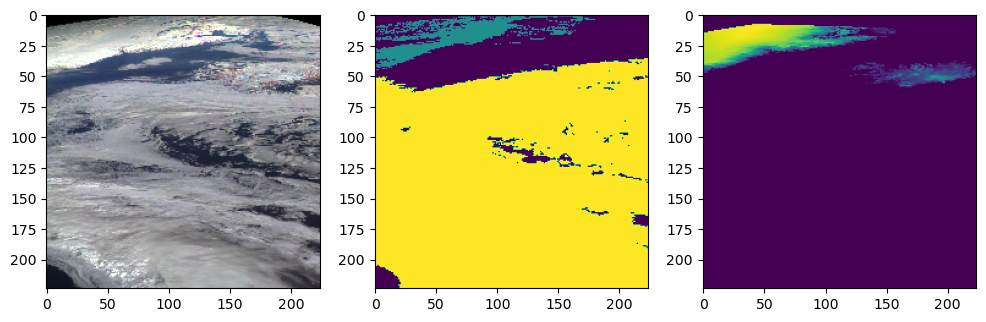

number of snowy patches in ds 3
snowy_weight = 0.9747899159663865 bg_weight = 0.025210084033613446
number of non-empty patches in ds 119
number of non-empty snowy patches in ds 3
total number of patches in ds 144
patch_shape in ds : torch.Size([12, 224, 224])


(119,
 [4, 5, 97],
 'H:\\ELECTRO_DATASET\\4_km_res\\L2\\all_patch_folder_ZSA\\patches_rgb_electro_l2_20211015_1200/patch_5.tif',
 'H:\\ELECTRO_DATASET\\4_km_res\\L2\\all_masks_folder\\patches_masks_electro_l2_20211015_1200/patch_5.jpg')

In [30]:
stack_dir_list = [r'H:\ELECTRO_DATASET\4_km_res\L2\all_patch_folder_ZSA\patches_rgb_electro_l2_20211015_1200']
aux_dir = r'H:\ELECTRO_DATASET\4_km_res\L2\lon_lat_dem'
Electro_ds = ELECTRO_L2_Dataset_finetunning(stack_dir_list=stack_dir_list,aux_dir = aux_dir,nonempty_mode = True, include_BT = True)
SAMPLE_INDX = 2
x_rgb_lonlat, mask, patch_file,mask_file = Electro_ds[SAMPLE_INDX]
fig, ax = plt.subplots(1,3, figsize=(12,4))
rgb_im = (np.dstack([x_rgb_lonlat[2],x_rgb_lonlat[1],x_rgb_lonlat[0]])*255).astype(np.uint8)
ax[0].imshow(rgb_im)
ax[1].imshow(mask)
ax[2].imshow(x_rgb_lonlat[-1])
# can be used alternatively
# ax[0].imshow(Electro_ds.open_as_pil(SAMPLE_INDX))
# ax[1].imshow(Electro_ds.open_mask(SAMPLE_INDX))
# ax[2].imshow(Electro_ds.open_aux(SAMPLE_INDX)[:,:,-1])
plt.show()
num_snow_patches = np.sum(Electro_ds.all_snow_flags)
print('number of snowy patches in ds',num_snow_patches)
non_empty_snow_patches_idxs = Electro_ds.non_empty_snow_idxs
num_non_empty_snow_patches = len(non_empty_snow_patches_idxs)
bg_weight = num_non_empty_snow_patches/len(Electro_ds)
snowy_weight = 1- num_non_empty_snow_patches/len(Electro_ds)
print('snowy_weight =',snowy_weight, 'bg_weight =',bg_weight)
print('number of non-empty patches in ds',len(Electro_ds))
print('number of non-empty snowy patches in ds',len(non_empty_snow_patches_idxs))
print('total number of patches in ds',len(Electro_ds.all_snow_flags))
print('patch_shape in ds :',x_rgb_lonlat.shape)
ids_of_snow_patches = []
for ind in range(len(Electro_ds.all_snow_flags)):
    if Electro_ds.all_snow_flags[ind] == 1:
        ids_of_snow_patches.append(ind)
len(Electro_ds.all_snow_flags_nonempty),ids_of_snow_patches,patch_file,mask_file

### SAVE SNOWY PATCHES FOR HUMAN LABELLING


100%|████████████████████████████████████████████████████████████████████████████████| 142/142 [01:08<00:00,  2.08it/s]


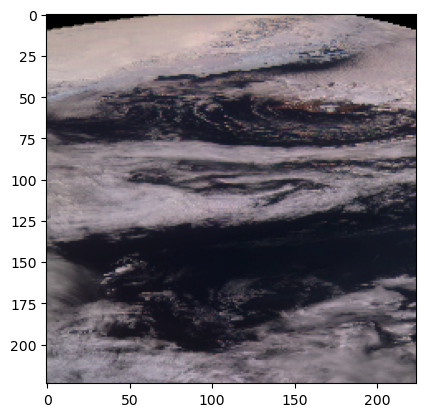

In [57]:
stack_dir_lists = glob.glob(r'H:/ELECTRO_DATASET/4_km_res/L2/all_patch_folder_ZSA/*')
aux_dir = r'H:\ELECTRO_DATASET\4_km_res\L2\lon_lat_dem'
for dir_l2 in tqdm(stack_dir_lists):
    dir_l2_repl = dir_l2.replace('all_patch_folder_ZSA','for_mannually_labelling/snowy_patches')
    mask_dir = dir_l2.replace('all_patch_folder_ZSA','all_masks_folder').replace('rgb','masks')
    mask_dir_repl = mask_dir.replace('all_masks_folder','for_mannually_labelling/masks')
    if not os.path.exists(dir_l2_repl):
        os.makedirs(dir_l2_repl)
    if not os.path.exists(mask_dir_repl):
        os.makedirs(mask_dir_repl)
    Electro_ds = ELECTRO_L2_Dataset_finetunning(stack_dir_list=[dir_l2],aux_dir = aux_dir,nonempty_mode = True, include_BT = True)
    ids_of_snow_patches = []
    for ind in range(len(Electro_ds.all_snow_flags)):
        if Electro_ds.all_snow_flags[ind] == 1:
            ids_of_snow_patches.append(ind)
    for ind in ids_of_snow_patches:
        patch_file = dir_l2+'/patch_'+str(ind)+'.tif'
        mask_file = patch_file.replace('rgb','masks').replace('tif','jpg').replace('all_patch_folder_ZSA','all_masks_folder')
        patch_file2save = patch_file.replace('all_patch_folder_ZSA','for_mannually_labelling/snowy_patches')
        mask_file2save = mask_file.replace('all_masks_folder','for_mannually_labelling/masks')
        patch = tff.imread(patch_file)
        mask = tff.imread(mask_file)
        plt.imshow(patch)
#         if not os.path.exists(mask_file2save):
#             os.makedirs(mask_file2save)
#         if not os.path.exists(patch_file2save):
#             os.makedirs(patch_file2save)
        tff.imsave(patch_file2save, patch)
        tff.imsave(mask_file2save, mask)
        

# SAMPLE_INDX = 2
# x_rgb_lonlat, mask = Electro_ds[SAMPLE_INDX]
# fig, ax = plt.subplots(1,3, figsize=(12,4))
# rgb_im = (np.dstack([x_rgb_lonlat[2],x_rgb_lonlat[1],x_rgb_lonlat[0]])*255).astype(np.uint8)
# tff.imsave(merged_mask_file_name_cloud, x_rgb_lonlat)
# tff.imsave(merged_mask_file_name_cloud, mask)
# ax[0].imshow(rgb_im)
# ax[1].imshow(mask)
# ax[2].imshow(x_rgb_lonlat[-1])
# # can be used alternatively
# # ax[0].imshow(Electro_ds.open_as_pil(SAMPLE_INDX))
# # ax[1].imshow(Electro_ds.open_mask(SAMPLE_INDX))
# # ax[2].imshow(Electro_ds.open_aux(SAMPLE_INDX)[:,:,-1])
# plt.show()
# num_snow_patches = np.sum(Electro_ds.all_snow_flags)
# print('number of snowy patches in ds',num_snow_patches)
# non_empty_snow_patches_idxs = Electro_ds.non_empty_snow_idxs
# num_non_empty_snow_patches = len(non_empty_snow_patches_idxs)
# bg_weight = num_non_empty_snow_patches/len(Electro_ds)
# snowy_weight = 1- num_non_empty_snow_patches/len(Electro_ds)
# print('snowy_weight =',snowy_weight, 'bg_weight =',bg_weight)
# print('number of non-empty patches in ds',len(Electro_ds))
# print('number of non-empty snowy patches in ds',len(non_empty_snow_patches_idxs))
# print('total number of patches in ds',len(Electro_ds.all_snow_flags))
# print('patch_shape in ds :',x_rgb_lonlat.shape)
# ids_of_snow_patches =[]
# for ind in range(len(Electro_ds.all_snow_flags)):
#     if Electro_ds.all_snow_flags[ind] == 1:
#         ids_of_snow_patches.append(ind)
# len(Electro_ds.all_snow_flags_nonempty),ids_of_snow_patches

In [166]:
#SPLIT DIRS TO TRAIN/VAL/TEST
stack_dir = glob.glob(r'H:\ELECTRO_DATASET\4_km_res\L2\all_patch_folder_ZSA\*')
stack_dir_train = []
stack_dir_valtest = []
stack_dir_val = []
stack_dir_test = []
for i in range(len(stack_dir)):
    dir_date = stack_dir[i]
    if ('_2021' in dir_date) or ('_2023' in dir_date):
        stack_dir_valtest.append(dir_date)
    else: stack_dir_train.append(dir_date)
valtest_dir_len = len(stack_dir_valtest)
stack_dir_val = stack_dir_valtest[:valtest_dir_len//2]
stack_dir_test = stack_dir_valtest[valtest_dir_len//2:]
len(stack_dir_train), len(stack_dir_val), len(stack_dir_test)

(112, 15, 15)

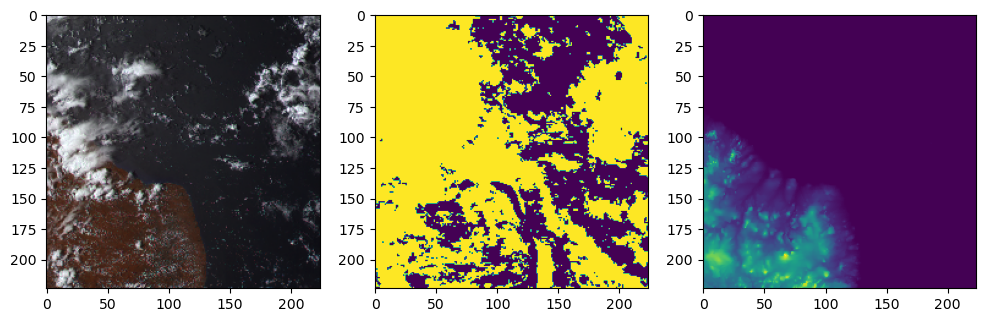

number of snowy patches in ds 586
snowy_weight = 0.9572482822970566 bg_weight = 0.04275171770294342
number of non-empty patches in ds 11789
number of non-empty snowy patches in ds 504
total number of patches in ds 16128
patch_shape in ds : torch.Size([12, 224, 224])


(11789, 1687, 1590)

In [170]:
aux_dir = r'H:\ELECTRO_DATASET\4_km_res\L2\lon_lat_dem'
Electro_ds_full_tr = ELECTRO_L2_Dataset_finetunning(stack_dir_list=stack_dir_train,aux_dir = aux_dir,nonempty_mode = True, include_BT = True)
Electro_ds_full_val = ELECTRO_L2_Dataset_finetunning(stack_dir_list=stack_dir_val,aux_dir = aux_dir,nonempty_mode = True, include_BT = True)
Electro_ds_full_test = ELECTRO_L2_Dataset_finetunning(stack_dir_list=stack_dir_test,aux_dir = aux_dir,nonempty_mode = True, include_BT = True)
SAMPLE_INDX = 2352
x_rgb_lonlat, mask = Electro_ds_full_tr[SAMPLE_INDX]
fig, ax = plt.subplots(1,3, figsize=(12,4))
ax[0].imshow(Electro_ds_full_tr.open_as_pil(SAMPLE_INDX))
ax[1].imshow(Electro_ds_full_tr.open_mask(SAMPLE_INDX))
ax[2].imshow(Electro_ds_full_tr.open_aux(SAMPLE_INDX)[:,:,-1])
plt.show()
num_snow_patches = np.sum(Electro_ds_full_tr.all_snow_flags)
print('number of snowy patches in ds',num_snow_patches)
non_empty_snow_patches_idxs = Electro_ds_full_tr.non_empty_snow_idxs
num_non_empty_snow_patches = len(non_empty_snow_patches_idxs)
bg_weight = num_non_empty_snow_patches/len(Electro_ds_full_tr)
snowy_weight = 1- num_non_empty_snow_patches/len(Electro_ds_full_tr)
print('snowy_weight =',snowy_weight, 'bg_weight =',bg_weight)
print('number of non-empty patches in ds',len(Electro_ds_full_tr))
print('number of non-empty snowy patches in ds',len(non_empty_snow_patches_idxs))
print('total number of patches in ds',len(Electro_ds_full_tr.all_snow_flags))
print('patch_shape in ds :',x_rgb_lonlat.shape)
len(Electro_ds_full_tr.all_snow_flags_nonempty), len(Electro_ds_full_val), len(Electro_ds_full_test)

snow_pix_sum = 4809


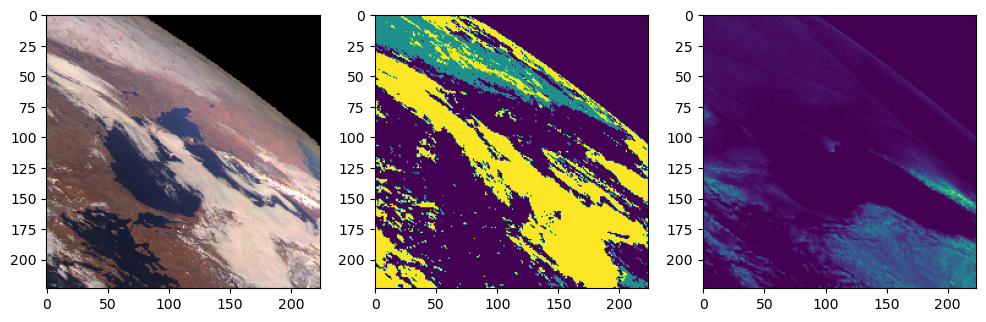

snow_pix_sum = 787


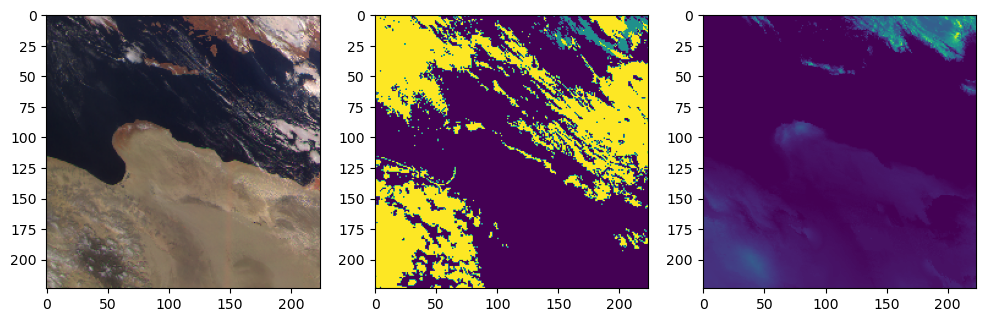

In [171]:
for SAMPLE_INDX in non_empty_snow_patches_idxs[40:42]:
    x_rgb_lonlat, mask = Electro_ds_full_tr[SAMPLE_INDX]
    snow_mask = mask.numpy().copy()
    snow_mask[snow_mask!=1]=0
    snow_pix_sum = np.sum(snow_mask)
    print('snow_pix_sum =', snow_pix_sum)
    fig, ax = plt.subplots(1,3, figsize=(12,4))
    ax[0].imshow(Electro_ds_full_tr.open_as_pil(SAMPLE_INDX))
    ax[1].imshow(Electro_ds_full_tr.open_mask(SAMPLE_INDX))
    ax[2].imshow(Electro_ds_full_tr.open_aux(SAMPLE_INDX)[:,:,-1])
    plt.show()

**DEFINE A PIPELINE CLASS OF GEOMETRIC TRANSFORM ON GPU USING Kornia**

In [172]:
import kornia as K
from kornia.augmentation.container import AugmentationSequential
class Geom_Augmentation(nn.Module):
    def __init__(self):
        super(Geom_Augmentation, self).__init__()
        # we define and cache our operators as class members
        # NEED TO UNDERSTAND GEOM AUGS PARAMS To MAKE IT ACCEPTABLE!
        self.augs = AugmentationSequential(
                    RandomVerticalFlip(p=1),
                    RandomHorizontalFlip(p=1),
                    RandomPerspective(0.25, sampling_method = 'area_preserving', p=1.),
                    RandomAffine(degrees =(-85.0,85.0),translate = None,scale = (0.9, 1.1),resample="nearest",shear = None,padding_mode="reflection",align_corners=True,same_on_batch=False,keepdim=True,p=1),
                    RandomElasticTransform(kernel_size=(33, 33), sigma=(6.0, 6.0), alpha=(1.0, 1.0), align_corners=True, resample='nearest', padding_mode='reflection', same_on_batch=False, p=1.0, keepdim=True),
                    data_keys=['input', 'mask'], same_on_batch = False, random_apply = 2)                       
    def forward(self, img: torch.Tensor, mask: torch.Tensor) -> torch.Tensor:
        # 2. apply geometric tranform
        out = self.augs(img, mask)
        img_out, mask_out = out[0],out[1]
        return img_out, mask_out
geom_augs = Geom_Augmentation()

64


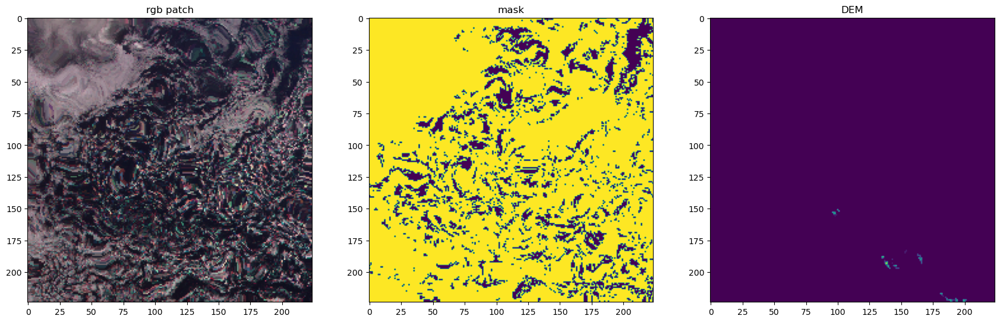

485


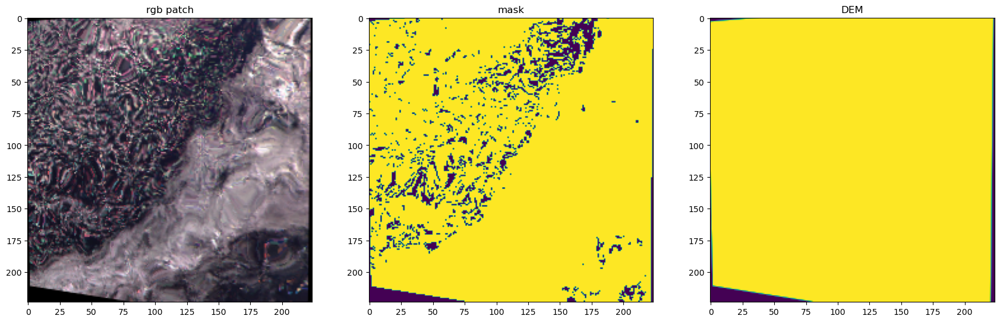

1546


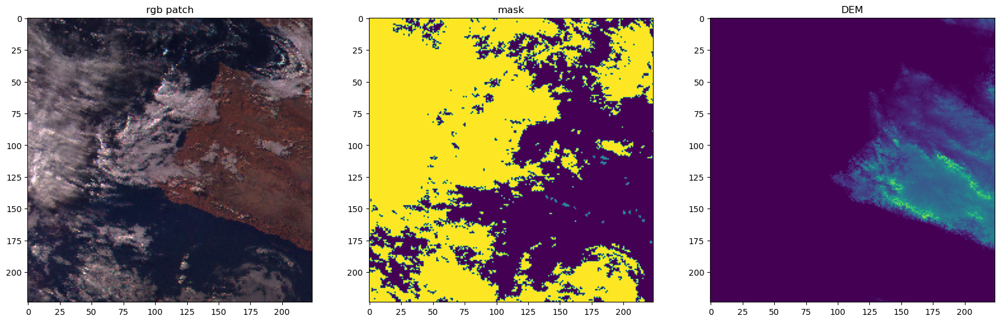

In [173]:
def open_sample_as_pil_no_norm(datacube):
    inversed_rgb = (datacube[0:3])
    rgb = np.dstack((inversed_rgb[2,:,:],inversed_rgb[1,:,:],inversed_rgb[0,:,:]))*255
    return rgb.astype('uint8')
def open_DEM(datacube):
    dem_arr = datacube[-1]
    return dem_arr.numpy()#.astype('uint8')
def open_mask_as_pil(seglabel):
    mask = (seglabel.numpy())
    return mask
for idx in range(230,233):
    datacube, seglabel = Electro_ds_full_tr[idx]
    seglabel = seglabel.unsqueeze(0).unsqueeze(0)
    # APPLY GEOM AUGS
    datacube, seglabel = geom_augs(datacube, seglabel.type(torch.float32))
    # NEED TO UNDERSTAND GEOM AUGS PARAMS To MAKE IT ACCEPTABLE!
    datacube, seglabel = datacube.squeeze(0), seglabel.squeeze(0).squeeze(0)
    print(len(np.unique(open_DEM(datacube.cpu()))))
    fig, ax = plt.subplots(1,3, figsize=(21,7))
    ax[0].imshow(open_sample_as_pil_no_norm(datacube.cpu()))
    ax[1].imshow(open_mask_as_pil(seglabel.cpu()))
    ax[2].imshow(open_DEM(datacube.cpu()))
    ax[0].set_title('rgb patch')
    ax[1].set_title('mask')
    ax[2].set_title('DEM')
    plt.show()

**DEM IS OK! INITIAL DEM FILE IS OK --> PATCHES WITH DEM, TOO! IT's JUST SOME STRANGE VISUALIZATION OF PYPLOT! KEEP CALM!**

**USE WEIGHTED SAMPLER TO MAKE DATALOADER MORE BALANCED WITH SNOW PATCHES**

In [174]:
#SAMPLER FOR ELECTRO L2 DS FOR FINETUNNING
from torch.utils.data import WeightedRandomSampler
non_empty_snow_patches_ds = Electro_ds_full_tr.all_snow_flags_nonempty
num_non_empty_snow_patches = len(non_empty_snow_patches_ds)
bg_weight = num_non_empty_snow_patches/len(Electro_ds_full_tr)
snowy_weight = 1-num_non_empty_snow_patches/len(Electro_ds_full_tr)
batch_size = 16
_, counts = torch.unique(torch.tensor(non_empty_snow_patches_ds), return_counts=True)
weights = counts.max() / counts
print("Weights: ", weights)
weights[1] = weights[1]*1.4
weight_for_sampler_l2 = []  # Every sample must have a weight
for snow_flag in non_empty_snow_patches_ds:
    weight_for_sampler_l2.append(weights[snow_flag].item())
print('len(weights):',len(weight_for_sampler_l2), weight_for_sampler_l2[0:20])
sampler_l2 = WeightedRandomSampler(torch.tensor(weight_for_sampler_l2), len(Electro_ds_full_tr))

Weights:  tensor([ 1.0000, 22.3909])
len(weights): 11789 [1.0, 1.0, 1.0, 31.34722137451172, 1.0, 31.34722137451172, 1.0, 1.0, 1.0, 1.0, 31.34722137451172, 31.34722137451172, 31.34722137451172, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


In [175]:
# ELECTRO L2 ds full for finetunning
batch_size = 16 #16 # try to set as max as possible
train_dl_ = DataLoader(Electro_ds_full_tr, batch_size=batch_size, sampler = sampler_l2)
valid_dl_ = DataLoader(Electro_ds_full_val, batch_size=batch_size, shuffle=False)
test_dl_ = DataLoader(Electro_ds_full_test, batch_size=batch_size, shuffle=False)
len(Electro_ds_full_tr),len(Electro_ds_full_val),len(Electro_ds_full_test)

(11789, 1687, 1590)

**TEST DATALOADER SAMPLER FOR SNOWY PATHES**

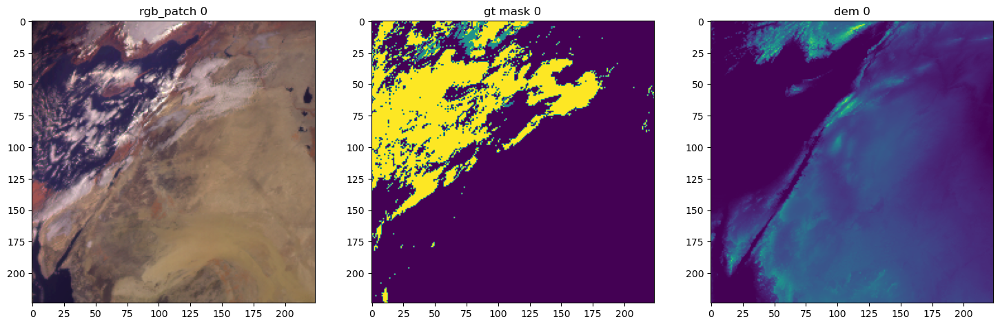

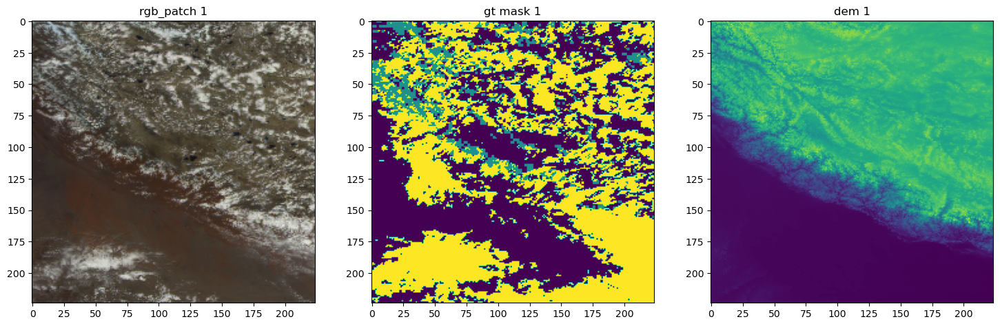

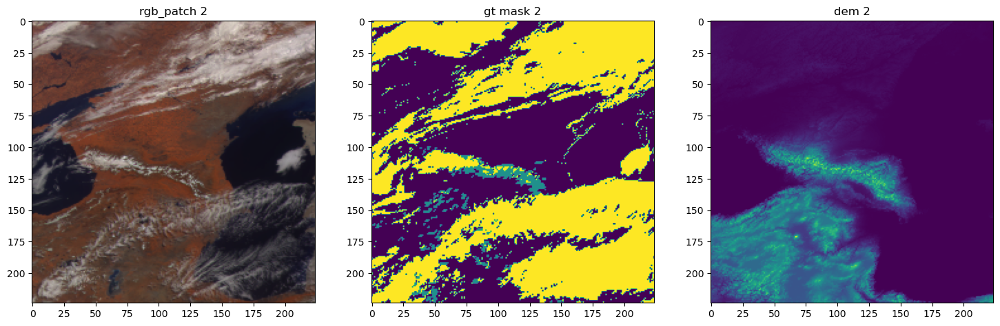

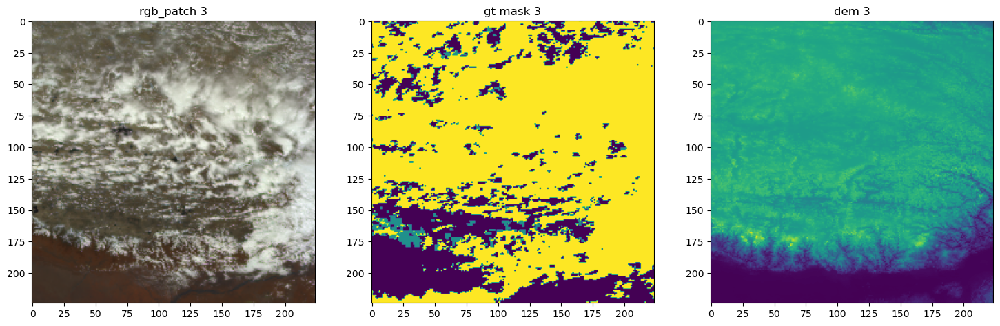

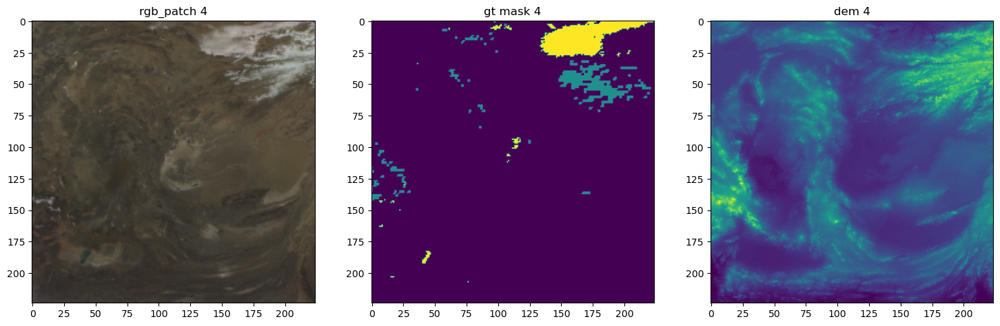

...

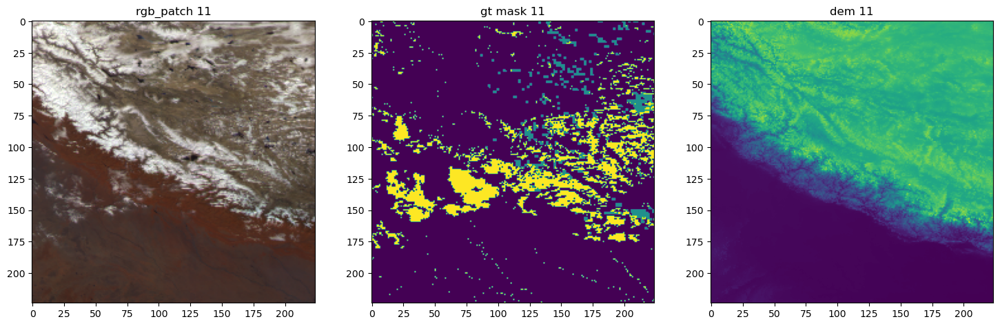

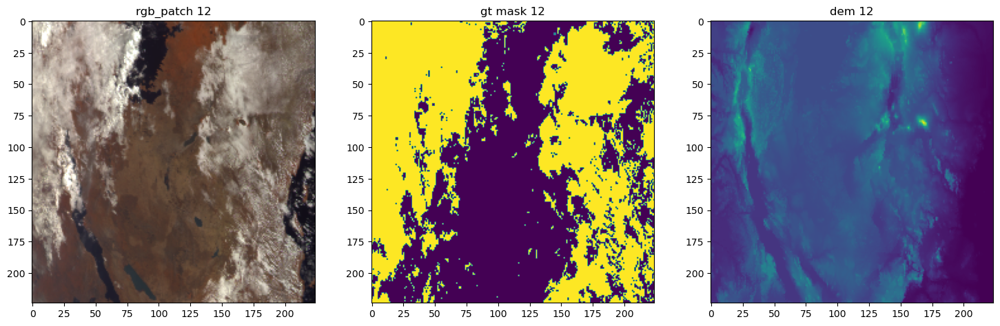

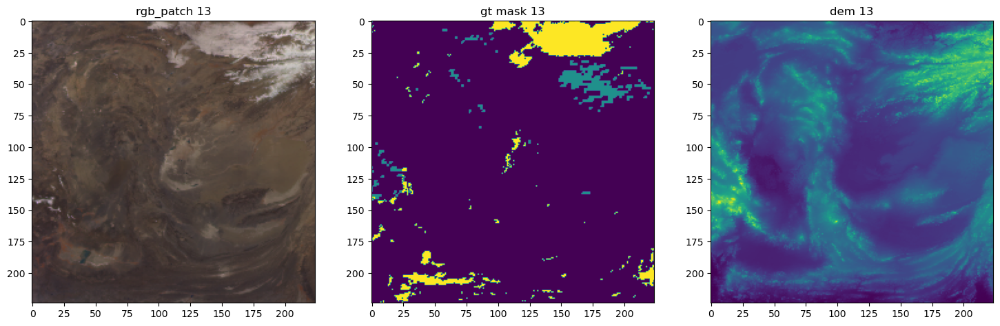

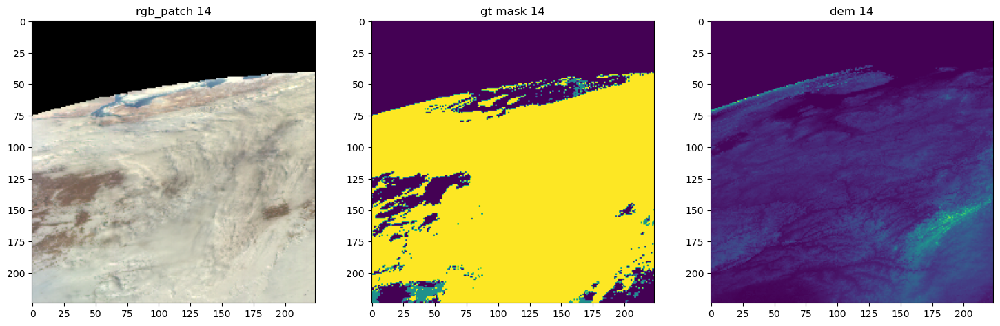

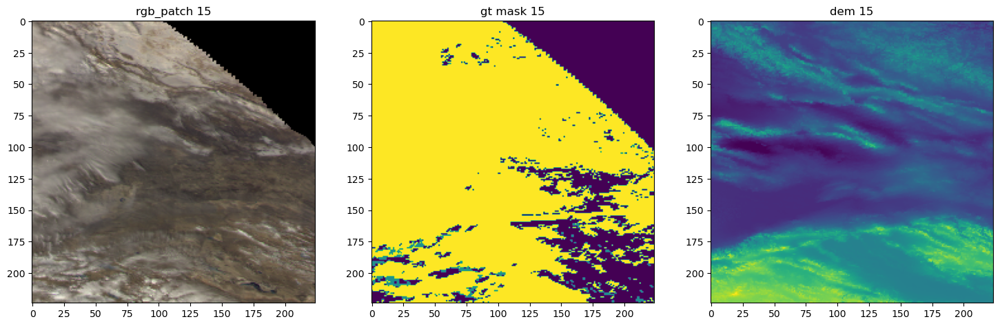

In [26]:
def visualize_dl_sampler(dl, num_batches = 1):
    iterator = iter(dl)
    for j in range(num_batches):
        x,y = next(iterator)
        for i in range(len(x)):
            x_rgb_lonlat,gt = x[i], y[i]#.to(device)
            fig, ax = plt.subplots(1,3, figsize=(18,6))
            ax[0].imshow(open_sample_as_pil_no_norm(x_rgb_lonlat.cpu()))
            ax[1].imshow(open_mask_as_pil(gt.cpu()))
            ax[2].imshow(x_rgb_lonlat[-1].numpy())
            ax[0].set_title('rgb_patch '+str(i))
            ax[1].set_title('gt mask '+str(i))
            ax[2].set_title('dem '+str(i))
            plt.show()
visualize_dl_sampler(dl = train_dl_,num_batches = 1)

**TRY TO USE RANGER21 OPTIMIZER INSTEAD OF ADAMW or ADAMW with COSINE ANNEALING SCHEDULER**

In [176]:
def save_best_model(model,epoch,path =  r'H:/ELECTRO_DATASET/4_km_res/L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_'):
        model_copy = deepcopy(model)
        best_model = model_copy
        best_model_name = path+str(epoch)
        torch.save(best_model.state_dict(),best_model_name)
        print('best model is on epoch =',epoch)
        return best_model
def train_ep(model, train_dataload, valid_dataload, dice, focal,focal_alpha, optimizer,ep_i, best_valid_iou, scheduler =None):    
    model.cuda()#cuda()
    print('epoch_n =',ep_i)
    model.train(True)  # Set train mode = true
    step = 0
    train_loss = 0
    #initialize metrics
    train_f1_score = torchmetrics.F1Score(num_classes=3, task = 'multiclass', average = 'macro').cuda()
    train_iou_score = torchmetrics.JaccardIndex(num_classes=3, task = 'multiclass').cuda()
    train_f1_score_sep = torchmetrics.F1Score(num_classes=3, task = 'multiclass', average = None).cuda()
    train_iou_score_sep = torchmetrics.JaccardIndex(num_classes=3, task = 'multiclass', average = None).cuda()
    val_f1_score = torchmetrics.F1Score(num_classes=3, task = 'multiclass', average = 'macro').cuda()
    val_iou_score = torchmetrics.JaccardIndex(num_classes=3, task = 'multiclass').cuda()
    val_f1_score_sep = torchmetrics.F1Score(num_classes=3, task = 'multiclass', average = None).cuda()
    val_iou_score_sep = torchmetrics.JaccardIndex(num_classes=3, task = 'multiclass', average = None).cuda()
    val_acc = torchmetrics.Accuracy(num_classes=3, task = 'multiclass').cuda()
    # iterate over data
    print('-----------training process---------')
    for x,y in tqdm(train_dataload): 
        x = torch.tensor(x).type(torch.float32).cuda()
        y = torch.tensor(y).type(torch.float32).cuda()
        #add geom augmentations on GPU from kornia
        x, y = geom_augs(x, y.unsqueeze(1)) #convert labels to float32 for kornia !!!!
        y = y.type(torch.LongTensor).squeeze(1).cuda() #convert labels to Long again for model !!!!
        step += 1
        # vector graph of training with grad on CUDA
        optimizer.zero_grad()
        output = model(x)
        output = torch.functional.F.softmax(output, 1)
        predictions = output.argmax(dim=1).cuda()
        loss = (1-focal_alpha)*dice(output, y)+focal_alpha*focal(output, y)
        loss.backward()
        optimizer.step()
        # other things can be done on CPU
        loss = loss.detach()
        predictions, y = predictions.detach(), y.detach()
        train_f1_score.update(predictions, y)
        train_iou_score.update(predictions, y)
        train_f1_score_sep.update(predictions, y)
        train_iou_score_sep.update(predictions, y)
        train_loss=train_loss+loss
        x,y = None, None
        # need for torch.no_grad in this training pass
        if scheduler!=None:
            scheduler.step()
    train_loss = train_loss.cpu()/len(train_dataload)
    print('after training epoch mean train loss =',train_loss)
    # Compute the train metrics for the epoch
    train_f1 = train_f1_score.compute()
    train_iou = train_iou_score.compute()
    train_f1_sep = train_f1_score_sep.compute()
    train_iou_sep = train_iou_score_sep.compute()

    # Reset the train metrics objects for the next epoch
    train_f1_score.reset()
    train_iou_score.reset()
    train_f1_score_sep.reset()
    train_iou_score_sep.reset()
# Inside your epoch training loop, after each batch is processed, compute the metrics on the batch predictions and ground truth
    with torch.no_grad():
        val_loss = 0
        print('-----------validation process---------')
        for x,y in tqdm(valid_dataload):
            x = x.cuda()#.cuda()
            y = y.type(torch.LongTensor).cuda()
            output = model(x)
            output = torch.functional.F.softmax(output, 1)
            # Assuming output has shape (batch_size, num_classes, height, width)
            # Convert the output to predictions by taking the argmax along the channel dimension
            predictions = output.argmax(dim=1).cuda()
            valid_loss = (1-focal_alpha)*dice(output, y)+focal_alpha*focal(output, y)
            val_loss = val_loss+valid_loss
            val_f1_score.update(predictions, y)
            val_iou_score.update(predictions, y)
            val_f1_score_sep.update(predictions, y)
            val_iou_score_sep.update(predictions, y)
            val_acc.update(predictions, y)
            x,y = None, None
        val_f1 = val_f1_score.compute()
        val_iou = val_iou_score.compute()
        val_acc_ = val_acc.compute()
        #calculate the same metrics seperately for each class
        val_f1_sep = val_f1_score_sep.compute()
        val_iou_sep = val_iou_score_sep.compute()
        FAR = 1 - val_acc_
            
        # Compute the validation metrics for the epoch
        val_loss = val_loss.cpu()/(len(valid_dataload))
        print('valid loss =',val_loss)

        # Reset the validation metrics objects for the next epoch
        val_f1_score.reset()
        val_iou_score.reset()
        val_f1_score_sep.reset()
        val_iou_score_sep.reset()
        val_acc.reset()
        # Print the F1 score and IoU for the current epoch on the train and validation sets
        print('######### METRICS AFTER TRAINING EPOCH #########')
        print(f"Epoch {ep_i}, Train F1 score: {train_f1:.4f}, Train IoU: {train_iou:.4f}, Val F1 score: {val_f1:.4f}, Val IoU: {val_iou:.4f}")
        print(f"Train F1 score for each class: {train_f1_sep.cpu().numpy()}, \nTrain IoU for each class: {train_iou_sep.cpu().numpy()}")
        print(f"Test FAR: {FAR:.4f}")
        print(f"Test F1 score for each class: {val_f1_sep.cpu().numpy()}, \nTest IoU for each class: {val_iou_sep.cpu().numpy()}")
        if (best_valid_iou<val_iou) or (val_iou>0.75):
            save_best_model(model,ep_i)
            print(" model updated")
        return train_f1.cpu(),train_iou.cpu(),val_f1.cpu(),val_iou.cpu(), train_loss.cpu(), val_loss.cpu()

In [285]:
def test_model(model, test_dataload):
    model = model.cuda()
    batchsize = 16
    test_acc = torchmetrics.Accuracy(num_classes=3, task = 'multiclass').cuda()
    with torch.no_grad():
        print('-----------Testing process---------')
        f1_score,iou_score,iou_score_sep,f1_score_sep = 0,0,torch.zeros((1,3)),torch.zeros((1,3))
        for x,y in tqdm(test_dataload):
            x = x.cuda()
            y = y.type(torch.LongTensor).cuda()
            output = model(x)
            output = torch.functional.F.softmax(output, 1)
            # Assuming output has shape (batch_size, num_classes, height, width)
            # Convert the output to predictions by taking the argmax along the channel dimension
            pred = output.argmax(dim=1).cuda()
            tp, fp, fn, tn = smp.metrics.get_stats(pred, y, num_classes =3, mode='multiclass')
#             iou_score = iou_score+smp.metrics.iou_score(tp, fp, fn, tn, reduction="macro").numpy()
            
#             f1_score = f1_score+smp.metrics.f1_score(tp, fp, fn, tn, reduction="macro").numpy()
            iou_score_sep = torch.cat([iou_score_sep,smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)], dim =0)#iou_score_sep+smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
            f1_score_sep = torch.cat([f1_score_sep,smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)], dim =0)#f1_score_sep+smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)#'macro-imagewise')
#             print(iou_score_sep)
            test_acc.update(pred, y)
        test_acc = test_acc.compute()
        iou_score_sep = iou_score_sep[1:,:]# get rid of first false zero element
        f1_score_sep = f1_score_sep[1:,:]# get rid of first false zero element
        iou_score_sep = torch.mean(iou_score_sep, dim=0)#torch.sum(iou_score_sep, dim=0)/(len(test_dataload)*batchsize+1)
        f1_score_sep = torch.mean(f1_score_sep, dim=0)#torch.sum(f1_score_sep, dim=0)/(len(test_dataload)*batchsize+1)
        iou_score = torch.mean(iou_score_sep)#/len(test_dataload)#.numpy()
        f1_score = torch.mean(f1_score_sep)#/len(test_dataload)#.numpy()
        FAR = 1 - test_acc
        # Print the F1 score and IoU for the current epoch on the train and validation sets
        print(f"Test F1 score: {f1_score:.4f}, Test IoU: {iou_score:.4f}")
        print(f"Test FAR: {FAR:.4f}")
        print(f"Test F1 score for each class(bg, snow, cloud): {f1_score_sep.cpu().numpy()}, \nTest IoU for each class(bg, snow, cloud): {iou_score_sep.cpu().numpy()}")

In [286]:
# model_path = r'H:\ELECTRO_DATASET\4_km_res\L3\models/MAnet_Efficient_b0_12_inputs_4km_res_ep_21'
# model.load_state_dict(torch.load(model_path))
model.eval()
test_model(model, test_dl_)

-----------Testing process---------


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [01:33<00:00,  1.07it/s]

Test F1 score: 0.8066, Test IoU: 0.7418
Test FAR: 0.1093
Test F1 score for each class(bg, snow, cloud): [0.8008905  0.74164116 0.87730277], 
Test IoU for each class(bg, snow, cloud): [0.69248056 0.735364   0.7976498 ]


**Training process on ELECTRO L2 ds during all 2022 in 4 km res with Ranger21 optimizer**

In [32]:
# continue finetunning training process on ELECTRO L2 ds with Ranger21 optimizer
from ranger21 import Ranger21
max_ep_num = 30
best_valid_iou_ = 0.5
cur_ep = 0
lr, weight_decay = 1e-3, 1e-4
#optimizer = optim.AdamW(model.parameters(),lr = 1e-3)
#scheduler = CosineAnnealingLR(optimizer, T_max=max_ep_num)
optimizer_Ranger21 =  Ranger21(model.parameters(), lr = lr, weight_decay = weight_decay,
                                num_epochs = max_ep_num,num_batches_per_epoch = len(train_dl_))
# model_path = H:\ELECTRO_DATASET\4_km_res\L2\models/MAnet_Efficient_b1_12_inputs_4km_res_ep_37'
# model.load_state_dict(torch.load(model_path))
model.train()
dice = smp.losses.DiceLoss(mode= 'multiclass')
focal = smp.losses.FocalLoss(mode= 'multiclass', gamma = 2)
focal_alpha = 0.7
tr_f1_,val_f1_,tr_iou_, val_iou_,tr_loss_,val_loss_ = [],[],[],[best_valid_iou_],[],[]
for ep_i in range(cur_ep,cur_ep+max_ep_num):
    train_f1_,train_iou_,valid_f1_,valid_iou_,train_loss_,valid_loss_= train_ep(model, train_dl_, valid_dl_, dice, focal,focal_alpha,optimizer_Ranger21,ep_i,best_valid_iou_,scheduler=None)
    tr_f1_.append(train_f1_)#train_f1
    val_f1_.append(valid_f1_)#val_f1
    tr_iou_.append(train_iou_)#train_iou
    val_iou_.append(valid_iou_)#val_iou
    best_valid_iou_ = max(val_iou_)
    tr_loss_.append(train_loss_)
    val_loss_.append(valid_loss_)

Ranger21 optimizer ready with following settings:

Core optimizer = AdamW
Learning rate of 0.001

Important - num_epochs of training = ** 30 epochs **
please confirm this is correct or warmup and warmdown will be off

Warm-up: linear warmup, over 2000 iterations

Lookahead active, merging every 5 steps, with blend factor of 0.5
Norm Loss active, factor = 0.0001
Stable weight decay of 0.0001
Gradient Centralization = On

Adaptive Gradient Clipping = True
	clipping value of 0.01
	steps for clipping = 0.001

Warm-down: Linear warmdown, starting at 72.0%, iteration 8229 of 11430
warm down will decay until 3e-05 lr
epoch_n = 0
-----------training process---------


  0%|▏                                                                                 | 1/381 [00:08<55:15,  8.72s/it]

params size saved
total param groups = 1
total params in groups = 307


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [08:39<00:00,  1.36s/it]


after training epoch mean train loss = tensor(0.6554)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [01:23<00:00,  1.13s/it]


valid loss = tensor(0.5764)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 0, Train F1 score: 0.4236, Train IoU: 0.3037, Val F1 score: 0.5324, Val IoU: 0.4349
Train F1 score for each class: [0.6406687  0.03829631 0.59187484], 
Train IoU for each class: [0.4713117  0.01952197 0.4203283 ]
Test FAR: 0.2333
Test F1 score for each class: [0.7897525  0.02848086 0.7788766 ], 
Test IoU for each class: [0.6525544  0.01444615 0.6378361 ]
epoch_n = 1
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [07:14<00:00,  1.14s/it]


after training epoch mean train loss = tensor(0.5332)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.49it/s]


valid loss = tensor(0.5272)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 1, Train F1 score: 0.5776, Train IoU: 0.4965, Val F1 score: 0.5377, Val IoU: 0.4489
Train F1 score for each class: [0.8599661  0.03866352 0.8341346 ], 
Train IoU for each class: [0.7543337  0.01971284 0.71546376]
Test FAR: 0.1994
Test F1 score for each class: [0.8089161  0.00533867 0.7987582 ], 
Test IoU for each class: [0.6791428  0.00267648 0.66494375]
epoch_n = 2
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [06:38<00:00,  1.05s/it]


after training epoch mean train loss = tensor(0.5078)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.61it/s]


valid loss = tensor(0.5153)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 2, Train F1 score: 0.5740, Train IoU: 0.5040, Val F1 score: 0.5428, Val IoU: 0.4577
Train F1 score for each class: [8.7347227e-01 3.6097856e-04 8.4824526e-01], 
Train IoU for each class: [7.7536672e-01 1.8052186e-04 7.3648071e-01]
Test FAR: 0.1889
Test F1 score for each class: [8.1708777e-01 1.3815110e-04 8.1117904e-01], 
Test IoU for each class: [6.9074255e-01 6.9080321e-05 6.8233907e-01]
epoch_n = 3
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [06:25<00:00,  1.01s/it]


after training epoch mean train loss = tensor(0.5035)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.5088)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 3, Train F1 score: 0.5765, Train IoU: 0.5078, Val F1 score: 0.5486, Val IoU: 0.4659
Train F1 score for each class: [8.740845e-01 2.483866e-05 8.552733e-01], 
Train IoU for each class: [7.7633220e-01 1.2419484e-05 7.4714208e-01]
Test FAR: 0.1805
Test F1 score for each class: [8.2391238e-01 4.5828699e-04 8.2138854e-01], 
Test IoU for each class: [7.0055360e-01 2.2919601e-04 6.9691217e-01]
epoch_n = 4
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [06:11<00:00,  1.03it/s]


after training epoch mean train loss = tensor(0.5011)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.5097)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 4, Train F1 score: 0.5786, Train IoU: 0.5112, Val F1 score: 0.5463, Val IoU: 0.4624
Train F1 score for each class: [8.7675446e-01 3.2855649e-05 8.5915118e-01], 
Train IoU for each class: [7.8055441e-01 1.6428094e-05 7.5308067e-01]
Test FAR: 0.1842
Test F1 score for each class: [0.8229123 0.0010144 0.814825 ], 
Test IoU for each class: [6.9910884e-01 5.0745520e-04 6.8751448e-01]
epoch_n = 5
-----------training process---------


 25%|████████████████████▍                                                            | 96/381 [01:32<04:37,  1.03it/s]


** Ranger21 update = Warmup complete - lr set to 0.001



100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [06:01<00:00,  1.05it/s]


after training epoch mean train loss = tensor(0.4991)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.5041)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 5, Train F1 score: 0.5883, Train IoU: 0.5183, Val F1 score: 0.5815, Val IoU: 0.4879
Train F1 score for each class: [0.8789801  0.02248845 0.8633402 ], 
Train IoU for each class: [0.7840897  0.01137209 0.7595414 ]
Test FAR: 0.1735
Test F1 score for each class: [0.8298617  0.08375003 0.8309041 ], 
Test IoU for each class: [0.7091997  0.04370517 0.71072364]
epoch_n = 6
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:57<00:00,  1.07it/s]


after training epoch mean train loss = tensor(0.4964)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.5011)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 6, Train F1 score: 0.6438, Train IoU: 0.5520, Val F1 score: 0.5979, Val IoU: 0.5007
Train F1 score for each class: [0.8846987  0.18098597 0.865662  ], 
Train IoU for each class: [0.79323745 0.09949674 0.76314294]
Test FAR: 0.1680
Test F1 score for each class: [0.8346187  0.1209437  0.83820105], 
Test IoU for each class: [0.71617645 0.06436406 0.7214682 ]
best model is on epoch = 6
 model updated
epoch_n = 7
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:55<00:00,  1.07it/s]


after training epoch mean train loss = tensor(0.4936)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.52it/s]


valid loss = tensor(0.5025)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 7, Train F1 score: 0.6881, Train IoU: 0.5829, Val F1 score: 0.6047, Val IoU: 0.5030
Train F1 score for each class: [0.8869419  0.30686718 0.87038076], 
Train IoU for each class: [0.79685146 0.18124224 0.7705081 ]
Test FAR: 0.1701
Test F1 score for each class: [0.8361141  0.14660276 0.83144087], 
Test IoU for each class: [0.71838146 0.07909948 0.7115094 ]
best model is on epoch = 7
 model updated
epoch_n = 8
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:50<00:00,  1.09it/s]


after training epoch mean train loss = tensor(0.4923)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.4983)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 8, Train F1 score: 0.6995, Train IoU: 0.5922, Val F1 score: 0.6075, Val IoU: 0.5097
Train F1 score for each class: [0.88804126 0.33723706 0.87332106], 
Train IoU for each class: [0.79862773 0.20281729 0.7751286 ]
Test FAR: 0.1626
Test F1 score for each class: [0.8383981  0.13809136 0.8460943 ], 
Test IoU for each class: [0.7217603  0.07416655 0.7332439 ]
best model is on epoch = 8
 model updated
epoch_n = 9
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:47<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4917)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4995)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 9, Train F1 score: 0.7133, Train IoU: 0.6027, Val F1 score: 0.6082, Val IoU: 0.5085
Train F1 score for each class: [0.8891569  0.37754267 0.87329364], 
Train IoU for each class: [0.80043423 0.23269807 0.7750855 ]
Test FAR: 0.1651
Test F1 score for each class: [0.839938   0.14555001 0.83920634], 
Test IoU for each class: [0.72404563 0.07848689 0.72295904]
epoch_n = 10
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:48<00:00,  1.09it/s]


after training epoch mean train loss = tensor(0.4909)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.5067)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 10, Train F1 score: 0.7227, Train IoU: 0.6103, Val F1 score: 0.6022, Val IoU: 0.4965
Train F1 score for each class: [0.8908566  0.40424538 0.87292475], 
Train IoU for each class: [0.8031935  0.25332552 0.7745045 ]
Test FAR: 0.1785
Test F1 score for each class: [0.8320855  0.15608314 0.81831086], 
Test IoU for each class: [0.712454  0.0846476 0.6924925]
epoch_n = 11
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:47<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4900)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4970)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 11, Train F1 score: 0.7274, Train IoU: 0.6150, Val F1 score: 0.6251, Val IoU: 0.5214
Train F1 score for each class: [0.89157045 0.4149957  0.87572634], 
Train IoU for each class: [0.8043548  0.26182625 0.7789263 ]
Test FAR: 0.1599
Test F1 score for each class: [0.84142625 0.18626893 0.84749585], 
Test IoU for each class: [0.7262603  0.10269931 0.7353517 ]
best model is on epoch = 11
 model updated
epoch_n = 12
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:45<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4890)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.59it/s]


valid loss = tensor(0.4974)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 12, Train F1 score: 0.7334, Train IoU: 0.6207, Val F1 score: 0.6106, Val IoU: 0.5126
Train F1 score for each class: [0.89251006 0.42972192 0.8780094 ], 
Train IoU for each class: [0.8058855  0.27365977 0.7825461 ]
Test FAR: 0.1605
Test F1 score for each class: [0.84003913 0.14385587 0.8479794 ], 
Test IoU for each class: [0.72419614 0.07750253 0.73608017]
epoch_n = 13
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:47<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4885)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.54it/s]


valid loss = tensor(0.4957)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 13, Train F1 score: 0.7370, Train IoU: 0.6240, Val F1 score: 0.6169, Val IoU: 0.5183
Train F1 score for each class: [0.89302444 0.43890026 0.87896854], 
Train IoU for each class: [0.80672455 0.28114814 0.78407127]
Test FAR: 0.1567
Test F1 score for each class: [0.8434618  0.15598525 0.8512515 ], 
Test IoU for each class: [0.72929883 0.08459002 0.7410251 ]
epoch_n = 14
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:45<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4874)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.4980)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 14, Train F1 score: 0.7417, Train IoU: 0.6288, Val F1 score: 0.6091, Val IoU: 0.5113
Train F1 score for each class: [0.89570165 0.44990993 0.87961656], 
Train IoU for each class: [0.8111048  0.2902476  0.78510314]
Test FAR: 0.1617
Test F1 score for each class: [0.84287477 0.14079162 0.8437271 ], 
Test IoU for each class: [0.72842133 0.07572665 0.7296955 ]
epoch_n = 15
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:43<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4876)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.5006)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 15, Train F1 score: 0.7398, Train IoU: 0.6272, Val F1 score: 0.6053, Val IoU: 0.5058
Train F1 score for each class: [0.8945906  0.44409084 0.8806756 ], 
Train IoU for each class: [0.80928457 0.2854221  0.7867919 ]
Test FAR: 0.1658
Test F1 score for each class: [0.8375941  0.14001456 0.83818233], 
Test IoU for each class: [0.7205693  0.07527724 0.72144043]
epoch_n = 16
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:46<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4857)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.4941)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 16, Train F1 score: 0.7457, Train IoU: 0.6337, Val F1 score: 0.6256, Val IoU: 0.5253
Train F1 score for each class: [0.8967649  0.45538533 0.88484263], 
Train IoU for each class: [0.81285024 0.2948213  0.7934688 ]
Test FAR: 0.1545
Test F1 score for each class: [0.84503794 0.17655528 0.8553564 ], 
Test IoU for each class: [0.7316586  0.09682513 0.7472686 ]
best model is on epoch = 16
 model updated
epoch_n = 17
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:46<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4869)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.5073)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 17, Train F1 score: 0.7468, Train IoU: 0.6334, Val F1 score: 0.6040, Val IoU: 0.4978
Train F1 score for each class: [0.8960391  0.46353155 0.8807085 ], 
Train IoU for each class: [0.81165844 0.30168635 0.78684473]
Test FAR: 0.1806
Test F1 score for each class: [0.83190525 0.16113098 0.818993  ], 
Test IoU for each class: [0.71218985 0.08762505 0.69347006]
epoch_n = 18
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:42<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4860)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.55it/s]


valid loss = tensor(0.4930)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 18, Train F1 score: 0.7495, Train IoU: 0.6364, Val F1 score: 0.6188, Val IoU: 0.5222
Train F1 score for each class: [0.89617085 0.46882227 0.8834866 ], 
Train IoU for each class: [0.81187457 0.30618408 0.7912907 ]
Test FAR: 0.1518
Test F1 score for each class: [0.84697133 0.15263656 0.8567538 ], 
Test IoU for each class: [0.73456216 0.082624   0.74940455]
epoch_n = 19
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:43<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4855)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.4946)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 19, Train F1 score: 0.7526, Train IoU: 0.6395, Val F1 score: 0.6294, Val IoU: 0.5269
Train F1 score for each class: [0.89754796 0.47658223 0.8837062 ], 
Train IoU for each class: [0.8141377  0.3128375  0.79164314]
Test FAR: 0.1552
Test F1 score for each class: [0.84664285 0.18999986 0.85162467], 
Test IoU for each class: [0.7340681  0.10497229 0.7415909 ]
best model is on epoch = 19
 model updated
epoch_n = 20
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:43<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4849)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.4925)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 20, Train F1 score: 0.7566, Train IoU: 0.6435, Val F1 score: 0.6095, Val IoU: 0.5175
Train F1 score for each class: [0.89946115 0.48687655 0.8835707 ], 
Train IoU for each class: [0.8172918  0.32176924 0.7914255 ]
Test FAR: 0.1507
Test F1 score for each class: [0.8472576  0.12303608 0.85832393], 
Test IoU for each class: [0.73499304 0.06555058 0.7518104 ]
epoch_n = 21
-----------training process---------


 60%|███████████████████████████████████████████████▊                                | 228/381 [03:25<02:15,  1.13it/s]


** Ranger21 update: Warmdown starting now.  Current iteration = 8229....



100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:43<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4851)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.54it/s]


valid loss = tensor(0.4918)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 21, Train F1 score: 0.7608, Train IoU: 0.6469, Val F1 score: 0.6386, Val IoU: 0.5356
Train F1 score for each class: [0.8976804  0.500416   0.88430244], 
Train IoU for each class: [0.8143559  0.33370322 0.7926005 ]
Test FAR: 0.1496
Test F1 score for each class: [0.8499689  0.2075715  0.85837024], 
Test IoU for each class: [0.7390834  0.11580462 0.7518814 ]
best model is on epoch = 21
 model updated
epoch_n = 22
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:46<00:00,  1.10it/s]


after training epoch mean train loss = tensor(0.4840)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.56it/s]


valid loss = tensor(0.4902)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 22, Train F1 score: 0.7609, Train IoU: 0.6480, Val F1 score: 0.6274, Val IoU: 0.5305
Train F1 score for each class: [0.90055865 0.49649936 0.88564694], 
Train IoU for each class: [0.8191057 0.3302289 0.7947634]
Test FAR: 0.1466
Test F1 score for each class: [0.8467037  0.1684154  0.86717516], 
Test IoU for each class: [0.73415977 0.09195065 0.765498  ]
epoch_n = 23
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:44<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4832)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.55it/s]


valid loss = tensor(0.4927)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 23, Train F1 score: 0.7646, Train IoU: 0.6520, Val F1 score: 0.6290, Val IoU: 0.5292
Train F1 score for each class: [0.9012998 0.5047895 0.8877366], 
Train IoU for each class: [0.82033277 0.33760428 0.7981352 ]
Test FAR: 0.1507
Test F1 score for each class: [0.8499105  0.18011056 0.85685354], 
Test IoU for each class: [0.73899513 0.09896786 0.7495572 ]
epoch_n = 24
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:43<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4833)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.4939)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 24, Train F1 score: 0.7656, Train IoU: 0.6526, Val F1 score: 0.6284, Val IoU: 0.5272
Train F1 score for each class: [0.9015188  0.50901586 0.88630545], 
Train IoU for each class: [0.8206957  0.34139588 0.7958246 ]
Test FAR: 0.1533
Test F1 score for each class: [0.8475981  0.18364444 0.8538898 ], 
Test IoU for each class: [0.73550546 0.101106   0.74503297]
epoch_n = 25
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:40<00:00,  1.12it/s]


after training epoch mean train loss = tensor(0.4827)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.57it/s]


valid loss = tensor(0.4909)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 25, Train F1 score: 0.7684, Train IoU: 0.6557, Val F1 score: 0.6331, Val IoU: 0.5336
Train F1 score for each class: [0.9019317 0.5152307 0.8880538], 
Train IoU for each class: [0.8213804 0.3470106 0.7986482]
Test FAR: 0.1474
Test F1 score for each class: [0.8499129  0.18625589 0.8630005 ], 
Test IoU for each class: [0.73899865 0.10269138 0.75901574]
epoch_n = 26
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:44<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4816)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.4919)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 26, Train F1 score: 0.7702, Train IoU: 0.6585, Val F1 score: 0.6275, Val IoU: 0.5290
Train F1 score for each class: [0.9039018  0.51557887 0.8910124 ], 
Train IoU for each class: [0.8246541  0.34732658 0.80344653]
Test FAR: 0.1494
Test F1 score for each class: [0.8495062  0.17332537 0.8596212 ], 
Test IoU for each class: [0.7383839  0.09488574 0.7538032 ]
epoch_n = 27
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:42<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4816)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.52it/s]


valid loss = tensor(0.4912)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 27, Train F1 score: 0.7699, Train IoU: 0.6581, Val F1 score: 0.6337, Val IoU: 0.5336
Train F1 score for each class: [0.9044793 0.515518  0.8897259], 
Train IoU for each class: [0.825616   0.34727132 0.801357  ]
Test FAR: 0.1481
Test F1 score for each class: [0.850517   0.18961555 0.8611071 ], 
Test IoU for each class: [0.73991257 0.10473772 0.7560913 ]
epoch_n = 28
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:43<00:00,  1.11it/s]


after training epoch mean train loss = tensor(0.4813)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.52it/s]


valid loss = tensor(0.4916)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 28, Train F1 score: 0.7718, Train IoU: 0.6601, Val F1 score: 0.6328, Val IoU: 0.5326
Train F1 score for each class: [0.9035033  0.51979727 0.8920719 ], 
Train IoU for each class: [0.8239907  0.35116625 0.80517125]
Test FAR: 0.1488
Test F1 score for each class: [0.850852   0.18797576 0.85957956], 
Test IoU for each class: [0.74041986 0.103738   0.75373936]
epoch_n = 29
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:43<00:00,  1.11it/s]


error in warmdown - lr below min lr. current lr = 2.999999999999997e-05
auto handling but please report issue!
after training epoch mean train loss = tensor(0.4815)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.49it/s]

valid loss = tensor(0.4920)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 29, Train F1 score: 0.7717, Train IoU: 0.6597, Val F1 score: 0.6319, Val IoU: 0.5317
Train F1 score for each class: [0.90449065 0.5208447  0.8896654 ], 
Train IoU for each class: [0.82563484 0.35212305 0.8012589 ]
Test FAR: 0.1494
Test F1 score for each class: [0.8500447  0.18663645 0.858999  ], 
Test IoU for each class: [0.7391981  0.10292279 0.75284684]


**CONTINUE TRAINING WITH STANDART ADAMW**

In [72]:
cur_ep = 22
max_ep_num = 69
optimizer = optim.AdamW(model.parameters(),lr = 1e-3)
scheduler = CosineAnnealingLR(optimizer, T_max=max_ep_num)
# optimizer_Ranger21 =  Ranger21(model.parameters(), lr = lr, weight_decay = weight_decay,
#                                 num_epochs = max_ep_num,num_batches_per_epoch = len(train_dl_))
model_path = r'H:\ELECTRO_DATASET\4_km_res\L3\models/MAnet_Efficient_b0_12_inputs_4km_res_ep_21'
model.load_state_dict(torch.load(model_path))
for ep_i in range(cur_ep,cur_ep+max_ep_num):
    train_f1_,train_iou_,valid_f1_,valid_iou_,train_loss_,valid_loss_= train_ep(model, train_dl_, valid_dl_, dice, focal,focal_alpha, optimizer, ep_i, best_valid_iou_,scheduler=scheduler)
    tr_f1_.append(train_f1_)#train_f1
    val_f1_.append(valid_f1_)#val_f1
    tr_iou_.append(train_iou_)#train_iou
    val_iou_.append(valid_iou_)#val_iou
    best_valid_iou_ = max(val_iou_)
    tr_loss_.append(train_loss_)
    val_loss_.append(valid_loss_)

epoch_n = 22
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [08:04<00:00,  1.27s/it]


after training epoch mean train loss = tensor(0.4877)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [01:07<00:00,  1.10it/s]


valid loss = tensor(0.4895)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 22, Train F1 score: 0.7410, Train IoU: 0.6280, Val F1 score: 0.6298, Val IoU: 0.5332
Train F1 score for each class: [0.894877   0.44872028 0.87952983], 
Train IoU for each class: [0.80975336 0.28925815 0.7849649 ]
Test FAR: 0.1449
Test F1 score for each class: [0.8522923 0.1710957 0.8659492], 
Test IoU for each class: [0.74260396 0.09355094 0.76358926]
epoch_n = 23
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [06:42<00:00,  1.06s/it]


after training epoch mean train loss = tensor(0.4868)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:31<00:00,  2.32it/s]


valid loss = tensor(0.4916)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 23, Train F1 score: 0.7466, Train IoU: 0.6334, Val F1 score: 0.6256, Val IoU: 0.5287
Train F1 score for each class: [0.8953304  0.46237814 0.88206774], 
Train IoU for each class: [0.81049615 0.30070993 0.789017  ]
Test FAR: 0.1484
Test F1 score for each class: [0.8505751  0.16507365 0.8612235 ], 
Test IoU for each class: [0.74000055 0.089962   0.75627095]
epoch_n = 24
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [06:12<00:00,  1.02it/s]


after training epoch mean train loss = tensor(0.4870)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4901)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 24, Train F1 score: 0.7442, Train IoU: 0.6313, Val F1 score: 0.6256, Val IoU: 0.5300
Train F1 score for each class: [0.89570874 0.4560703  0.88096476], 
Train IoU for each class: [0.8111164 0.2953958 0.7872539]
Test FAR: 0.1457
Test F1 score for each class: [0.85062575 0.16082805 0.8652733 ], 
Test IoU for each class: [0.74007726 0.0874459  0.76253897]
epoch_n = 25
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:32<00:00,  1.15it/s]


after training epoch mean train loss = tensor(0.4895)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.61it/s]


valid loss = tensor(0.4919)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 25, Train F1 score: 0.7329, Train IoU: 0.6196, Val F1 score: 0.6256, Val IoU: 0.5282
Train F1 score for each class: [0.89083713 0.4308416  0.8771437 ], 
Train IoU for each class: [0.80316156 0.2745686  0.7811718 ]
Test FAR: 0.1491
Test F1 score for each class: [0.84732586 0.16698085 0.86252415], 
Test IoU for each class: [0.73509586 0.09109607 0.75827914]
epoch_n = 26
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:23<00:00,  1.18it/s]


after training epoch mean train loss = tensor(0.4881)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.55it/s]


valid loss = tensor(0.4917)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 26, Train F1 score: 0.7368, Train IoU: 0.6241, Val F1 score: 0.6303, Val IoU: 0.5315
Train F1 score for each class: [0.89424574 0.43756303 0.8787015 ], 
Train IoU for each class: [0.80872    0.28005162 0.78364646]
Test FAR: 0.1498
Test F1 score for each class: [0.85088307 0.1792844  0.8606896 ], 
Test IoU for each class: [0.7404669  0.09846919 0.75544775]
epoch_n = 27
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:14<00:00,  1.21it/s]


after training epoch mean train loss = tensor(0.4941)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4943)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 27, Train F1 score: 0.6897, Train IoU: 0.5833, Val F1 score: 0.6131, Val IoU: 0.5179
Train F1 score for each class: [0.88563526 0.31414485 0.86922413], 
Train IoU for each class: [0.79474443 0.18634154 0.7686971 ]
Test FAR: 0.1537
Test F1 score for each class: [0.84553635 0.13856576 0.8550911 ], 
Test IoU for each class: [0.7324062  0.07444032 0.7468639 ]
epoch_n = 28
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:07<00:00,  1.24it/s]


after training epoch mean train loss = tensor(0.4937)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4904)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 28, Train F1 score: 0.6915, Train IoU: 0.5851, Val F1 score: 0.6310, Val IoU: 0.5326
Train F1 score for each class: [0.8861057  0.31782484 0.8706307 ], 
Train IoU for each class: [0.79550254 0.18893683 0.77089995]
Test FAR: 0.1467
Test F1 score for each class: [0.84817606 0.17898591 0.86574274], 
Test IoU for each class: [0.73637646 0.09828914 0.7632684 ]
epoch_n = 29
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:05<00:00,  1.25it/s]


after training epoch mean train loss = tensor(0.4917)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4947)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 29, Train F1 score: 0.7071, Train IoU: 0.5980, Val F1 score: 0.6141, Val IoU: 0.5178
Train F1 score for each class: [0.8878923  0.35867518 0.87462884], 
Train IoU for each class: [0.79838693 0.21852784 0.77719164]
Test FAR: 0.1548
Test F1 score for each class: [0.8460449  0.14406224 0.8522442 ], 
Test IoU for each class: [0.7331697  0.07762234 0.7425308 ]
epoch_n = 30
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:04<00:00,  1.25it/s]


after training epoch mean train loss = tensor(0.4912)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.59it/s]


valid loss = tensor(0.4931)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 30, Train F1 score: 0.7092, Train IoU: 0.6000, Val F1 score: 0.6220, Val IoU: 0.5244
Train F1 score for each class: [0.8896957 0.3637415 0.8741875], 
Train IoU for each class: [0.801308   0.22230074 0.77649486]
Test FAR: 0.1515
Test F1 score for each class: [0.8479008  0.16103244 0.85696006], 
Test IoU for each class: [0.7359616  0.08756676 0.7497202 ]
epoch_n = 31
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:03<00:00,  1.26it/s]


after training epoch mean train loss = tensor(0.4895)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4912)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 31, Train F1 score: 0.7228, Train IoU: 0.6119, Val F1 score: 0.6292, Val IoU: 0.5310
Train F1 score for each class: [0.8921382 0.3989762 0.8772268], 
Train IoU for each class: [0.8052792  0.24920066 0.78130364]
Test FAR: 0.1481
Test F1 score for each class: [0.85126805 0.17549509 0.8609378 ], 
Test IoU for each class: [0.74105024 0.09618779 0.75583035]
epoch_n = 32
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:00<00:00,  1.27it/s]


after training epoch mean train loss = tensor(0.4883)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4898)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 32, Train F1 score: 0.7272, Train IoU: 0.6165, Val F1 score: 0.6313, Val IoU: 0.5337
Train F1 score for each class: [0.894003   0.40808272 0.8795188 ], 
Train IoU for each class: [0.808323   0.25634667 0.78494745]
Test FAR: 0.1456
Test F1 score for each class: [0.851818   0.1768906  0.86504394], 
Test IoU for each class: [0.74188405 0.09702687 0.7621827 ]
epoch_n = 33
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:59<00:00,  1.27it/s]


after training epoch mean train loss = tensor(0.4882)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.5039)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 33, Train F1 score: 0.7343, Train IoU: 0.6221, Val F1 score: 0.6066, Val IoU: 0.5035
Train F1 score for each class: [0.89387333 0.4294099  0.8794975 ], 
Train IoU for each class: [0.80811125 0.2734067  0.7849135 ]
Test FAR: 0.1718
Test F1 score for each class: [0.8334698  0.15451042 0.8318994 ], 
Test IoU for each class: [0.7144863  0.08372327 0.71218127]
epoch_n = 34
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4876)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4927)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 34, Train F1 score: 0.7394, Train IoU: 0.6266, Val F1 score: 0.6277, Val IoU: 0.5284
Train F1 score for each class: [0.8944217  0.44366166 0.88006556], 
Train IoU for each class: [0.80900806 0.28506762 0.7858189 ]
Test FAR: 0.1506
Test F1 score for each class: [0.84890705 0.17622833 0.8578595 ], 
Test IoU for each class: [0.73747915 0.09662851 0.7510981 ]
epoch_n = 35
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4862)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4907)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 35, Train F1 score: 0.7439, Train IoU: 0.6317, Val F1 score: 0.6336, Val IoU: 0.5347
Train F1 score for each class: [0.8968019  0.45203125 0.8828535 ], 
Train IoU for each class: [0.81291103 0.29201576 0.79027563]
Test FAR: 0.1465
Test F1 score for each class: [0.85185283 0.18526623 0.8636531 ], 
Test IoU for each class: [0.741937   0.10209003 0.760026  ]
epoch_n = 36
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:53<00:00,  1.30it/s]


after training epoch mean train loss = tensor(0.4868)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4889)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 36, Train F1 score: 0.7443, Train IoU: 0.6315, Val F1 score: 0.6298, Val IoU: 0.5340
Train F1 score for each class: [0.8970742  0.45561403 0.8801898 ], 
Train IoU for each class: [0.81335866 0.29501307 0.786017  ]
Test FAR: 0.1431
Test F1 score for each class: [0.85353136 0.16874704 0.86705106], 
Test IoU for each class: [0.7444872 0.0921484 0.7653047]
epoch_n = 37
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4870)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4913)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 37, Train F1 score: 0.7444, Train IoU: 0.6313, Val F1 score: 0.6224, Val IoU: 0.5271
Train F1 score for each class: [0.8947846  0.45672044 0.8816398 ], 
Train IoU for each class: [0.8096021  0.29594147 0.7883325 ]
Test FAR: 0.1474
Test F1 score for each class: [0.8517001  0.15467212 0.8609184 ], 
Test IoU for each class: [0.7417052  0.08381823 0.7558004 ]
epoch_n = 38
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4864)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4917)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 38, Train F1 score: 0.7472, Train IoU: 0.6343, Val F1 score: 0.6288, Val IoU: 0.5302
Train F1 score for each class: [0.8956241  0.46277484 0.8832509 ], 
Train IoU for each class: [0.8109777  0.30104557 0.79091245]
Test FAR: 0.1487
Test F1 score for each class: [0.8521616  0.17604876 0.85821474], 
Test IoU for each class: [0.74240553 0.09652054 0.7516428 ]
epoch_n = 39
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4859)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4892)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 39, Train F1 score: 0.7490, Train IoU: 0.6360, Val F1 score: 0.6317, Val IoU: 0.5349
Train F1 score for each class: [0.89770705 0.46735755 0.88192976], 
Train IoU for each class: [0.81439984 0.30493578 0.78879637]
Test FAR: 0.1443
Test F1 score for each class: [0.8546027  0.17545924 0.8651136 ], 
Test IoU for each class: [0.74611896 0.09616625 0.76229095]
epoch_n = 40
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4859)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4906)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 40, Train F1 score: 0.7523, Train IoU: 0.6389, Val F1 score: 0.6393, Val IoU: 0.5381
Train F1 score for each class: [0.8968099  0.47721532 0.882961  ], 
Train IoU for each class: [0.81292397 0.31338334 0.7904477 ]
Test FAR: 0.1463
Test F1 score for each class: [0.8533107  0.20255311 0.8620224 ], 
Test IoU for each class: [0.7441516  0.11268934 0.7575038 ]
best model is on epoch = 40
 model updated
epoch_n = 41
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4850)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.59it/s]


valid loss = tensor(0.4889)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 41, Train F1 score: 0.7568, Train IoU: 0.6434, Val F1 score: 0.6437, Val IoU: 0.5425
Train F1 score for each class: [0.8983042  0.48824817 0.8838887 ], 
Train IoU for each class: [0.8153831  0.32296848 0.7919361 ]
Test FAR: 0.1434
Test F1 score for each class: [0.8524051  0.21063273 0.86819726], 
Test IoU for each class: [0.74277526 0.11771352 0.7670926 ]
best model is on epoch = 41
 model updated
epoch_n = 42
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4859)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4933)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 42, Train F1 score: 0.7513, Train IoU: 0.6380, Val F1 score: 0.6397, Val IoU: 0.5352
Train F1 score for each class: [0.8964623  0.47428098 0.8830821 ], 
Train IoU for each class: [0.8123532  0.31085736 0.7906419 ]
Test FAR: 0.1517
Test F1 score for each class: [0.8475136  0.21405467 0.8573995 ], 
Test IoU for each class: [0.7353784  0.11985511 0.75039303]
epoch_n = 43
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4853)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4930)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 43, Train F1 score: 0.7540, Train IoU: 0.6410, Val F1 score: 0.6378, Val IoU: 0.5345
Train F1 score for each class: [0.89755    0.47989354 0.88469636], 
Train IoU for each class: [0.81414115 0.31569734 0.7932335 ]
Test FAR: 0.1512
Test F1 score for each class: [0.84757555 0.20702115 0.858865  ], 
Test IoU for each class: [0.7354717  0.11546212 0.75264114]
epoch_n = 44
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4865)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.64it/s]


valid loss = tensor(0.4904)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 44, Train F1 score: 0.7457, Train IoU: 0.6330, Val F1 score: 0.6375, Val IoU: 0.5371
Train F1 score for each class: [0.8967547  0.45860893 0.8818171 ], 
Train IoU for each class: [0.81283337 0.29752925 0.7886161 ]
Test FAR: 0.1463
Test F1 score for each class: [0.8527966  0.19719791 0.8626014 ], 
Test IoU for each class: [0.74337006 0.10938411 0.7583985 ]
epoch_n = 45
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4850)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4924)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 45, Train F1 score: 0.7541, Train IoU: 0.6412, Val F1 score: 0.6420, Val IoU: 0.5377
Train F1 score for each class: [0.89811414 0.47931474 0.88482386], 
Train IoU for each class: [0.81507    0.31519654 0.7934386 ]
Test FAR: 0.1501
Test F1 score for each class: [0.84922856 0.21757771 0.85908294], 
Test IoU for each class: [0.7379647  0.12206856 0.7529759 ]
epoch_n = 46
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.30it/s]


after training epoch mean train loss = tensor(0.4844)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4929)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 46, Train F1 score: 0.7603, Train IoU: 0.6469, Val F1 score: 0.6313, Val IoU: 0.5306
Train F1 score for each class: [0.89911056 0.49692318 0.88485116], 
Train IoU for each class: [0.81671286 0.33060396 0.79348254]
Test FAR: 0.1503
Test F1 score for each class: [0.8481391  0.18710425 0.85860723], 
Test IoU for each class: [0.7363207  0.10320739 0.7522452 ]
epoch_n = 47
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:53<00:00,  1.30it/s]


after training epoch mean train loss = tensor(0.4839)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4893)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 47, Train F1 score: 0.7590, Train IoU: 0.6465, Val F1 score: 0.6318, Val IoU: 0.5351
Train F1 score for each class: [0.9024315  0.49041855 0.88418055], 
Train IoU for each class: [0.8222099  0.32487056 0.7924046 ]
Test FAR: 0.1438
Test F1 score for each class: [0.8548079  0.17503081 0.86551684], 
Test IoU for each class: [0.7464321  0.09590891 0.76291734]
epoch_n = 48
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:53<00:00,  1.30it/s]


after training epoch mean train loss = tensor(0.4845)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.61it/s]


valid loss = tensor(0.4916)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 48, Train F1 score: 0.7594, Train IoU: 0.6461, Val F1 score: 0.6359, Val IoU: 0.5348
Train F1 score for each class: [0.8991941  0.49450317 0.88454044], 
Train IoU for each class: [0.81685066 0.3284651  0.79298294]
Test FAR: 0.1487
Test F1 score for each class: [0.85190547 0.19604243 0.85965544], 
Test IoU for each class: [0.74201685 0.10867353 0.7538559 ]
epoch_n = 49
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4833)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4929)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 49, Train F1 score: 0.7617, Train IoU: 0.6493, Val F1 score: 0.6389, Val IoU: 0.5354
Train F1 score for each class: [0.9007554  0.49659404 0.88769436], 
Train IoU for each class: [0.8194313  0.33031267 0.798067  ]
Test FAR: 0.1512
Test F1 score for each class: [0.8522779  0.20928423 0.85508955], 
Test IoU for each class: [0.74258214 0.11687183 0.7468615 ]
epoch_n = 50
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:05<00:00,  1.25it/s]


after training epoch mean train loss = tensor(0.4828)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.48it/s]


valid loss = tensor(0.4892)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 50, Train F1 score: 0.7643, Train IoU: 0.6520, Val F1 score: 0.6454, Val IoU: 0.5431
Train F1 score for each class: [0.9025126  0.50288594 0.88752484], 
Train IoU for each class: [0.8223446  0.33590358 0.7977929 ]
Test FAR: 0.1444
Test F1 score for each class: [0.8543968  0.21705261 0.86485475], 
Test IoU for each class: [0.7458052  0.12173809 0.76188904]
best model is on epoch = 50
 model updated
epoch_n = 51
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:16<00:00,  1.20it/s]


after training epoch mean train loss = tensor(0.4828)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:30<00:00,  2.41it/s]


valid loss = tensor(0.4871)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 51, Train F1 score: 0.7691, Train IoU: 0.6561, Val F1 score: 0.6463, Val IoU: 0.5459
Train F1 score for each class: [0.901146   0.5182628  0.88801074], 
Train IoU for each class: [0.82007796 0.34976703 0.79857856]
Test FAR: 0.1403
Test F1 score for each class: [0.856567   0.21255986 0.8698015 ], 
Test IoU for each class: [0.7491187  0.11891859 0.7696007 ]
best model is on epoch = 51
 model updated
epoch_n = 52
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:12<00:00,  1.22it/s]


after training epoch mean train loss = tensor(0.4825)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:30<00:00,  2.43it/s]


valid loss = tensor(0.4896)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 52, Train F1 score: 0.7659, Train IoU: 0.6538, Val F1 score: 0.6459, Val IoU: 0.5430
Train F1 score for each class: [0.901891   0.5063251  0.88954765], 
Train IoU for each class: [0.8213126  0.33897945 0.8010678 ]
Test FAR: 0.1452
Test F1 score for each class: [0.85419035 0.22004378 0.86351466], 
Test IoU for each class: [0.7454907  0.12362315 0.75981146]
epoch_n = 53
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:11<00:00,  1.22it/s]


after training epoch mean train loss = tensor(0.4828)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:30<00:00,  2.44it/s]


valid loss = tensor(0.4884)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 53, Train F1 score: 0.7675, Train IoU: 0.6546, Val F1 score: 0.6481, Val IoU: 0.5462
Train F1 score for each class: [0.9015599  0.5131518  0.88766354], 
Train IoU for each class: [0.8207638  0.34512725 0.79801714]
Test FAR: 0.1422
Test F1 score for each class: [0.8555635  0.22030057 0.86833894], 
Test IoU for each class: [0.74758494 0.12378526 0.76731366]
best model is on epoch = 53
 model updated
epoch_n = 54
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:13<00:00,  1.21it/s]


after training epoch mean train loss = tensor(0.4826)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:31<00:00,  2.38it/s]


valid loss = tensor(0.4948)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 54, Train F1 score: 0.7664, Train IoU: 0.6540, Val F1 score: 0.6359, Val IoU: 0.5309
Train F1 score for each class: [0.9027458 0.5088044 0.887658 ], 
Train IoU for each class: [0.8227317  0.34120566 0.79800814]
Test FAR: 0.1556
Test F1 score for each class: [0.8476681  0.20957929 0.85058224], 
Test IoU for each class: [0.7356111  0.11705589 0.7400114 ]
epoch_n = 55
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:11<00:00,  1.22it/s]


after training epoch mean train loss = tensor(0.4826)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.4912)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 55, Train F1 score: 0.7683, Train IoU: 0.6557, Val F1 score: 0.6414, Val IoU: 0.5386
Train F1 score for each class: [0.90272576 0.51474917 0.88753253], 
Train IoU for each class: [0.82269835 0.34657392 0.7978054 ]
Test FAR: 0.1481
Test F1 score for each class: [0.8492109  0.21147966 0.863401  ], 
Test IoU for each class: [0.737938   0.11824281 0.7596355 ]
epoch_n = 56
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:00<00:00,  1.27it/s]


after training epoch mean train loss = tensor(0.4841)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.50it/s]


valid loss = tensor(0.4882)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 56, Train F1 score: 0.7595, Train IoU: 0.6466, Val F1 score: 0.6468, Val IoU: 0.5454
Train F1 score for each class: [0.89986014 0.49262103 0.8858817 ], 
Train IoU for each class: [0.81795067 0.32680634 0.7951416 ]
Test FAR: 0.1421
Test F1 score for each class: [0.856607   0.21661669 0.86723936], 
Test IoU for each class: [0.7491799  0.12146389 0.76559806]
epoch_n = 57
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:58<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4831)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.53it/s]


valid loss = tensor(0.4894)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 57, Train F1 score: 0.7673, Train IoU: 0.6543, Val F1 score: 0.6502, Val IoU: 0.5463
Train F1 score for each class: [0.9013284 0.5136553 0.8869735], 
Train IoU for each class: [0.8203801 0.3455829 0.7969023]
Test FAR: 0.1443
Test F1 score for each class: [0.85530305 0.23074831 0.8645518 ], 
Test IoU for each class: [0.7471873  0.13042141 0.761419  ]
best model is on epoch = 57
 model updated
epoch_n = 58
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4824)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.56it/s]


valid loss = tensor(0.4898)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 58, Train F1 score: 0.7699, Train IoU: 0.6573, Val F1 score: 0.6325, Val IoU: 0.5343
Train F1 score for each class: [0.9016094 0.5187798 0.8893   ], 
Train IoU for each class: [0.8208461  0.35023814 0.8006662 ]
Test FAR: 0.1457
Test F1 score for each class: [0.8538917  0.18096817 0.86263347], 
Test IoU for each class: [0.7450357  0.09948598 0.7584482 ]
epoch_n = 59
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:59<00:00,  1.27it/s]


after training epoch mean train loss = tensor(0.4820)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.54it/s]


valid loss = tensor(0.4881)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 59, Train F1 score: 0.7706, Train IoU: 0.6584, Val F1 score: 0.6370, Val IoU: 0.5392
Train F1 score for each class: [0.9028212  0.51932317 0.8897994 ], 
Train IoU for each class: [0.822857   0.35073367 0.8014763 ]
Test FAR: 0.1425
Test F1 score for each class: [0.85335165 0.18752263 0.8700136 ], 
Test IoU for each class: [0.7442139  0.10346206 0.76993275]
epoch_n = 60
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4822)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.59it/s]


valid loss = tensor(0.4904)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 60, Train F1 score: 0.7708, Train IoU: 0.6582, Val F1 score: 0.6432, Val IoU: 0.5407
Train F1 score for each class: [0.9018168 0.5212029 0.889506 ], 
Train IoU for each class: [0.82118976 0.3524506  0.80100024]
Test FAR: 0.1466
Test F1 score for each class: [0.8547657  0.21382135 0.8610008 ], 
Test IoU for each class: [0.7463675  0.11970883 0.75592756]
epoch_n = 61
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:56<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4817)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.55it/s]


valid loss = tensor(0.4894)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 61, Train F1 score: 0.7714, Train IoU: 0.6594, Val F1 score: 0.6430, Val IoU: 0.5411
Train F1 score for each class: [0.9035587  0.5204584  0.89026713], 
Train IoU for each class: [0.82408303 0.35177004 0.80223554]
Test FAR: 0.1454
Test F1 score for each class: [0.85511667 0.21137476 0.8625695 ], 
Test IoU for each class: [0.7469029  0.11817722 0.75834924]
epoch_n = 62
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4841)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.59it/s]


valid loss = tensor(0.4934)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 62, Train F1 score: 0.7590, Train IoU: 0.6463, Val F1 score: 0.6172, Val IoU: 0.5219
Train F1 score for each class: [0.89865464 0.49096143 0.88735706], 
Train IoU for each class: [0.81596076 0.32534716 0.7975218 ]
Test FAR: 0.1516
Test F1 score for each class: [0.8503316  0.14571497 0.8554703 ], 
Test IoU for each class: [0.7396319  0.07858283 0.7474426 ]
epoch_n = 63
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:01<00:00,  1.26it/s]


after training epoch mean train loss = tensor(0.4836)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.64it/s]


valid loss = tensor(0.4929)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 63, Train F1 score: 0.7573, Train IoU: 0.6454, Val F1 score: 0.6414, Val IoU: 0.5372
Train F1 score for each class: [0.9004343  0.48377234 0.88781714], 
Train IoU for each class: [0.8189     0.31906313 0.79826546]
Test FAR: 0.1502
Test F1 score for each class: [0.8509293  0.21635109 0.85691977], 
Test IoU for each class: [0.740537   0.1212969  0.74965847]
epoch_n = 64
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:53<00:00,  1.30it/s]


after training epoch mean train loss = tensor(0.4862)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4909)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 64, Train F1 score: 0.7434, Train IoU: 0.6313, Val F1 score: 0.6421, Val IoU: 0.5393
Train F1 score for each class: [0.896348   0.45043764 0.8833033 ], 
Train IoU for each class: [0.81216544 0.290687   0.7909964 ]
Test FAR: 0.1478
Test F1 score for each class: [0.853169   0.21305436 0.8602141 ], 
Test IoU for each class: [0.74393606 0.11922822 0.7547155 ]
epoch_n = 65
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4833)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.61it/s]


valid loss = tensor(0.4901)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 65, Train F1 score: 0.7591, Train IoU: 0.6472, Val F1 score: 0.6506, Val IoU: 0.5458
Train F1 score for each class: [0.9008143  0.48788345 0.88857317], 
Train IoU for each class: [0.8195287 0.3226494 0.7994887]
Test FAR: 0.1461
Test F1 score for each class: [0.85355705 0.23477055 0.86348945], 
Test IoU for each class: [0.74452645 0.13299718 0.7597724 ]
epoch_n = 66
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4820)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.61it/s]


valid loss = tensor(0.4915)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 66, Train F1 score: 0.7674, Train IoU: 0.6553, Val F1 score: 0.6421, Val IoU: 0.5391
Train F1 score for each class: [0.9024287  0.50966424 0.8899838 ], 
Train IoU for each class: [0.82220507 0.34197944 0.80177546]
Test FAR: 0.1484
Test F1 score for each class: [0.8506299  0.21361856 0.8621395 ], 
Test IoU for each class: [0.7400836  0.11958172 0.7576846 ]
epoch_n = 67
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:58<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4813)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.62it/s]


valid loss = tensor(0.4888)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 67, Train F1 score: 0.7695, Train IoU: 0.6579, Val F1 score: 0.6563, Val IoU: 0.5503
Train F1 score for each class: [0.90442634 0.51315796 0.8908355 ], 
Train IoU for each class: [0.8255275  0.34513283 0.8031592 ]
Test FAR: 0.1440
Test F1 score for each class: [0.8535903  0.24882737 0.8663818 ], 
Test IoU for each class: [0.74457693 0.14209186 0.76426244]
best model is on epoch = 67
 model updated
epoch_n = 68
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:58<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4814)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4880)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 68, Train F1 score: 0.7679, Train IoU: 0.6564, Val F1 score: 0.6596, Val IoU: 0.5536
Train F1 score for each class: [0.90415955 0.5089004  0.89059466], 
Train IoU for each class: [0.8250832  0.34129205 0.80276763]
Test FAR: 0.1423
Test F1 score for each class: [0.8570528  0.2549051  0.86672074], 
Test IoU for each class: [0.74986213 0.14606947 0.76479006]
best model is on epoch = 68
 model updated
epoch_n = 69
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4813)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4886)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 69, Train F1 score: 0.7708, Train IoU: 0.6591, Val F1 score: 0.6583, Val IoU: 0.5522
Train F1 score for each class: [0.902429  0.5174526 0.8926043], 
Train IoU for each class: [0.8222057  0.34902936 0.8060391 ]
Test FAR: 0.1433
Test F1 score for each class: [0.8551149  0.25318265 0.8667016 ], 
Test IoU for each class: [0.74690014 0.14493941 0.7647603 ]
epoch_n = 70
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4808)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4882)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 70, Train F1 score: 0.7739, Train IoU: 0.6623, Val F1 score: 0.6590, Val IoU: 0.5535
Train F1 score for each class: [0.90451866 0.5250709  0.8921299 ], 
Train IoU for each class: [0.8256815  0.35599738 0.8052659 ]
Test FAR: 0.1422
Test F1 score for each class: [0.8577652  0.25234792 0.8668898 ], 
Test IoU for each class: [0.75095356 0.14439254 0.76505333]
epoch_n = 71
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:56<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4802)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.52it/s]


valid loss = tensor(0.4869)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 71, Train F1 score: 0.7727, Train IoU: 0.6620, Val F1 score: 0.6505, Val IoU: 0.5497
Train F1 score for each class: [0.9045641 0.518474  0.8951552], 
Train IoU for each class: [0.82575715 0.34995943 0.810209  ]
Test FAR: 0.1388
Test F1 score for each class: [0.85569066 0.22163343 0.874284  ], 
Test IoU for each class: [0.74777913 0.12462753 0.77664703]
epoch_n = 72
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:58<00:00,  1.27it/s]


after training epoch mean train loss = tensor(0.4805)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.61it/s]


valid loss = tensor(0.4890)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 72, Train F1 score: 0.7742, Train IoU: 0.6629, Val F1 score: 0.6535, Val IoU: 0.5492
Train F1 score for each class: [0.9051931 0.524337  0.8929596], 
Train IoU for each class: [0.8268063 0.355323  0.8066187]
Test FAR: 0.1430
Test F1 score for each class: [0.85533607 0.23832692 0.8669158 ], 
Test IoU for each class: [0.7472377  0.13528442 0.765094  ]
epoch_n = 73
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4796)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.54it/s]


valid loss = tensor(0.4894)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 73, Train F1 score: 0.7762, Train IoU: 0.6654, Val F1 score: 0.6451, Val IoU: 0.5440
Train F1 score for each class: [0.90678674 0.5278086  0.89398456], 
Train IoU for each class: [0.8294692  0.35851905 0.80829304]
Test FAR: 0.1433
Test F1 score for each class: [0.8554731  0.21265756 0.8671544 ], 
Test IoU for each class: [0.74744684 0.11897974 0.7654656 ]
epoch_n = 74
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:56<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4801)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.55it/s]


valid loss = tensor(0.4877)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 74, Train F1 score: 0.7767, Train IoU: 0.6655, Val F1 score: 0.6578, Val IoU: 0.5533
Train F1 score for each class: [0.90603036 0.53080356 0.8932722 ], 
Train IoU for each class: [0.82820445 0.36128834 0.8071291 ]
Test FAR: 0.1407
Test F1 score for each class: [0.8570454  0.24677192 0.86964124], 
Test IoU for each class: [0.74985075 0.14075288 0.76934975]
epoch_n = 75
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:58<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4806)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.54it/s]


valid loss = tensor(0.4870)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 75, Train F1 score: 0.7735, Train IoU: 0.6622, Val F1 score: 0.6608, Val IoU: 0.5559
Train F1 score for each class: [0.9042028 0.5226537 0.8935614], 
Train IoU for each class: [0.8251554  0.35377875 0.80760133]
Test FAR: 0.1396
Test F1 score for each class: [0.85776293 0.25347754 0.87105614], 
Test IoU for each class: [0.75094986 0.1451327  0.77156717]
best model is on epoch = 75
 model updated
epoch_n = 76
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4797)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4863)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 76, Train F1 score: 0.7764, Train IoU: 0.6658, Val F1 score: 0.6619, Val IoU: 0.5571
Train F1 score for each class: [0.9056084  0.5279234  0.89577895], 
Train IoU for each class: [0.8274994  0.35862494 0.81123155]
Test FAR: 0.1391
Test F1 score for each class: [0.86116654 0.25520754 0.86937374], 
Test IoU for each class: [0.75618297 0.14626813 0.76893103]
best model is on epoch = 76
 model updated
epoch_n = 77
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:56<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4793)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.58it/s]


valid loss = tensor(0.4859)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 77, Train F1 score: 0.7782, Train IoU: 0.6676, Val F1 score: 0.6611, Val IoU: 0.5575
Train F1 score for each class: [0.9077438 0.5321027 0.8946236], 
Train IoU for each class: [0.83107233 0.36249316 0.8093383 ]
Test FAR: 0.1376
Test F1 score for each class: [0.86037    0.24975684 0.87305635], 
Test IoU for each class: [0.75495553 0.14269836 0.7747116 ]
best model is on epoch = 77
 model updated
epoch_n = 78
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4789)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.54it/s]


valid loss = tensor(0.4852)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 78, Train F1 score: 0.7801, Train IoU: 0.6698, Val F1 score: 0.6622, Val IoU: 0.5590
Train F1 score for each class: [0.90715307 0.5361661  0.89683354], 
Train IoU for each class: [0.8300825  0.36627522 0.8129631 ]
Test FAR: 0.1360
Test F1 score for each class: [0.860316   0.25072524 0.87558603], 
Test IoU for each class: [0.7548724  0.14333096 0.77870435]
best model is on epoch = 78
 model updated
epoch_n = 79
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:59<00:00,  1.27it/s]


after training epoch mean train loss = tensor(0.4789)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.54it/s]


valid loss = tensor(0.4873)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 79, Train F1 score: 0.7799, Train IoU: 0.6695, Val F1 score: 0.6695, Val IoU: 0.5611
Train F1 score for each class: [0.90710235 0.5361653  0.89646804], 
Train IoU for each class: [0.82999754 0.36627448 0.81236255]
Test FAR: 0.1408
Test F1 score for each class: [0.8601601  0.28146467 0.86681736], 
Test IoU for each class: [0.75463235 0.16378172 0.76494056]
best model is on epoch = 79
 model updated
epoch_n = 80
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:56<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4789)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4865)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 80, Train F1 score: 0.7828, Train IoU: 0.6720, Val F1 score: 0.6603, Val IoU: 0.5561
Train F1 score for each class: [0.90813917 0.54564446 0.8945363 ], 
Train IoU for each class: [0.83173525 0.37517956 0.8091955 ]
Test FAR: 0.1386
Test F1 score for each class: [0.8589816  0.25019094 0.8717041 ], 
Test IoU for each class: [0.75282013 0.14298186 0.7725847 ]
epoch_n = 81
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4792)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4859)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 81, Train F1 score: 0.7774, Train IoU: 0.6670, Val F1 score: 0.6582, Val IoU: 0.5552
Train F1 score for each class: [0.9076242  0.5292479  0.89521515], 
Train IoU for each class: [0.8308717  0.35984847 0.8103073 ]
Test FAR: 0.1384
Test F1 score for each class: [0.86000854 0.24262606 0.8720442 ], 
Test IoU for each class: [0.7543991 0.1380617 0.7731191]
epoch_n = 82
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4795)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4882)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 82, Train F1 score: 0.7799, Train IoU: 0.6690, Val F1 score: 0.6573, Val IoU: 0.5521
Train F1 score for each class: [0.9062744 0.5386072 0.8948523], 
Train IoU for each class: [0.8286122  0.36855745 0.8097127 ]
Test FAR: 0.1423
Test F1 score for each class: [0.85722774 0.24833135 0.8664394 ], 
Test IoU for each class: [0.75013006 0.14176846 0.7643521 ]
epoch_n = 83
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4787)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4859)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 83, Train F1 score: 0.7799, Train IoU: 0.6698, Val F1 score: 0.6665, Val IoU: 0.5606
Train F1 score for each class: [0.9087056 0.5351243 0.8958362], 
Train IoU for each class: [0.83268595 0.36530355 0.8113255 ]
Test FAR: 0.1383
Test F1 score for each class: [0.8596647  0.26752347 0.87233555], 
Test IoU for each class: [0.75387007 0.15441678 0.77357733]
epoch_n = 84
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4781)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4858)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 84, Train F1 score: 0.7818, Train IoU: 0.6721, Val F1 score: 0.6608, Val IoU: 0.5569
Train F1 score for each class: [0.90957713 0.53834695 0.89734685], 
Train IoU for each class: [0.83415097 0.3683138  0.8138071 ]
Test FAR: 0.1380
Test F1 score for each class: [0.85929495 0.2503676  0.8727182 ], 
Test IoU for each class: [0.7533016  0.14309727 0.77417934]
epoch_n = 85
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4790)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.61it/s]


valid loss = tensor(0.4839)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 85, Train F1 score: 0.7817, Train IoU: 0.6710, Val F1 score: 0.6627, Val IoU: 0.5601
Train F1 score for each class: [0.90733033 0.54222846 0.8954958 ], 
Train IoU for each class: [0.8303793 0.3719571 0.8107671]
Test FAR: 0.1348
Test F1 score for each class: [0.8630662  0.249822   0.87534994], 
Test IoU for each class: [0.75911736 0.1427409  0.77833086]
epoch_n = 86
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4786)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:27<00:00,  2.65it/s]


valid loss = tensor(0.4874)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 86, Train F1 score: 0.7818, Train IoU: 0.6716, Val F1 score: 0.6575, Val IoU: 0.5531
Train F1 score for each class: [0.9087458 0.5407259 0.8958817], 
Train IoU for each class: [0.8327537 0.3705444 0.8114002]
Test FAR: 0.1412
Test F1 score for each class: [0.85807467 0.24584043 0.86869144], 
Test IoU for each class: [0.75142795 0.14014713 0.7678642 ]
epoch_n = 87
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:54<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4780)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.64it/s]


valid loss = tensor(0.4839)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 87, Train F1 score: 0.7843, Train IoU: 0.6745, Val F1 score: 0.6656, Val IoU: 0.5620
Train F1 score for each class: [0.9091719  0.545785   0.89785695], 
Train IoU for each class: [0.8334694  0.37531248 0.81464636]
Test FAR: 0.1344
Test F1 score for each class: [0.8637482  0.25825962 0.87485385], 
Test IoU for each class: [0.76017326 0.14827676 0.7775468 ]
best model is on epoch = 87
 model updated
epoch_n = 88
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:55<00:00,  1.29it/s]


after training epoch mean train loss = tensor(0.4784)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.63it/s]


valid loss = tensor(0.4877)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 88, Train F1 score: 0.7808, Train IoU: 0.6709, Val F1 score: 0.6450, Val IoU: 0.5449
Train F1 score for each class: [0.90915895 0.5368213  0.8964303 ], 
Train IoU for each class: [0.8334476  0.36688703 0.8123006 ]
Test FAR: 0.1415
Test F1 score for each class: [0.85760826 0.20901209 0.86823475], 
Test IoU for each class: [0.75071305 0.11670212 0.7671509 ]
epoch_n = 89
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [05:01<00:00,  1.26it/s]


after training epoch mean train loss = tensor(0.4778)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:28<00:00,  2.60it/s]


valid loss = tensor(0.4846)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 89, Train F1 score: 0.7846, Train IoU: 0.6749, Val F1 score: 0.6597, Val IoU: 0.5578
Train F1 score for each class: [0.9096162  0.5465363  0.89774084], 
Train IoU for each class: [0.83421665 0.37602338 0.81445533]
Test FAR: 0.1350
Test F1 score for each class: [0.8626234  0.2414351  0.87489945], 
Test IoU for each class: [0.75843245 0.13729097 0.777619  ]
epoch_n = 90
-----------training process---------


100%|████████████████████████████████████████████████████████████████████████████████| 381/381 [04:57<00:00,  1.28it/s]


after training epoch mean train loss = tensor(0.4782)
-----------validation process---------


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:29<00:00,  2.55it/s]

valid loss = tensor(0.4832)
######### METRICS AFTER TRAINING EPOCH #########
Epoch 90, Train F1 score: 0.7821, Train IoU: 0.6722, Val F1 score: 0.6624, Val IoU: 0.5611
Train F1 score for each class: [0.9088706 0.540156  0.8973051], 
Train IoU for each class: [0.8329631  0.3700094  0.81373835]
Test FAR: 0.1326
Test F1 score for each class: [0.86404365 0.24483746 0.8783553 ], 
Test IoU for each class: [0.7606311  0.13949561 0.78309596]


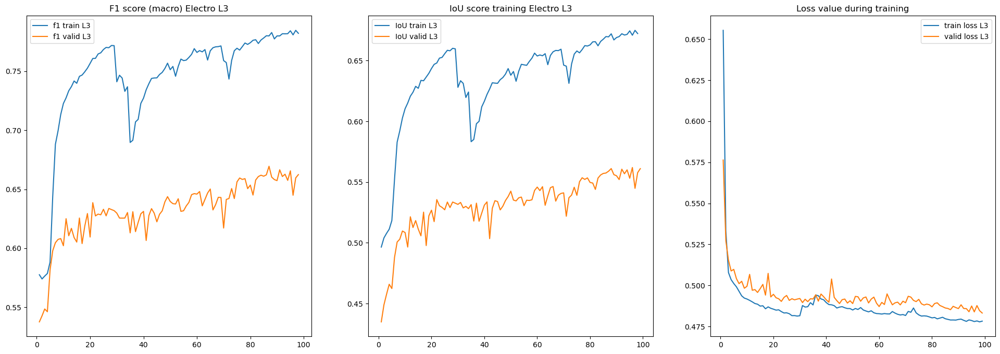

In [74]:
fig, ax = plt.subplots(1,3, figsize=(24,8))
ax[0].plot(np.arange(1,len(tr_f1_)),(tr_f1_[1:]),label='f1 train L3')
ax[1].plot(np.arange(1,len(tr_iou_)),(tr_iou_[1:]),label='IoU train L3')
ax[2].plot(np.arange(1,len(tr_loss_)+1),(tr_loss_),label='train loss L3')
ax[0].plot(np.arange(1,len(val_f1_)),(val_f1_[1:]),label='f1 valid L3')
ax[1].plot(np.arange(1,len(val_iou_)),(val_iou_[1:]),label='IoU valid L3')
ax[2].plot(np.arange(1,len(val_loss_)+1),(val_loss_),label='valid loss L3')
ax[0].set_title('F1 score (macro) Electro L3')
ax[1].set_title('IoU score training Electro L3')
ax[2].set_title('Loss value during training')
ax[0].legend()
ax[1].legend()
ax[2].legend()
plt.show()

**LETS BLEND SAVED MODELS via MODELS.SOUP**

In [290]:
# PREPARE A LIST OF SEVERAL MODELS WITH THE SAME ARCHITECTURE TO SOUP THEIR WEIGHTS
model_path1 = r'H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_216'
model_path2 = r'H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_215'
model_path3 = r'H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_198'
model_path4 = r'H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_175'
model_path5 = r'H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_171'
model_path_list = [model_path1,model_path3,model_path4]
for i, model_path in enumerate(model_path_list):
    print(model_path)

H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_216
H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_198
H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_ep_175


In [291]:
def uniform_soup(model, path, device = "cpu", by_name = False):
    try:
        import torch
    except:
        print("If you want to use 'Model Soup for Torch', please install 'torch'")
        return model
        
    if not isinstance(path, list):
        path = [path]
    model = model.to(device)
    model_dict = model.state_dict()
    soups = {key:[] for key in model_dict}
    for i, model_path in enumerate(path):
        weight = torch.load(model_path, map_location = device)
        weight_dict = weight.state_dict() if hasattr(weight, "state_dict") else weight
        if by_name:
            weight_dict = {k:v for k, v in weight_dict.items() if k in model_dict}
        for k, v in weight_dict.items():
            soups[k].append(v)
    if 0 < len(soups):
        soups = {k:(torch.sum(torch.stack(v), axis = 0) / len(v)).type(v[0].dtype) for k, v in soups.items() if len(v) != 0}
        model_dict.update(soups)
        model.load_state_dict(model_dict)
    return model
print("\n[Uniform Soup Performance]")
souped_model = uniform_soup(model, model_path_list, device = device)
# test_model(souped_model, valid_dl_)
test_model(souped_model, test_dl_)


[Uniform Soup Performance]
-----------Testing process---------


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [01:20<00:00,  1.24it/s]

Test F1 score: 0.8077, Test IoU: 0.7432
Test FAR: 0.1093
Test F1 score for each class(bg, snow, cloud): [0.8006987  0.74544346 0.8768815 ], 
Test IoU for each class(bg, snow, cloud): [0.6924185 0.7397989 0.7972732]


In [292]:
def save_souped_model(model,num_models=5, path =  r'H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b0_12_inputs_4km_res_souped'):
        model_copy = deepcopy(model)
        best_model = model_copy
        best_model_name = path+'_3_models'
        torch.save(best_model.state_dict(),best_model_name)
        print('souped model saved!')
        return best_model
save_souped_model(souped_model)

souped model saved!


MAnet(
  (encoder): EfficientNetEncoder(
    (_conv_stem): Conv2dStaticSamePadding(
      12, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
      (static_padding): ZeroPad2d((0, 1, 0, 1))
    )
    (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
    (_blocks): ModuleList(
      (0): MBConvBlock(
        (_depthwise_conv): Conv2dStaticSamePadding(
          32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
          (static_padding): ZeroPad2d((1, 1, 1, 1))
        )
        (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
        (_se_reduce): Conv2dStaticSamePadding(
          32, 8, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_se_expand): Conv2dStaticSamePadding(
          8, 32, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_project_conv): Conv2dStaticSamePaddi

In [ ]:
L4_lat = -165.8
GOES_17_lat = 137.2#137.0

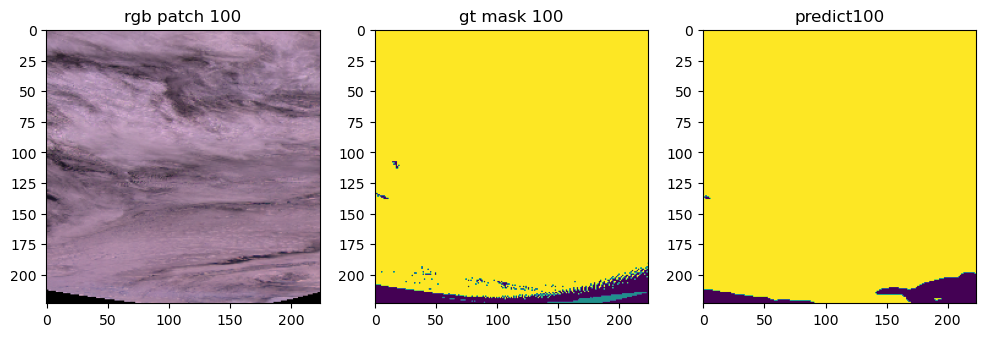

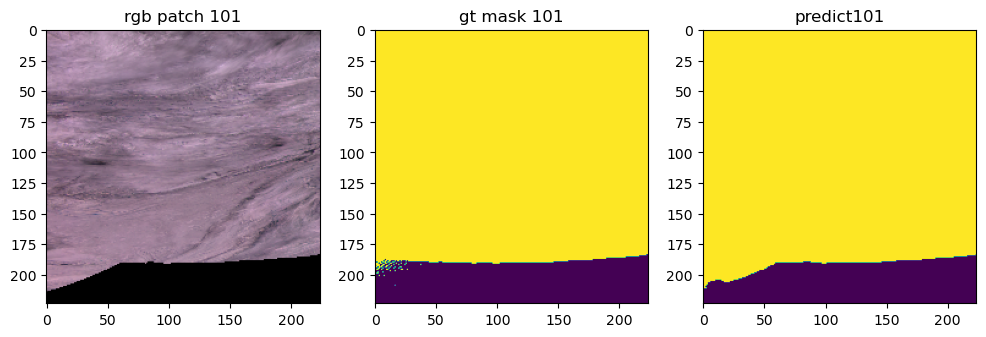

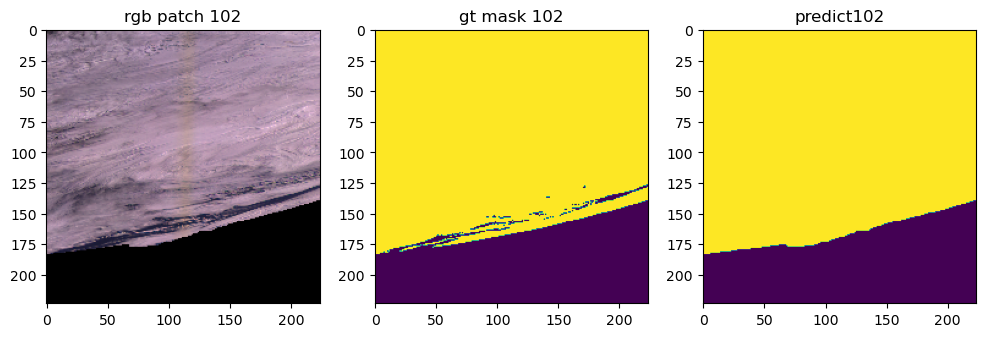

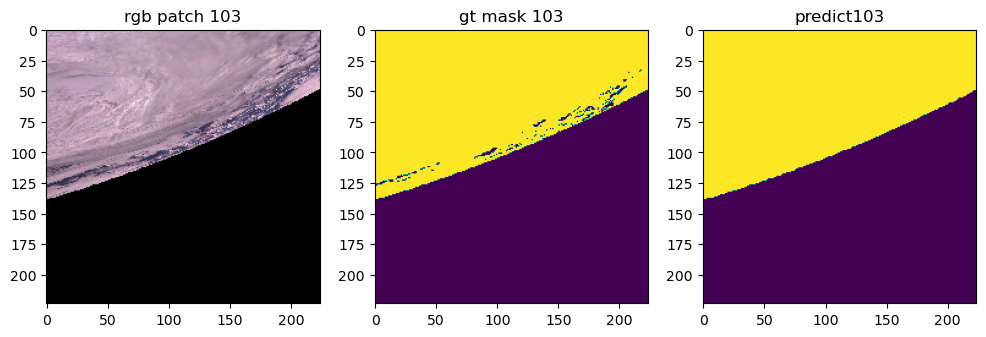

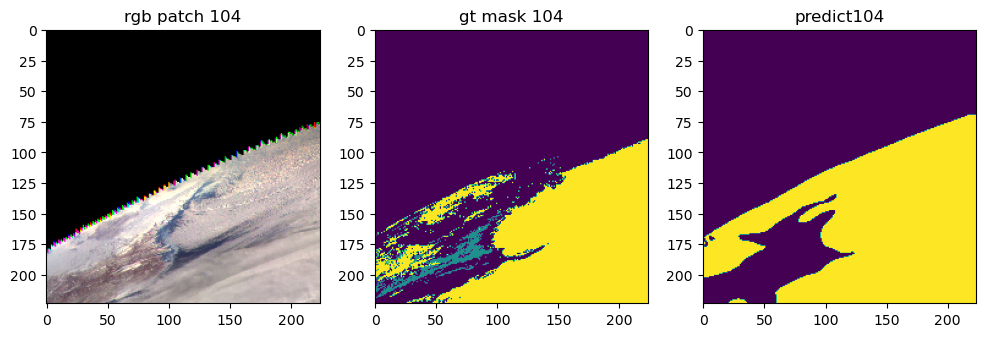

...

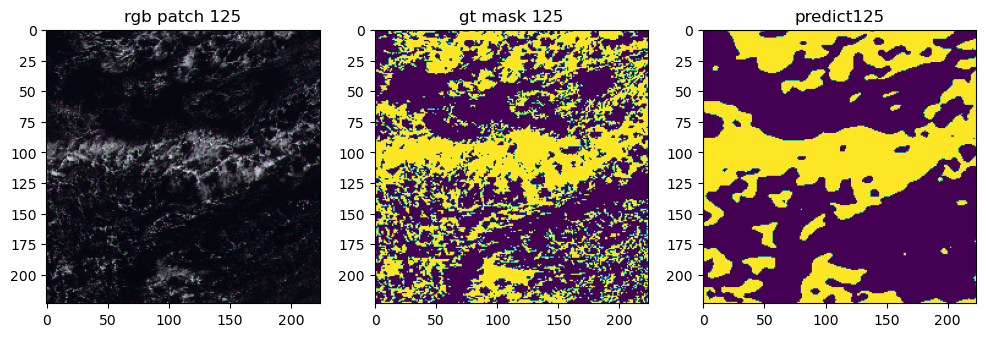

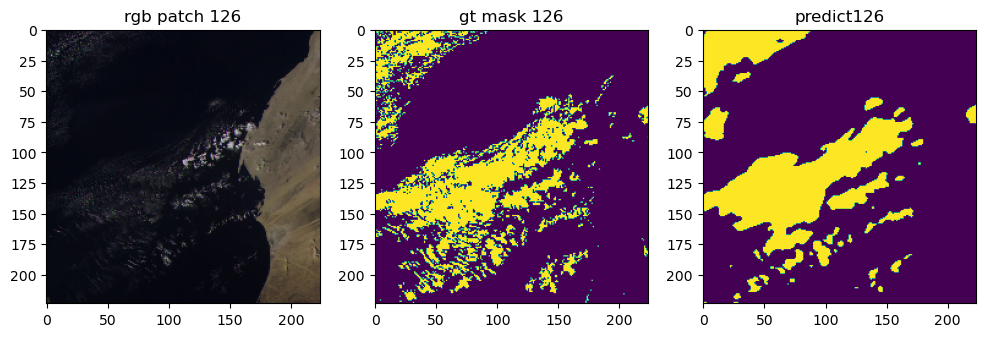

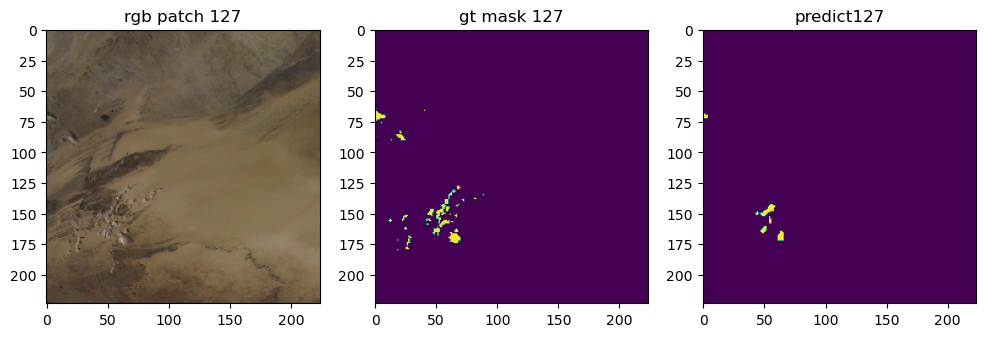

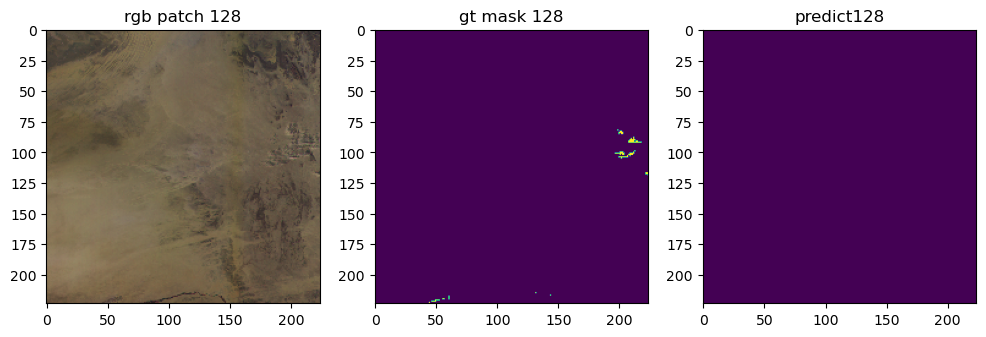

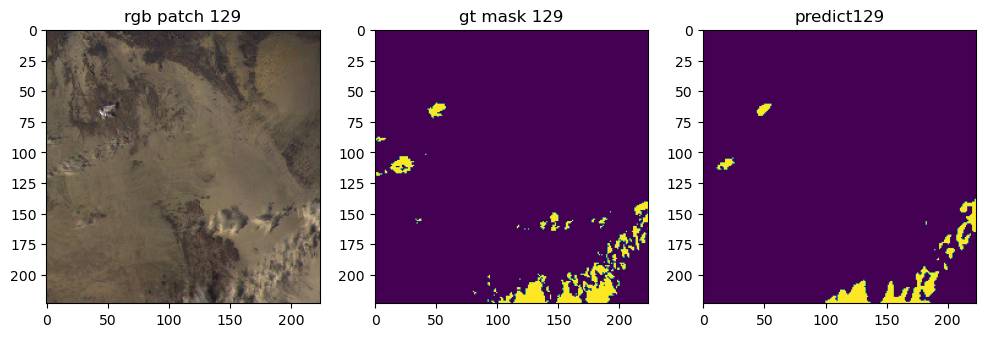

In [305]:
def visualize_pred(idx, model, dataset):
    x_rgb_lonlat,gt = dataset[idx]#.to(device)
    x_rgb_lonlat,gt = x_rgb_lonlat.to(device),gt.to(device)
    fig, ax = plt.subplots(1,3, figsize=(12,4))
    cloud_mask = model(x_rgb_lonlat.unsqueeze(0))#
    pred=predb_to_mask(cloud_mask).numpy()
    ax[0].imshow(open_sample_as_pil_no_norm(x_rgb_lonlat.cpu()))
    ax[1].imshow(open_mask_as_pil(gt.cpu()))
    ax[2].imshow(pred)
    ax[0].set_title('rgb patch '+str(idx))
    ax[1].set_title('gt mask '+str(idx))
    ax[2].set_title('predict'+str(idx))
    plt.show()
def visualize_pred_dl(model, dl, num_batches = 1):
#test_goes
    iterator = iter(dl)
    for j in range(num_batches):
        x,y = next(iterator)
        for i in range(len(x)):
            x_rgb_lonlat,gt = x[i], y[i]#.to(device)
            x_rgb_lonlat,gt = x_rgb_lonlat.to(device),gt.to(device)
            fig, ax = plt.subplots(1,3, figsize=(12,4))
            cloud_mask = model(x_rgb_lonlat.unsqueeze(0))#
            pred=predb_to_mask(cloud_mask).numpy()
            ax[0].imshow(open_sample_as_pil_no_norm(x_rgb_lonlat.cpu()))
            ax[1].imshow(open_mask_as_pil(gt.cpu()))
            ax[2].imshow(pred)
            ax[0].set_title('rgb patch '+str(i))
            ax[1].set_title('gt mask '+str(i))
            ax[2].set_title('predict'+str(i))
            plt.show()
# model_path = r'H:\ELECTRO_DATASET\4_km_res\L2/models/MAnet_Efficient_b1_12_inputs_4km_res_ep_73'
# model.load_state_dict(torch.load(model_path))
model.eval()
for idx in range(100,130,1):
    visualize_pred(idx, model = souped_model,dataset = Electro_ds_full_test)